In [1]:
import pandas as pd
import os
from sklearn.impute import KNNImputer
from scipy.stats import chi2_contingency
import numpy as np
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [2]:
def fill_missing_with_knn(df, n_neighbors=5):
    imputer = KNNImputer(n_neighbors=n_neighbors)
    imputed_data = imputer.fit_transform(df)
    return pd.DataFrame(imputed_data, columns=df.columns)

def check_missing_at_random(df):
    missing_matrix = df.isnull()
    columns = df.columns
    p_values = {}
    
    for col in columns:
        observed = pd.crosstab(missing_matrix[col], missing_matrix.drop(col, axis=1).any(axis=1))
        chi2, p, _, _ = chi2_contingency(observed)
        p_values[col] = p
    
    return p_values

In [3]:
# List of file names
file_names = [
    'all_indicators.csv',
    'country_groups_all.csv',
    'total_birth_rate.csv',
    'total_death_rate.csv',
    'total_fertility_rate.csv',
    'total_life_expectancy_at_birth.csv',
    'total_median_age.csv',
    'total_population.csv',
    'total_population_growth.csv'
]

# Directory where the files are stored
directory_path = 'data'

datasets = {}

# Iterating through the file list
for file_name in file_names:
    
    file_path = os.path.join(directory_path, file_name)
    
    data = pd.read_csv(file_path)
    
    datasets[file_name.split(".")[0]] = data
    
    print(f'---{file_name}---')
    print('Head:')
    display(data.head(20))
    print('\nInfo:')
    print(data.info())
    print('\nDescribe:')
    print(data.describe())
    print('\n' + '-'*50 + '\n')


---all_indicators.csv---
Head:


,economy,Pop-YR2002,Pop-YR2021,Pop%,Life-YR2002,Life-YR2021,Life%,Fer-YR2002,Fer-YR2021,Fer%,Death-YR2002,Death-YR2021,Death%,Birth-YR2002,Birth-YR2021,Birth%,Med_Age-YR2002,Med_Age-YR2021,Med%,Pop_Gro-YR2002,Pop_Gro-YR2021
0,ABW,91781,106537,0.160774,73.726000,74.626000,0.012207,1.763000,1.180000,-0.330686,6.420000,11.235000,0.750000,12.992000,7.193000,-0.446352,33.9,41.2,0.215339,1.194718,-0.045045
1,AFE,422741118,702977106,0.662902,52.540794,62.454590,0.188688,5.430475,4.354709,-0.198098,13.309589,8.036899,-0.396157,40.047325,33.546266,-0.162334,NaN,NaN,NaN,2.606598,2.607472
2,AFG,21000256,40099462,0.909475,56.454000,61.982000,0.097920,7.339000,4.643000,-0.367353,11.280000,7.344000,-0.348936,48.201000,35.842000,-0.256405,14.0,16.7,0.192857,6.449321,2.851358
3,AFW,284952322,478185907,0.678126,50.927848,56.988657,0.119008,5.967267,4.978662,-0.165671,15.006906,10.678952,-0.288397,42.927121,36.237034,-0.155848,NaN,NaN,NaN,2.811453,2.573377
4,AGO,17516139,34503774,0.969828,47.386000,61.643000,0.300869,6.567000,5.304000,-0.192325,17.275000,8.009000,-0.536382,47.448000,38.809000,-0.182073,15.7,16.2,0.031847,3.335132,3.166030
5,ALB,3051010,2811666,-0.078447,75.890000,76.463000,0.007550,2.036000,1.390000,-0.317289,5.953000,11.325000,0.902402,15.209000,10.240000,-0.326714,27.3,37.3,0.366300,-0.299877,-0.926918
6,AND,70849,79034,0.115527,0.000000,0.000000,NaN,0.000000,0.000000,NaN,0.000000,0.000000,NaN,11.200000,0.000000,-1.000000,36.8,42.5,0.154891,4.369372,1.702288
7,ARB,300018650,456520777,0.521641,67.935570,70.814483,0.042377,3.727369,3.142565,-0.156894,6.117311,5.750367,-0.059984,28.369124,23.774833,-0.161947,NaN,NaN,NaN,2.216707,1.623335
8,ARE,3633655,9365145,1.577335,74.901000,78.710000,0.050854,2.540000,1.460000,-0.425197,1.987000,1.874000,-0.056870,16.401000,10.307000,-0.371563,26.6,32.8,0.233083,5.064873,0.834813
9,ARG,37885028,45808747,0.209152,74.408000,75.390000,0.013198,2.493000,1.885000,-0.243883,7.518000,8.955000,0.191141,18.756000,13.902000,-0.258797,27.1,31.3,0.154982,1.073538,0.947491



Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 266 entries, 0 to 265
Data columns (total 21 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   economy         266 non-null    object 
 1   Pop-YR2002      266 non-null    int64  
 2   Pop-YR2021      266 non-null    int64  
 3   Pop%            265 non-null    float64
 4   Life-YR2002     266 non-null    float64
 5   Life-YR2021     266 non-null    float64
 6   Life%           258 non-null    float64
 7   Fer-YR2002      266 non-null    float64
 8   Fer-YR2021      266 non-null    float64
 9   Fer%            258 non-null    float64
 10  Death-YR2002    266 non-null    float64
 11  Death-YR2021    266 non-null    float64
 12  Death%          260 non-null    float64
 13  Birth-YR2002    266 non-null    float64
 14  Birth-YR2021    266 non-null    float64
 15  Birth%          261 non-null    float64
 16  Med_Age-YR2002  223 non-null    float64
 17  Med_Age-YR2021  223 non-null

,id,Country,Group,Group Type,iso2Code,capitalCity,longitude,latitude
0,AFG,Afghanistan,South Asia,Region,AF,Kabul,69.1761,34.5228
1,AFG,Afghanistan,Low & Middle Income,By Income,AF,Kabul,69.1761,34.5228
2,AFG,Afghanistan,Low Income,By Income,AF,Kabul,69.1761,34.5228
3,AFG,Afghanistan,Ida Only,By Lending,AF,Kabul,69.1761,34.5228
4,AFG,Afghanistan,Fragile And Conflict Affected Situations,Other Country Groups,AF,Kabul,69.1761,34.5228
5,AFG,Afghanistan,Heavily Indebted Poor Countries (Hipc),Other Country Groups,AF,Kabul,69.1761,34.5228
6,AFG,Afghanistan,Least Developed Countries: Un Classification,Other Country Groups,AF,Kabul,69.1761,34.5228
7,AFG,Afghanistan,World,Other Country Groups,AF,Kabul,69.1761,34.5228
8,AFG,Afghanistan,Pre-Demographic Dividend,Demographic Dividend Groups,AF,Kabul,69.1761,34.5228
9,AFG,Afghanistan,Ida & Ibrd Total,By Lending,AF,Kabul,69.1761,34.5228



Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2120 entries, 0 to 2119
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   id           2120 non-null   object 
 1   Country      2120 non-null   object 
 2   Group        2120 non-null   object 
 3   Group Type   2120 non-null   object 
 4   iso2Code     2106 non-null   object 
 5   capitalCity  2092 non-null   object 
 6   longitude    2096 non-null   float64
 7   latitude     2096 non-null   float64
dtypes: float64(2), object(6)
memory usage: 132.6+ KB
None

Describe:
         longitude     latitude
count  2096.000000  2096.000000
mean     21.133441    15.193184
std      67.181522    23.177860
min    -175.216000   -41.286500
25%      -9.135520     0.314269
50%      21.640700    13.514000
75%      45.716700    35.167600
max     179.089567    64.183600

--------------------------------------------------

---total_birth_rate.csv---
Head:


,economy,YR2000,YR2001,YR2002,YR2003,YR2004,YR2005,YR2006,YR2007,YR2008,YR2009,YR2010,YR2011,YR2012,YR2013,YR2014,YR2015,YR2016,YR2017,YR2018,YR2019,YR2020,YR2021
0,ABW,14.427000,13.739000,12.992000,12.621000,11.921000,12.348000,13.055000,12.962000,12.748000,12.350000,12.193000,12.246000,12.723000,13.316000,13.533000,12.428000,12.300000,11.530000,9.881000,9.138000,8.102000,7.193000
1,AFE,40.528237,40.341209,40.047325,39.750138,39.575894,39.407391,39.237105,39.000516,38.851692,38.364939,37.940260,37.483987,36.921300,36.447139,36.028318,35.613314,35.189016,34.892536,34.611022,34.341450,33.916746,33.546266
2,AFG,49.664000,48.979000,48.201000,47.350000,46.330000,45.263000,44.721000,43.858000,41.506000,41.157000,40.602000,39.855000,40.009000,39.601000,39.105000,38.803000,37.936000,37.342000,36.927000,36.466000,36.051000,35.842000
3,AFW,43.199553,43.075501,42.927121,42.746882,42.502717,42.421542,42.193297,41.943010,41.754795,41.503758,41.219629,40.894235,40.416431,39.856506,39.335352,38.859210,38.393100,37.881661,37.447087,37.027834,36.615730,36.237034
4,AGO,47.647000,47.574000,47.448000,47.226000,47.099000,46.944000,46.643000,46.290000,45.889000,45.495000,44.970000,44.364000,43.860000,43.282000,42.676000,42.020000,41.377000,40.810000,40.236000,39.725000,39.271000,38.809000
5,ALB,17.076000,16.120000,15.209000,14.668000,13.978000,13.235000,12.539000,12.070000,11.868000,11.841000,11.920000,12.035000,12.227000,12.279000,12.150000,11.718000,11.289000,10.870000,10.517000,10.343000,10.285000,10.240000
6,AND,11.300000,11.800000,11.200000,10.300000,10.900000,10.700000,10.600000,10.100000,10.400000,9.900000,9.800000,0.000000,9.500000,0.000000,0.000000,0.000000,8.800000,0.000000,7.200000,7.000000,0.000000,0.000000
7,ARB,28.965076,28.701854,28.369124,28.202106,27.994116,27.859476,27.870987,27.989732,27.971228,27.925863,28.107537,28.113981,28.031560,27.873278,27.526112,27.058079,26.065677,25.582521,25.102987,24.598620,24.234483,23.774833
8,ARE,16.660000,16.525000,16.401000,16.430000,16.094000,15.206000,14.484000,14.240000,14.080000,13.900000,13.665000,13.292000,12.911000,12.438000,11.989000,11.478000,10.993000,10.620000,10.049000,9.750000,10.620000,10.307000
9,ARG,19.366000,18.983000,18.756000,18.453000,18.352000,18.353000,18.194000,18.005000,17.812000,17.849000,17.870000,17.806000,17.729000,17.632000,17.504000,17.346000,16.824000,16.206000,15.187000,14.783000,14.125000,13.902000



Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 266 entries, 0 to 265
Data columns (total 23 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   economy  266 non-null    object 
 1   YR2000   266 non-null    float64
 2   YR2001   266 non-null    float64
 3   YR2002   266 non-null    float64
 4   YR2003   266 non-null    float64
 5   YR2004   266 non-null    float64
 6   YR2005   266 non-null    float64
 7   YR2006   266 non-null    float64
 8   YR2007   266 non-null    float64
 9   YR2008   266 non-null    float64
 10  YR2009   266 non-null    float64
 11  YR2010   266 non-null    float64
 12  YR2011   266 non-null    float64
 13  YR2012   266 non-null    float64
 14  YR2013   266 non-null    float64
 15  YR2014   266 non-null    float64
 16  YR2015   266 non-null    float64
 17  YR2016   266 non-null    float64
 18  YR2017   266 non-null    float64
 19  YR2018   266 non-null    float64
 20  YR2019   266 non-null    float64
 21  YR2020   

,economy,YR2000,YR2001,YR2002,YR2003,YR2004,YR2005,YR2006,YR2007,YR2008,YR2009,YR2010,YR2011,YR2012,YR2013,YR2014,YR2015,YR2016,YR2017,YR2018,YR2019,YR2020,YR2021
0,ABW,6.335000,6.348000,6.420000,6.549000,6.808000,6.839000,6.887000,6.958000,7.179000,7.094000,6.745000,6.945000,7.187000,7.403000,7.729000,7.968000,8.336000,8.414000,8.597000,8.778000,9.690000,11.235000
1,AFE,13.775698,13.592398,13.309589,12.981271,12.628441,12.233489,11.731215,11.288067,10.863130,10.361905,9.939449,9.499323,9.101050,8.775595,8.475899,8.239619,7.973696,7.773413,7.588110,7.434644,7.620548,8.036899
2,AFG,12.096000,11.713000,11.280000,10.698000,10.277000,9.941000,9.679000,9.359000,8.832000,8.535000,8.254000,7.931000,7.711000,7.478000,7.395000,7.331000,7.077000,7.027000,6.981000,6.791000,7.113000,7.344000
3,AFW,15.562004,15.287160,15.006906,14.659477,14.348104,13.983941,13.647235,13.353171,13.087263,12.751068,12.492765,12.193934,11.964805,11.730451,11.544798,11.352476,11.113635,10.909012,10.711840,10.488748,10.601297,10.678952
4,AGO,18.287000,17.789000,17.275000,15.804000,15.151000,14.497000,13.943000,13.133000,12.478000,11.788000,11.177000,10.630000,10.031000,9.607000,9.181000,8.826000,8.555000,8.242000,7.990000,7.811000,7.821000,8.009000
5,ALB,5.798000,5.872000,5.953000,6.057000,6.181000,6.306000,6.477000,6.318000,6.570000,6.810000,7.029000,7.238000,7.573000,7.819000,7.868000,7.947000,8.035000,8.150000,8.308000,8.480000,10.785000,11.325000
6,AND,0.000000,0.000000,0.000000,0.000000,3.800000,3.600000,3.300000,2.800000,2.800000,3.200000,2.800000,0.000000,3.900000,0.000000,0.000000,0.000000,4.300000,0.000000,4.400000,3.900000,0.000000,0.000000
7,ARB,6.325064,6.212475,6.117311,6.188105,6.214410,6.140859,5.994368,5.881349,5.762980,5.584754,5.549977,5.501637,5.559298,5.602630,5.519415,5.451670,5.408650,5.253352,5.226992,5.198866,5.616108,5.750367
8,ARE,2.107000,2.047000,1.987000,1.661000,1.613000,1.563000,1.449000,1.229000,1.011000,0.867000,0.795000,0.820000,0.850000,0.896000,0.948000,1.014000,1.102000,1.202000,1.324000,1.471000,1.766000,1.874000
9,ARG,7.600000,7.549000,7.518000,7.864000,7.480000,7.423000,7.369000,7.748000,7.467000,7.410000,7.661000,7.510000,7.394000,7.494000,7.447000,7.543000,7.947000,7.692000,7.680000,7.600000,8.509000,8.955000



Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 266 entries, 0 to 265
Data columns (total 23 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   economy  266 non-null    object 
 1   YR2000   266 non-null    float64
 2   YR2001   266 non-null    float64
 3   YR2002   266 non-null    float64
 4   YR2003   266 non-null    float64
 5   YR2004   266 non-null    float64
 6   YR2005   266 non-null    float64
 7   YR2006   266 non-null    float64
 8   YR2007   266 non-null    float64
 9   YR2008   266 non-null    float64
 10  YR2009   266 non-null    float64
 11  YR2010   266 non-null    float64
 12  YR2011   266 non-null    float64
 13  YR2012   266 non-null    float64
 14  YR2013   266 non-null    float64
 15  YR2014   266 non-null    float64
 16  YR2015   266 non-null    float64
 17  YR2016   266 non-null    float64
 18  YR2017   266 non-null    float64
 19  YR2018   266 non-null    float64
 20  YR2019   266 non-null    float64
 21  YR2020   

,economy,YR2000,YR2001,YR2002,YR2003,YR2004,YR2005,YR2006,YR2007,YR2008,YR2009,YR2010,YR2011,YR2012,YR2013,YR2014,YR2015,YR2016,YR2017,YR2018,YR2019,YR2020,YR2021
0,ABW,1.904000,1.833000,1.763000,1.747000,1.683000,1.777000,1.909000,1.928000,1.935000,1.919000,1.941000,1.962000,2.028000,2.117000,2.148000,1.972000,1.953000,1.839000,1.587000,1.486000,1.325000,1.180000
1,AFE,5.523553,5.481624,5.430475,5.380846,5.343159,5.307120,5.267691,5.224575,5.192592,5.115156,5.040797,4.962611,4.879018,4.808820,4.739861,4.677618,4.615670,4.570409,4.527705,4.482898,4.416900,4.354709
2,AFG,7.534000,7.446000,7.339000,7.220000,7.069000,6.905000,6.722000,6.530000,6.376000,6.235000,6.099000,5.958000,5.830000,5.696000,5.560000,5.405000,5.262000,5.129000,5.002000,4.870000,4.750000,4.643000
3,AFW,6.023179,5.995955,5.967267,5.931999,5.887567,5.864604,5.845380,5.815814,5.788525,5.749043,5.699552,5.645672,5.580892,5.506350,5.437493,5.385059,5.328709,5.255345,5.186319,5.118932,5.049329,4.978662
4,AGO,6.639000,6.601000,6.567000,6.533000,6.499000,6.461000,6.419000,6.372000,6.320000,6.260000,6.194000,6.120000,6.039000,5.953000,5.864000,5.774000,5.686000,5.600000,5.519000,5.442000,5.371000,5.304000
5,ALB,2.231000,2.150000,2.036000,1.978000,1.890000,1.803000,1.724000,1.671000,1.648000,1.647000,1.656000,1.671000,1.692000,1.697000,1.674000,1.613000,1.551000,1.491000,1.440000,1.414000,1.400000,1.390000
6,AND,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.240000,1.180000,1.250000,1.190000,1.270000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,ARB,3.878589,3.807783,3.727369,3.670690,3.616684,3.576596,3.547509,3.532149,3.508533,3.492780,3.504198,3.508021,3.512815,3.513518,3.500174,3.471038,3.371358,3.325882,3.279994,3.224519,3.186003,3.142565
8,ARE,2.733000,2.621000,2.540000,2.491000,2.384000,2.204000,2.072000,1.990000,1.917000,1.852000,1.790000,1.724000,1.666000,1.602000,1.545000,1.486000,1.438000,1.419000,1.356000,1.334000,1.460000,1.460000
9,ARG,2.591000,2.531000,2.493000,2.451000,2.430000,2.426000,2.400000,2.370000,2.341000,2.344000,2.346000,2.338000,2.330000,2.322000,2.312000,2.301000,2.241000,2.168000,2.039000,1.994000,1.911000,1.885000



Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 266 entries, 0 to 265
Data columns (total 23 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   economy  266 non-null    object 
 1   YR2000   266 non-null    float64
 2   YR2001   266 non-null    float64
 3   YR2002   266 non-null    float64
 4   YR2003   266 non-null    float64
 5   YR2004   266 non-null    float64
 6   YR2005   266 non-null    float64
 7   YR2006   266 non-null    float64
 8   YR2007   266 non-null    float64
 9   YR2008   266 non-null    float64
 10  YR2009   266 non-null    float64
 11  YR2010   266 non-null    float64
 12  YR2011   266 non-null    float64
 13  YR2012   266 non-null    float64
 14  YR2013   266 non-null    float64
 15  YR2014   266 non-null    float64
 16  YR2015   266 non-null    float64
 17  YR2016   266 non-null    float64
 18  YR2017   266 non-null    float64
 19  YR2018   266 non-null    float64
 20  YR2019   266 non-null    float64
 21  YR2020   

,economy,YR2000,YR2001,YR2002,YR2003,YR2004,YR2005,YR2006,YR2007,YR2008,YR2009,YR2010,YR2011,YR2012,YR2013,YR2014,YR2015,YR2016,YR2017,YR2018,YR2019,YR2020,YR2021
0,ABW,73.569000,73.647000,73.726000,73.752000,73.576000,73.811000,74.026000,74.210000,74.147000,74.560000,75.404000,75.465000,75.531000,75.636000,75.601000,75.683000,75.617000,75.903000,76.072000,76.248000,75.723000,74.626000
1,AFE,51.964481,52.189648,52.540794,53.022035,53.545457,54.219651,55.150546,55.933802,56.680419,57.620852,58.411150,59.293271,60.050780,60.709870,61.337917,61.856458,62.444050,62.922390,63.365863,63.755678,63.313860,62.454590
2,AFG,55.298000,55.798000,56.454000,57.344000,57.944000,58.361000,58.684000,59.111000,59.852000,60.364000,60.851000,61.419000,61.923000,62.417000,62.545000,62.659000,63.136000,63.016000,63.081000,63.565000,62.575000,61.982000
3,AFW,50.221954,50.565144,50.927848,51.403356,51.819132,52.344551,52.832126,53.251712,53.641165,54.159421,54.550169,55.013138,55.340561,55.673406,55.922229,56.195872,56.581678,56.888446,57.189139,57.555796,57.226373,56.988657
4,AGO,46.024000,46.590000,47.386000,49.617000,50.592000,51.570000,52.369000,53.642000,54.633000,55.752000,56.726000,57.596000,58.623000,59.307000,60.040000,60.655000,61.092000,61.680000,62.144000,62.448000,62.261000,61.643000
5,ALB,75.404000,75.639000,75.890000,76.142000,76.376000,76.621000,76.816000,77.549000,77.653000,77.781000,77.936000,78.092000,78.064000,78.123000,78.407000,78.644000,78.860000,79.047000,79.184000,79.282000,76.989000,76.463000
6,AND,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,ARB,67.297331,67.631681,67.935570,67.859003,67.895912,68.162682,68.567250,68.928680,69.286427,69.812638,70.041254,70.261520,70.180461,70.196514,70.492629,70.758222,70.943062,71.429596,71.633017,71.844626,70.923360,70.814483
8,ARE,74.380000,74.636000,74.901000,76.222000,76.453000,76.683000,76.909000,77.129000,77.488000,78.003000,78.334000,78.517000,78.716000,78.853000,79.044000,79.223000,79.335000,79.504000,79.627000,79.726000,78.946000,78.710000
9,ARG,73.926000,74.186000,74.408000,74.080000,74.855000,75.139000,75.433000,75.006000,75.641000,75.936000,75.721000,76.124000,76.467000,76.491000,76.755000,76.760000,76.308000,76.833000,76.999000,77.284000,75.892000,75.390000



Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 266 entries, 0 to 265
Data columns (total 23 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   economy  266 non-null    object 
 1   YR2000   266 non-null    float64
 2   YR2001   266 non-null    float64
 3   YR2002   266 non-null    float64
 4   YR2003   266 non-null    float64
 5   YR2004   266 non-null    float64
 6   YR2005   266 non-null    float64
 7   YR2006   266 non-null    float64
 8   YR2007   266 non-null    float64
 9   YR2008   266 non-null    float64
 10  YR2009   266 non-null    float64
 11  YR2010   266 non-null    float64
 12  YR2011   266 non-null    float64
 13  YR2012   266 non-null    float64
 14  YR2013   266 non-null    float64
 15  YR2014   266 non-null    float64
 16  YR2015   266 non-null    float64
 17  YR2016   266 non-null    float64
 18  YR2017   266 non-null    float64
 19  YR2018   266 non-null    float64
 20  YR2019   266 non-null    float64
 21  YR2020   

,economy,YR2000,YR2001,YR2002,YR2003,YR2004,YR2005,YR2006,YR2007,YR2008,YR2009,YR2010,YR2011,YR2012,YR2013,YR2014,YR2015,YR2016,YR2017,YR2018,YR2019,YR2020,YR2021
0,AFG,14.1,14.1,14.0,14.0,14.0,14.2,14.3,14.1,14.0,14.3,14.4,14.7,15.0,15.2,15.5,15.7,15.8,16.0,16.1,16.3,16.6,16.7
1,ALB,26.3,26.8,27.3,27.9,28.4,29.1,29.7,30.4,31.0,31.6,32.3,32.8,33.3,33.8,34.3,34.7,35.1,35.6,36.0,36.5,36.9,37.3
2,DZA,20.7,21.2,21.7,22.2,22.6,23.1,23.5,23.9,24.3,24.7,25.1,25.4,25.7,26.0,26.3,26.5,26.8,27.0,27.2,27.4,27.6,27.8
3,ASM,19.6,19.9,20.1,20.4,20.7,21.0,21.2,21.4,21.4,21.4,21.5,21.8,22.1,22.5,23.0,23.6,24.1,24.7,25.4,26.1,26.9,27.6
4,AND,36.6,36.9,36.8,36.8,36.8,36.8,36.9,37.0,37.1,37.1,37.1,37.4,37.9,38.5,39.1,39.8,40.3,40.8,41.3,41.7,42.1,42.5
5,AGO,15.6,15.6,15.7,15.8,15.8,15.9,15.9,15.9,15.9,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.1,16.1,16.1,16.2
6,ATG,27.3,27.6,27.9,28.2,28.5,28.8,29.2,29.5,29.7,30.0,30.2,30.5,30.9,31.3,31.7,32.1,32.5,32.9,33.4,33.8,34.3,34.7
7,ARG,26.8,26.9,27.1,27.3,27.5,27.7,28.0,28.2,28.4,28.7,28.9,29.1,29.3,29.5,29.7,29.9,30.1,30.3,30.5,30.8,31.0,31.3
8,ARM,28.7,29.1,29.4,29.6,29.9,30.1,30.3,30.6,30.8,31.0,31.2,31.4,31.6,31.8,32.0,32.3,32.5,32.9,33.3,33.7,34.1,34.4
9,ABW,33.0,33.4,33.9,34.4,34.9,35.4,35.8,36.2,36.5,36.9,37.2,37.6,38.0,38.4,38.7,39.1,39.5,39.8,40.2,40.5,40.9,41.2



Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 224 entries, 0 to 223
Data columns (total 23 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   economy  224 non-null    object 
 1   YR2000   223 non-null    float64
 2   YR2001   223 non-null    float64
 3   YR2002   223 non-null    float64
 4   YR2003   223 non-null    float64
 5   YR2004   223 non-null    float64
 6   YR2005   223 non-null    float64
 7   YR2006   223 non-null    float64
 8   YR2007   223 non-null    float64
 9   YR2008   223 non-null    float64
 10  YR2009   223 non-null    float64
 11  YR2010   223 non-null    float64
 12  YR2011   223 non-null    float64
 13  YR2012   223 non-null    float64
 14  YR2013   223 non-null    float64
 15  YR2014   223 non-null    float64
 16  YR2015   224 non-null    float64
 17  YR2016   223 non-null    float64
 18  YR2017   223 non-null    float64
 19  YR2018   223 non-null    float64
 20  YR2019   223 non-null    float64
 21  YR2020   

,economy,YR2000,YR2001,YR2002,YR2003,YR2004,YR2005,YR2006,YR2007,YR2008,YR2009,YR2010,YR2011,YR2012,YR2013,YR2014,YR2015,YR2016,YR2017,YR2018,YR2019,YR2020,YR2021
0,ABW,89101,90691,91781,92701,93540,94483,95606,96787,97996,99212,100341,101288,102112,102880,103594,104257,104874,105439,105962,106442,106585,106537
1,AFE,401600588,412001885,422741118,433807484,445281555,457153837,469508516,482406426,495748900,509410477,523459657,537792950,552530654,567892149,583651101,600008424,616377605,632746570,649757148,667242986,685112979,702977106
2,AFG,19542982,19688632,21000256,22645130,23553551,24411191,25442944,25903301,26427199,27385307,28189672,29249157,30466479,31541209,32716210,33753499,34636207,35643418,36686784,37769499,38972230,40099462
3,AFW,269611898,277160097,284952322,292977949,301265247,309824829,318601484,327612838,336893835,346475221,356337762,366489204,376797999,387204553,397855507,408690375,419778384,431138704,442646825,454306063,466189102,478185907
4,AGO,16394062,16941587,17516139,18124342,18771125,19450959,20162340,20909684,21691522,22507674,23364185,24259111,25188292,26147002,27128337,28127721,29154746,30208628,31273533,32353588,33428486,34503774
5,ALB,3089027,3060173,3051010,3039616,3026939,3011487,2992547,2970017,2947314,2927519,2913021,2905195,2900401,2895092,2889104,2880703,2876101,2873457,2866376,2854191,2837849,2811666
6,AND,66097,67820,70849,73907,76933,79826,80221,78168,76055,73852,71519,70567,71013,71367,71621,71746,72540,73837,75013,76343,77700,79034
7,ARB,287065982,293512340,300018650,306573087,313249616,320558754,328703057,337498222,346630443,355754908,364427661,372351065,380383408,389131555,397922915,406501999,415077960,423664839,432545676,441467739,449228296,456520777
8,ARE,3275333,3454198,3633655,3813443,3993339,4280993,4898954,5872624,6988685,7992644,8481771,8575205,8664969,8751847,8835951,8916899,8994263,9068296,9140169,9211657,9287289,9365145
9,ARG,37070774,37480493,37885028,38278164,38668796,39070501,39476851,39876111,40273769,40684338,40788453,41261490,41733271,42202935,42669500,43131966,43590368,44044811,44494502,44938712,45376763,45808747



Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 266 entries, 0 to 265
Data columns (total 23 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   economy  266 non-null    object
 1   YR2000   266 non-null    int64 
 2   YR2001   266 non-null    int64 
 3   YR2002   266 non-null    int64 
 4   YR2003   266 non-null    int64 
 5   YR2004   266 non-null    int64 
 6   YR2005   266 non-null    int64 
 7   YR2006   266 non-null    int64 
 8   YR2007   266 non-null    int64 
 9   YR2008   266 non-null    int64 
 10  YR2009   266 non-null    int64 
 11  YR2010   266 non-null    int64 
 12  YR2011   266 non-null    int64 
 13  YR2012   266 non-null    int64 
 14  YR2013   266 non-null    int64 
 15  YR2014   266 non-null    int64 
 16  YR2015   266 non-null    int64 
 17  YR2016   266 non-null    int64 
 18  YR2017   266 non-null    int64 
 19  YR2018   266 non-null    int64 
 20  YR2019   266 non-null    int64 
 21  YR2020   266 non-null    int64 


,economy,YR2000,YR2001,YR2002,YR2003,YR2004,YR2005,YR2006,YR2007,YR2008,YR2009,YR2010,YR2011,YR2012,YR2013,YR2014,YR2015,YR2016,YR2017,YR2018,YR2019,YR2020,YR2021
0,ABW,2.539234,1.768757,1.194718,0.997396,0.900989,1.003077,1.181566,1.227711,1.241397,1.233231,1.131541,0.939356,0.810231,0.749301,0.691615,0.637959,0.590062,0.537296,0.494795,0.451970,0.134255,-0.045045
1,AFE,2.583579,2.589961,2.606598,2.617764,2.644968,2.666242,2.702521,2.747109,2.765816,2.755745,2.757929,2.738185,2.740405,2.780207,2.774990,2.802586,2.728159,2.655672,2.688371,2.691134,2.678184,2.607472
2,AFG,1.443803,0.742517,6.449321,7.541019,3.933178,3.576508,4.139678,1.793196,2.002333,3.561288,2.894904,3.689508,4.077628,3.466788,3.657576,3.121341,2.581549,2.866492,2.885208,2.908529,3.134747,2.851358
3,AFW,2.749600,2.799654,2.811453,2.816481,2.828642,2.841211,2.832780,2.828409,2.832916,2.844037,2.846536,2.848826,2.812851,2.761839,2.750731,2.723317,2.713059,2.706266,2.669239,2.633982,2.615646,2.573377
4,AGO,3.244121,3.285217,3.335132,3.413321,3.506389,3.557659,3.592013,3.639589,3.670909,3.693482,3.734798,3.758796,3.758703,3.735525,3.684429,3.617678,3.586211,3.550987,3.464457,3.395278,3.268348,3.166030
5,ALB,-0.637357,-0.938470,-0.299877,-0.374149,-0.417931,-0.511790,-0.630911,-0.755719,-0.767343,-0.673894,-0.496462,-0.269017,-0.165151,-0.183211,-0.207047,-0.291206,-0.159880,-0.091972,-0.246732,-0.426007,-0.574207,-0.926918
6,AND,0.670960,2.573378,4.369372,4.225669,4.012737,3.691435,0.493606,-2.592497,-2.740359,-2.939367,-3.209994,-1.340054,0.630035,0.497262,0.355275,0.174378,1.100603,1.772183,1.580147,1.757491,1.761891,1.702288
7,ARB,2.285934,2.245602,2.216707,2.184677,2.177794,2.333327,2.540658,2.675717,2.705858,2.632332,2.437845,2.174205,2.157196,2.299823,2.259226,2.155966,2.109697,2.068739,2.096194,2.062687,1.757899,1.623335
8,ARE,5.580387,5.317076,5.064873,4.829343,4.609527,6.955727,13.483672,18.127984,17.399086,13.422921,5.939765,1.095563,1.041345,0.997642,0.956398,0.911950,0.863869,0.819744,0.789450,0.779087,0.817694,0.834813
9,ARG,1.133277,1.099171,1.073538,1.032361,1.015337,1.033476,1.034672,1.006297,0.992294,1.014284,0.255582,1.153059,1.136906,1.119109,1.099461,1.078001,1.057182,1.037134,1.015808,0.993397,0.970054,0.947491



Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 266 entries, 0 to 265
Data columns (total 23 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   economy  266 non-null    object 
 1   YR2000   266 non-null    float64
 2   YR2001   266 non-null    float64
 3   YR2002   266 non-null    float64
 4   YR2003   266 non-null    float64
 5   YR2004   266 non-null    float64
 6   YR2005   266 non-null    float64
 7   YR2006   266 non-null    float64
 8   YR2007   266 non-null    float64
 9   YR2008   266 non-null    float64
 10  YR2009   266 non-null    float64
 11  YR2010   266 non-null    float64
 12  YR2011   266 non-null    float64
 13  YR2012   266 non-null    float64
 14  YR2013   266 non-null    float64
 15  YR2014   266 non-null    float64
 16  YR2015   266 non-null    float64
 17  YR2016   266 non-null    float64
 18  YR2017   266 non-null    float64
 19  YR2018   266 non-null    float64
 20  YR2019   266 non-null    float64
 21  YR2020   

# all_values.csv

Mean/Median/Mode Imputation: This is the simplest form where missing values are filled with the mean, median, or mode of the column. It's best when the data is not highly skewed and when the percentage of missing data is low.

K-Nearest Neighbors (KNN) Imputation: This method uses the K-Nearest Neighbors algorithm to impute missing values. It finds the 'k' samples closest in distance to the missing value and averages these to estimate the missing value. It's beneficial when the data has observable patterns or clusters.

Multiple Imputation by Chained Equations (MICE): MICE is a more sophisticated technique that performs multiple imputations using chained equations. It creates multiple imputations (complete copies of the dataset) and then averages the imputed values across these datasets.

Interpolation: This method can be especially useful for time-series data where the missing value can be estimated by interpolating between known values.

Regression Imputation: It involves using a regression model to predict missing values based on other available variables.

Random Forest Imputation: This method uses the Random Forest algorithm to predict missing values, particularly effective when the data is nonlinear and complex.

Deep Learning Approaches: Neural networks can also be used for imputation, particularly for large and complex datasets where patterns can be difficult to capture with simpler models.

Using Domain Knowledge: Sometimes missing values can be reasonably imputed based on domain knowledge.

For your dataset, since you have a mix of continuous and categorical data, KNNImputer could be a good option as it can effectively handle numerical data by considering the underlying patterns in the data. If the missing data is not extensive or is MCAR, simpler methods like mean/median imputation might suffice and will be less computationally intensive.

In [4]:


def fill_missing_with_knn(df, n_neighbors=5):
    imputer = KNNImputer(n_neighbors=n_neighbors)
    imputed_data = imputer.fit_transform(df)
    return pd.DataFrame(imputed_data, columns=df.columns)


In [5]:
check_missing_at_random(datasets["all_indicators"])

{'economy': 1.0,
 'Pop-YR2002': 1.0,
 'Pop-YR2021': 1.0,
 'Pop%': 0.42361035419801385,
 'Life-YR2002': 1.0,
 'Life-YR2021': 1.0,
 'Life%': 3.592689100768108e-08,
 'Fer-YR2002': 1.0,
 'Fer-YR2021': 1.0,
 'Fer%': 3.592689100768108e-08,
 'Death-YR2002': 1.0,
 'Death-YR2021': 1.0,
 'Death%': 3.8169134439448115e-06,
 'Birth-YR2002': 1.0,
 'Birth-YR2021': 1.0,
 'Birth%': 3.8871175302196195e-05,
 'Med_Age-YR2002': 9.688308761118377e-49,
 'Med_Age-YR2021': 9.688308761118377e-49,
 'Med%': 9.688308761118377e-49,
 'Pop_Gro-YR2002': 1.0,
 'Pop_Gro-YR2021': 1.0}

Columns with p-values significantly less than a typical significance level (e.g., 0.05), such as 'Life%', 'Fer%', 'Death%', 'Birth%', 'Med_Age-YR2002', 'Med_Age-YR2021', and 'Med%', show evidence that the missingness in these columns is related to the missingness in other columns. This suggests that missing data in these columns may not be missing at random.

In [6]:
datasets["all_indicators"].update(fill_missing_with_knn(datasets["all_indicators"].select_dtypes(include=[np.number])))
datasets["all_indicators"]["Pop_Gro%"] = (datasets["all_indicators"]["Pop_Gro-YR2002"] - datasets["all_indicators"]["Pop_Gro-YR2021"])/datasets["all_indicators"]["Pop_Gro-YR2002"]

In [7]:
datasets["all_indicators"].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 266 entries, 0 to 265
Data columns (total 22 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   economy         266 non-null    object 
 1   Pop-YR2002      266 non-null    int64  
 2   Pop-YR2021      266 non-null    int64  
 3   Pop%            266 non-null    float64
 4   Life-YR2002     266 non-null    float64
 5   Life-YR2021     266 non-null    float64
 6   Life%           266 non-null    float64
 7   Fer-YR2002      266 non-null    float64
 8   Fer-YR2021      266 non-null    float64
 9   Fer%            266 non-null    float64
 10  Death-YR2002    266 non-null    float64
 11  Death-YR2021    266 non-null    float64
 12  Death%          266 non-null    float64
 13  Birth-YR2002    266 non-null    float64
 14  Birth-YR2021    266 non-null    float64
 15  Birth%          266 non-null    float64
 16  Med_Age-YR2002  266 non-null    float64
 17  Med_Age-YR2021  266 non-null    flo

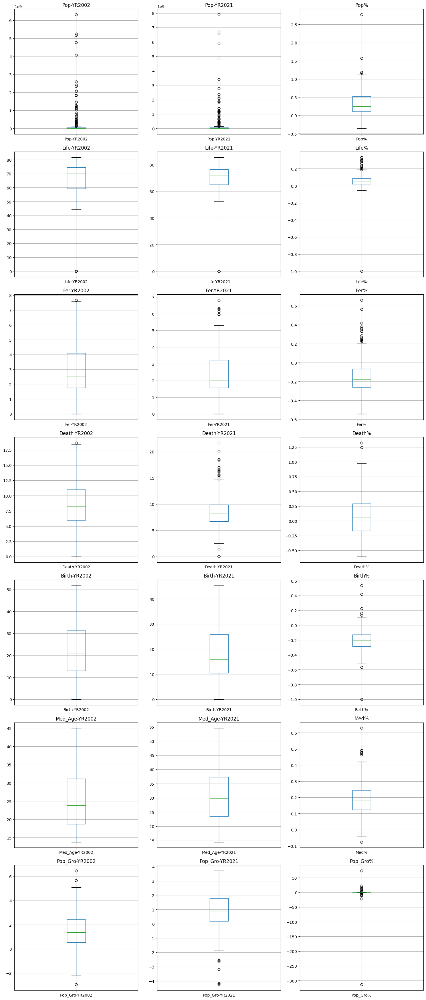

In [8]:
import matplotlib.pyplot as plt
import pandas as pd

def plot_boxplots(df, columns_per_row=3):
    numeric_cols = df.select_dtypes(include=[np.number]).columns
    num_cols = len(numeric_cols)
    num_rows = (num_cols + columns_per_row - 1) // columns_per_row

    fig, axs = plt.subplots(num_rows, columns_per_row, figsize=(columns_per_row * 5, num_rows * 5))
    axs = axs.flatten()

    for i, col in enumerate(numeric_cols):
        df.boxplot(column=col, ax=axs[i])
        axs[i].set_title(col)

    # Hide empty subplots
    for j in range(i + 1, len(axs)):
        fig.delaxes(axs[j])

    plt.tight_layout()
    plt.show()


plot_boxplots(datasets["all_indicators"])


In [9]:
datasets["all_indicators"][["Pop-YR2002", "economy"]].sort_values("Pop-YR2002", ascending=False).head(10)

,Pop-YR2002,economy
259,6308140970,WLD
103,5243283354,IBT
140,5167128185,LMY
156,4762356287,MIC
102,4073344085,IBD
62,2591204247,EAR
249,2416905279,UMC
139,2345451008,LMC
63,2083969920,EAS
142,2074581734,LTE


"IBT," "IBD," "LMY," "MIC," "LMC," "LTE," etc., are classifications used by organizations like the World Bank. They usually refer to different groups of countries based on income levels or other economic criteria. For example, "LMY" might stand for "Low and Middle-Income Countries," "MIC" for "Middle-Income Countries," and so forth.

In [10]:
datasets["all_indicators"][["Life%", "economy"]].sort_values("Life%", ascending=True).head(10)

,Life%,economy
51,-1.000000,CUW
154,-0.052533,MEX
50,-0.038232,CUB
253,-0.035182,VCT
254,-0.029011,VEN
182,-0.017978,OMN
27,-0.016755,BMU
228,-0.012616,TCA
48,-0.012310,CRI
225,-0.011836,SXM


A "Life%" of -1.000000 for "CUW" (likely Curaçao) means there has been a 100% decrease in the measured life-related metric, which could indicate a significant issue with the data, as a 100% decrease in life expectancy or similar metrics is not feasible.

In [11]:
datasets["all_indicators"].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 266 entries, 0 to 265
Data columns (total 22 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   economy         266 non-null    object 
 1   Pop-YR2002      266 non-null    int64  
 2   Pop-YR2021      266 non-null    int64  
 3   Pop%            266 non-null    float64
 4   Life-YR2002     266 non-null    float64
 5   Life-YR2021     266 non-null    float64
 6   Life%           266 non-null    float64
 7   Fer-YR2002      266 non-null    float64
 8   Fer-YR2021      266 non-null    float64
 9   Fer%            266 non-null    float64
 10  Death-YR2002    266 non-null    float64
 11  Death-YR2021    266 non-null    float64
 12  Death%          266 non-null    float64
 13  Birth-YR2002    266 non-null    float64
 14  Birth-YR2021    266 non-null    float64
 15  Birth%          266 non-null    float64
 16  Med_Age-YR2002  266 non-null    float64
 17  Med_Age-YR2021  266 non-null    flo

/tmp/ipykernel_23130/422330657.py:6: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


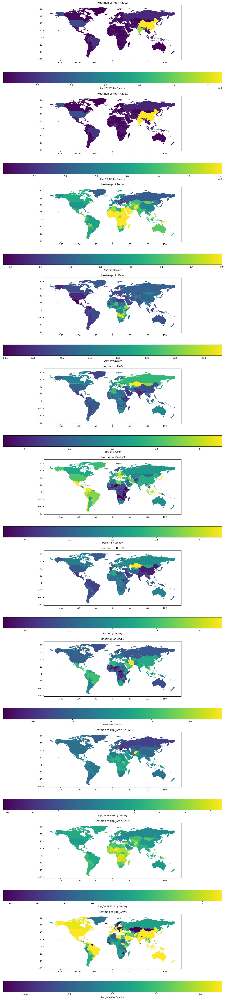

In [12]:
import geopandas as gpd
import matplotlib.pyplot as plt

def plot_world_heatmap(df):
    # Load a world map
    world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

    # Ensure the country code column in your DataFrame matches the world map's country code format
    # This might involve converting codes or merging dataframes

    # Merge your DataFrame with the world GeoDataFrame
    merged = world.merge(df, left_on='iso_a3', right_on='economy')

    # List of columns to plot
    percent_columns = [col for col in df.columns if '%' in col or "Pop" in col]

    # Plotting each column in a separate subplot
    fig, axs = plt.subplots(len(percent_columns), 1, figsize=(15, 6 * len(percent_columns)))

    for i, col in enumerate(percent_columns):
        # Clip the data to the range -0.5 to 0.5
        if '%' in col:
            merged[col] = merged[col].clip(-0.5, 0.5)

        merged.plot(column=col, ax=axs[i], legend=True,
                    legend_kwds={'label': f"{col} by Country",
                                 'orientation': "horizontal"})
        axs[i].set_title(f'Heatmap of {col}')

    plt.tight_layout()
    plt.show()

# Example usage:
plot_world_heatmap(datasets["all_indicators"].copy(deep=True))
# Replace 'your_dataframe' with the actual DataFrame variable name.


# country_groups_all.csv

In [13]:
import pandas as pd

def impute_missing_values(df):
    df['iso2Code'].fillna('Unknown', inplace=True)
    df['capitalCity'].fillna('Unknown', inplace=True)

    # Impute missing 'longitude' and 'latitude' with their median values
    median_longitude = df['longitude'].median()
    median_latitude = df['latitude'].median()
    df['longitude'].fillna(median_longitude, inplace=True)
    df['latitude'].fillna(median_latitude, inplace=True)

    return df

impute_missing_values(datasets['country_groups_all']).info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2120 entries, 0 to 2119
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   id           2120 non-null   object 
 1   Country      2120 non-null   object 
 2   Group        2120 non-null   object 
 3   Group Type   2120 non-null   object 
 4   iso2Code     2120 non-null   object 
 5   capitalCity  2120 non-null   object 
 6   longitude    2120 non-null   float64
 7   latitude     2120 non-null   float64
dtypes: float64(2), object(6)
memory usage: 132.6+ KB


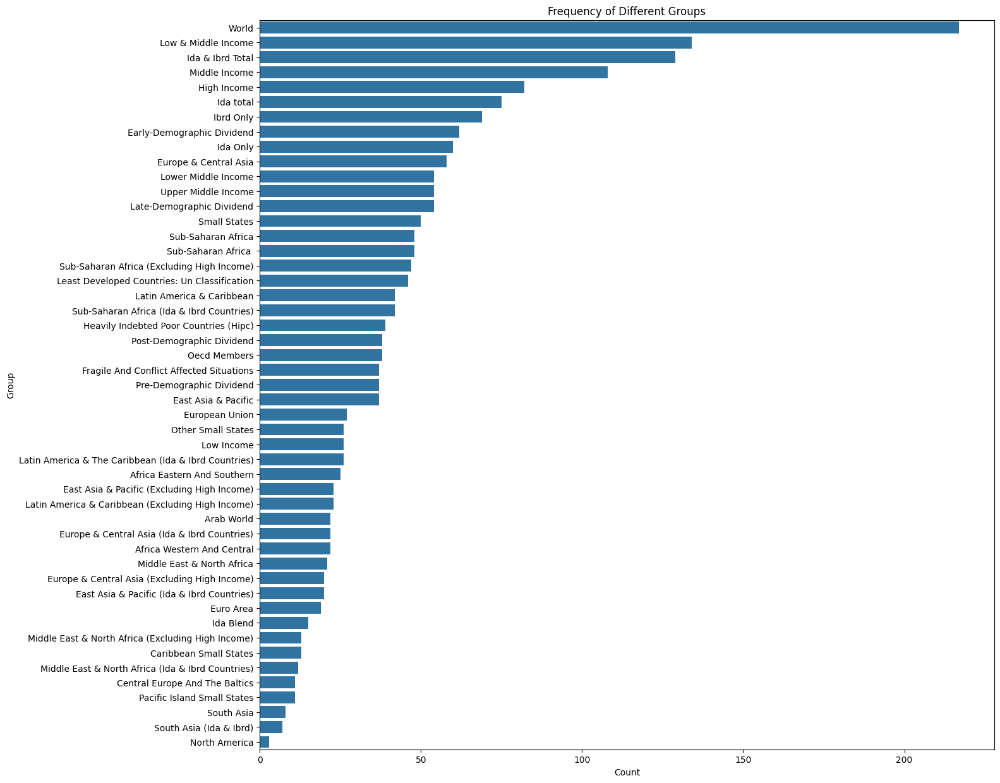

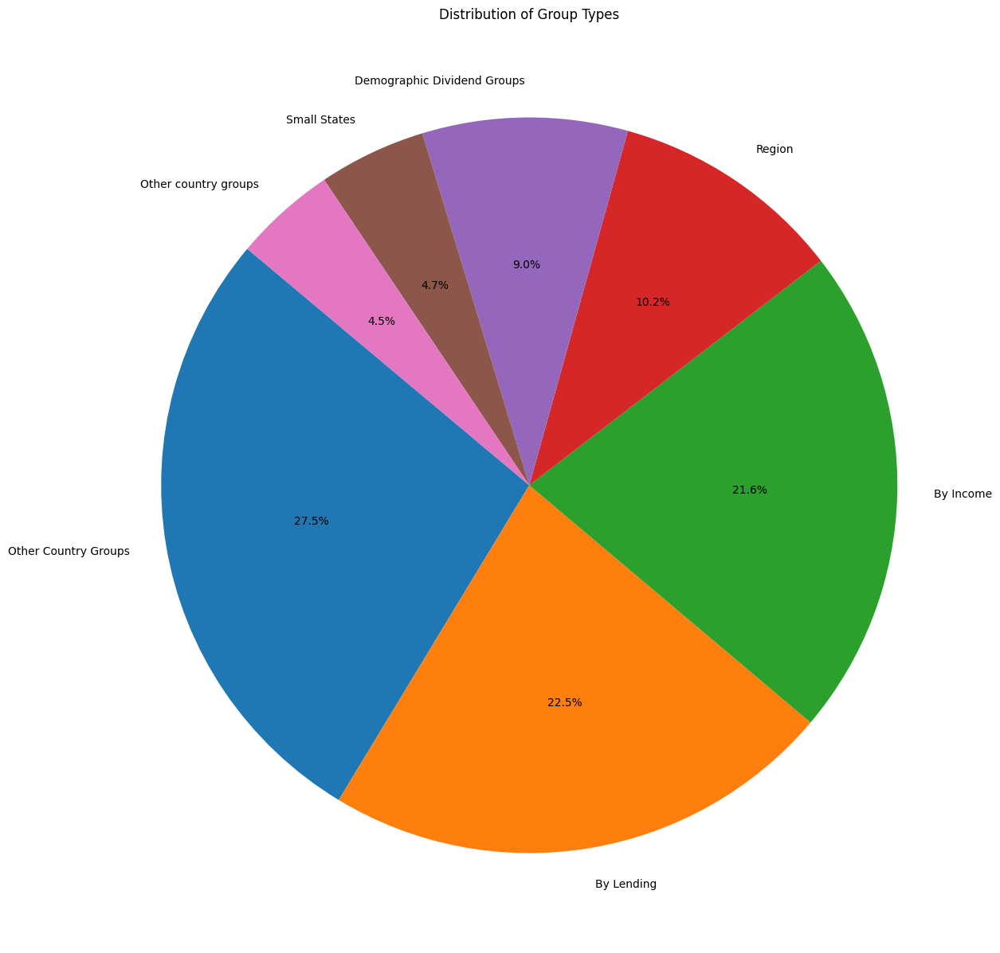

/tmp/ipykernel_23130/4100071416.py:28: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


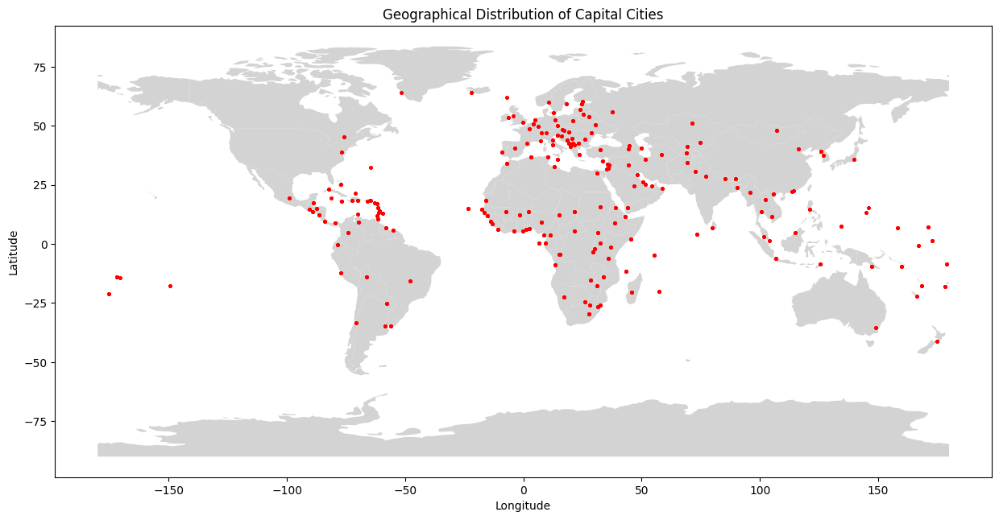

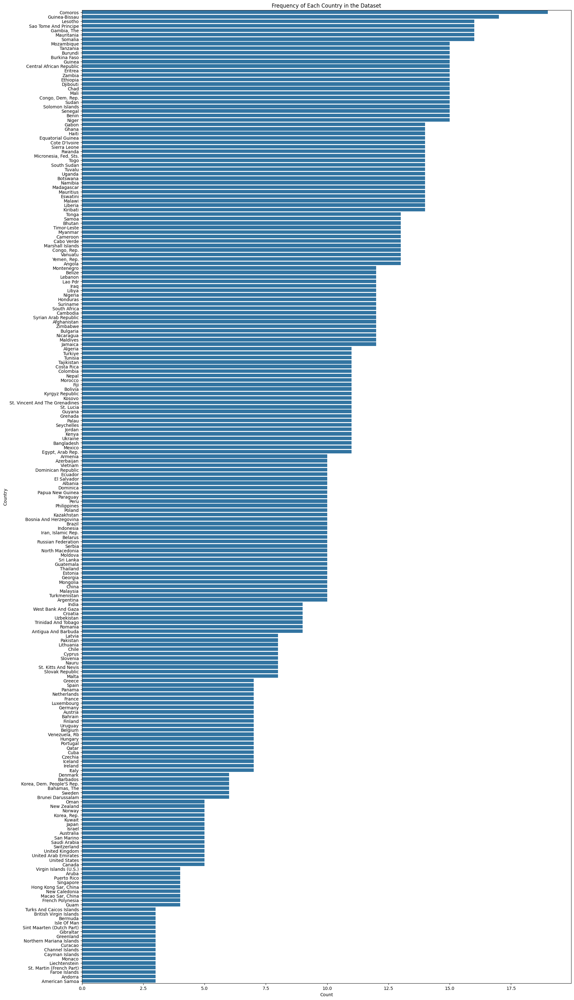

In [14]:
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
from shapely.geometry import Point
import pandas as pd

# Assuming your DataFrame is named 'df'

def plot_group_counts(data):
    plt.figure(figsize=(15, 15))
    sns.countplot(y='Group', data=data, order = data['Group'].value_counts().index)
    plt.title('Frequency of Different Groups')
    plt.xlabel('Count')
    plt.ylabel('Group')
    plt.show()

# Function 2: Pie Chart for Group Types
def plot_group_types(data):
    group_types = data['Group Type'].value_counts()
    plt.figure(figsize=(15, 15))
    plt.pie(group_types, labels=group_types.index, autopct='%1.1f%%', startangle=140)
    plt.title('Distribution of Group Types')
    plt.show()

# Function 3: Geospatial Plot
def plot_geospatial_data(data):
    gdf = gpd.GeoDataFrame(data, geometry=gpd.points_from_xy(data.longitude, data.latitude))
    world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
    fig, ax = plt.subplots(figsize=(15, 15))
    world.plot(ax=ax, color='lightgrey')
    gdf.plot(ax=ax, marker='o', color='red', markersize=5)
    plt.title('Geographical Distribution of Capital Cities')
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.show()

# Function 4: Country Frequency Plot
def plot_country_frequency(data):
    plt.figure(figsize=(20, 40))
    sns.countplot(y='Country', data=data, order = data['Country'].value_counts().index)
    plt.title('Frequency of Each Country in the Dataset')
    plt.xlabel('Count')
    plt.ylabel('Country')
    plt.show()

plot_group_counts(datasets['country_groups_all'])
plot_group_types(datasets['country_groups_all'])
plot_geospatial_data(datasets['country_groups_all'])
plot_country_frequency(datasets['country_groups_all'])


In [15]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

import geopandas as gpd
import matplotlib.pyplot as plt
import pandas as pd

def plot_world_heatmaps(df):
    # Load a world map
    world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

    # Compute the mean for each country
    # Assuming the 'economy' column contains the country codes
    df_mean = df.groupby('economy').mean().reset_index()

    # Ensure the country code column in your DataFrame matches the world map's country code format
    # This might involve converting codes or merging dataframes

    # Merge your DataFrame with the world GeoDataFrame
    merged = world.merge(df_mean, left_on='iso_a3', right_on='economy')

    # List of columns to plot
    percent_columns = [col for col in df_mean.columns if col.startswith('YR')]

    # Plotting each column in a separate subplot
    num_cols = len(percent_columns)
    fig, axs = plt.subplots(num_cols, 1, figsize=(15, 6 * num_cols))

    for i, col in enumerate(percent_columns):
        merged.plot(column=col, ax=axs[i], legend=True,
                    legend_kwds={'label': f"Average {col} by Country",
                                 'orientation': "horizontal"})
        axs[i].set_title(f'Heatmap of Average {col}')

    plt.tight_layout()
    plt.show()
    
def plot_world_heatmap(df):
    # Load a world map
    world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

    # Compute the average value for each country across specified columns
    # Assuming the columns of interest are named like 'YR2000', 'YR2001', etc.
    columns_of_interest = [col for col in df.columns if col.startswith('YR')]
    df['average'] = df[columns_of_interest].mean(axis=1)

    # Merge your DataFrame with the world GeoDataFrame
    # Ensure the country code column in your DataFrame matches the world map's country code format
    merged = world.merge(df, left_on='iso_a3', right_on='economy')

    # Plotting
    fig, ax = plt.subplots(1, 1, figsize=(15, 10))
    merged.plot(column='average', ax=ax, legend=True,
                legend_kwds={'label': "Average Value by Country",
                             'orientation': "horizontal"})
    ax.set_title('World Heatmap of Average Values')

    plt.show()
    
def plot_world_comparison_map(df):
    world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

    # Determine the first and last year columns
    columns_of_interest = [col for col in df.columns if col.startswith('YR')]
    first_year_col = columns_of_interest[0]
    last_year_col = columns_of_interest[-1]

    # Create a new column for color coding
    df['color'] = df.apply(lambda row: 'red' if row[first_year_col] > row[last_year_col] else 'green', axis=1)

    # Merge with the world GeoDataFrame
    merged = world.merge(df, left_on='iso_a3', right_on='economy')

    # Plotting
    fig, ax = plt.subplots(1, 1, figsize=(15, 7))
    for color in ['red', 'green']:
        merged[merged['color'] == color].plot(color=color, ax=ax)

    ax.set_title('World Map Comparison Between First and Last Year')
    plt.show()
    
def plot_country_clusters(df):
    
    columns_of_interest = [col for col in df.columns if col.startswith('YR')]
    
    pca = PCA(n_components=3)  # Adjust the number of components based on your dataset
    reduced_data = pca.fit_transform(df[columns_of_interest])

    # K-Means Clustering
    kmeans = KMeans(n_clusters=7)  # Adjust the number of clusters as needed
    clusters = kmeans.fit_predict(reduced_data)
    df['cluster'] = clusters

    # Step 2: Geospatial Visualization
    world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
    merged = world.merge(df, left_on='iso_a3', right_on='economy')

    # Plotting
    fig, ax = plt.subplots(1, 1, figsize=(15, 10))
    merged.plot(column='cluster', ax=ax, legend=True, cmap='viridis')
    ax.set_title('World Map with Clustered Countries')

    plt.show()

def countries_with_biggest_change(df):
    # Assuming the first and last columns (after 'economy') are the date columns
    first_year_col = df.columns[1]
    last_year_col = df.columns[-1]

    # Calculate the difference
    df['difference'] = df[last_year_col] - df[first_year_col]

    # Sort the DataFrame based on the difference
    sorted_df = df.sort_values(by='difference', ascending=False)

    # Get the top countries with the biggest change
    top_countries = sorted_df[['economy', 'difference']]

    return top_countries

def plot_line_chart(df, economy):
    data = df[df['economy'] == economy].head(1).values.flatten().tolist()[1:-2]
    plt.figure(figsize=(15, 9))
    sns.lineplot(data=data)
    plt.xticks(range(len(data)), [f'{i:02}' for i in range(len(data))])
    plt.title(f'Trend for {economy}')
    plt.show()
    
def plot_average_line_chart(df):
    data = df.iloc[:, 1:-2].mean()
    plt.figure(figsize=(15, 9))
    sns.lineplot(data=data)
    plt.xticks(range(len(data)), [f'{i:02}' for i in range(len(data))])
    plt.title('Average Trend')
    plt.show()
    
def describe_dataset_by_country(df):

    plot_world_heatmap(df.copy(deep=True))
    plot_world_comparison_map(df.copy(deep=True))
    plot_country_clusters(df.copy(deep=True))
    plot_world_heatmaps(df.copy(deep=True))

    top_countries = countries_with_biggest_change(df.copy(deep=True))
    top_countries = top_countries.head(10)["economy"].to_list() + (top_countries.tail(10)["economy"].to_list())

    for x in top_countries:
        plot_line_chart(df.copy(deep=True), x)
        
    plot_average_line_chart(df.copy(deep=True))

# total_birth_rate.csv

/tmp/ipykernel_23130/2692578803.py:41: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


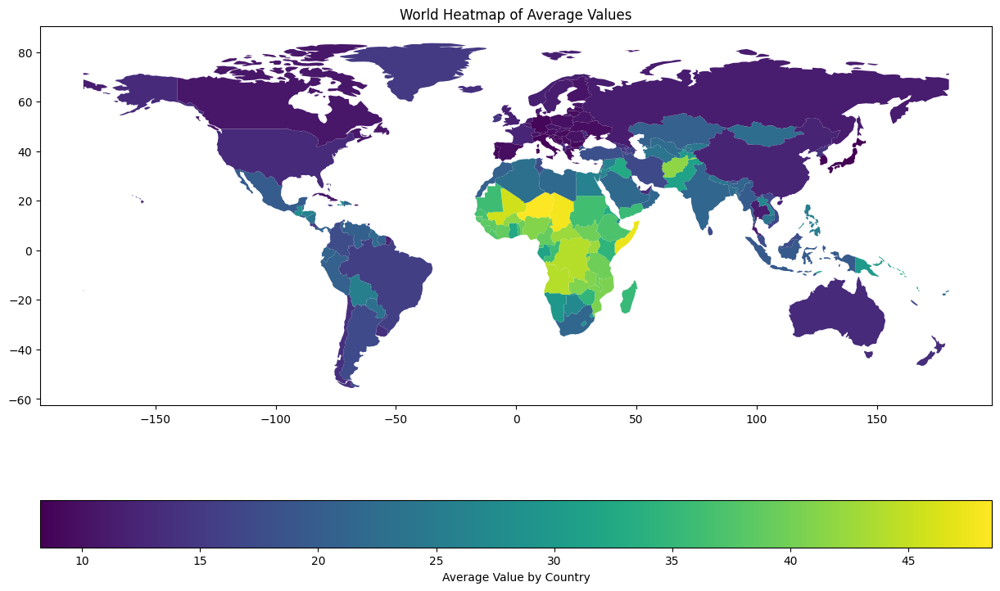

/tmp/ipykernel_23130/2692578803.py:62: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


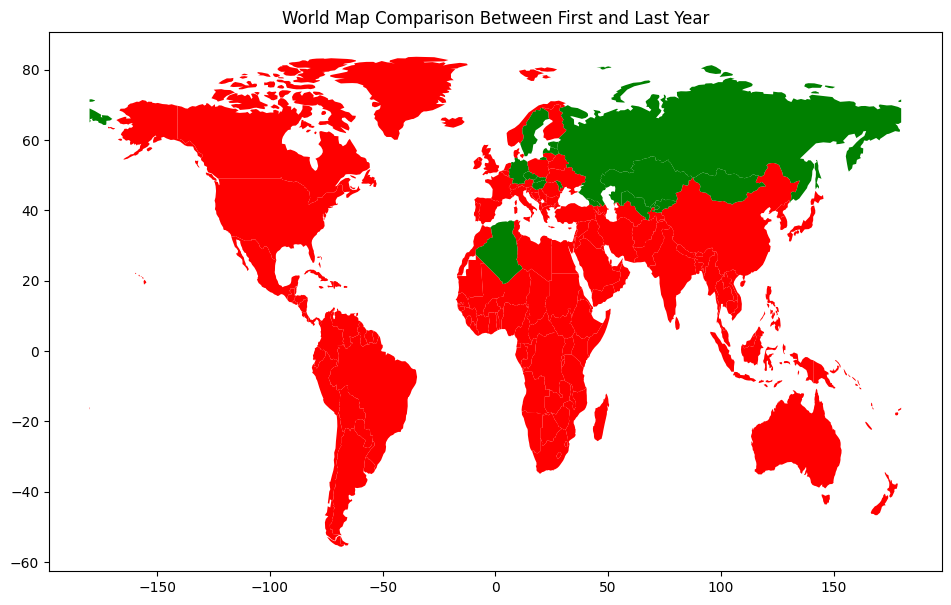

/home/dev/.local/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/tmp/ipykernel_23130/2692578803.py:96: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


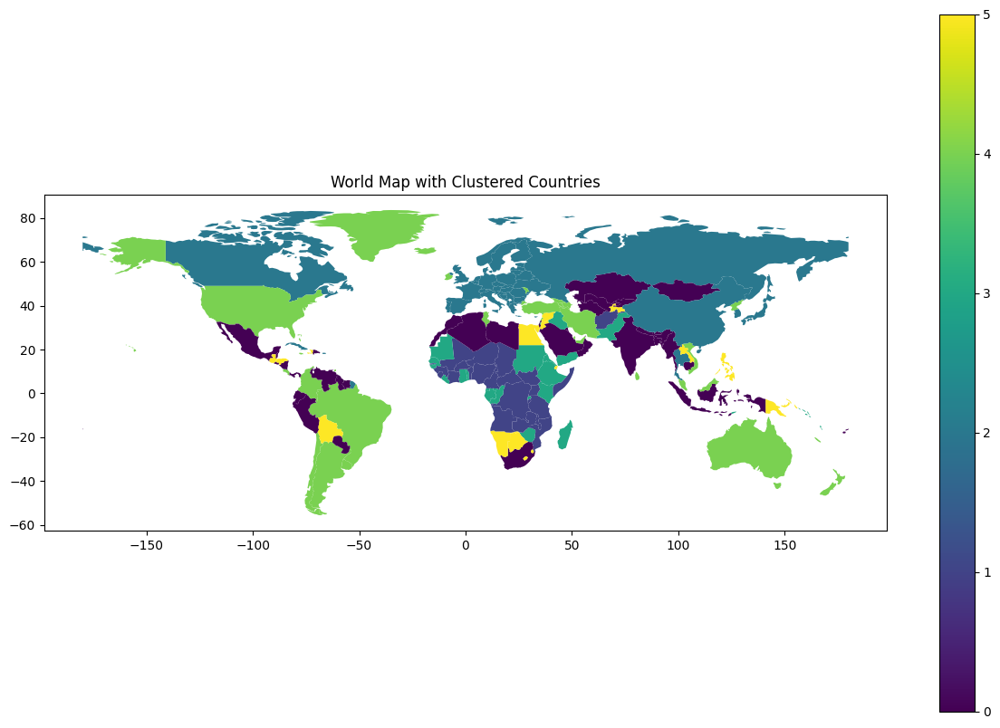

/tmp/ipykernel_23130/2692578803.py:11: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


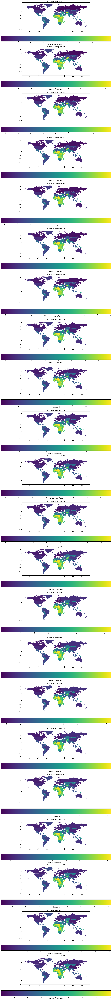

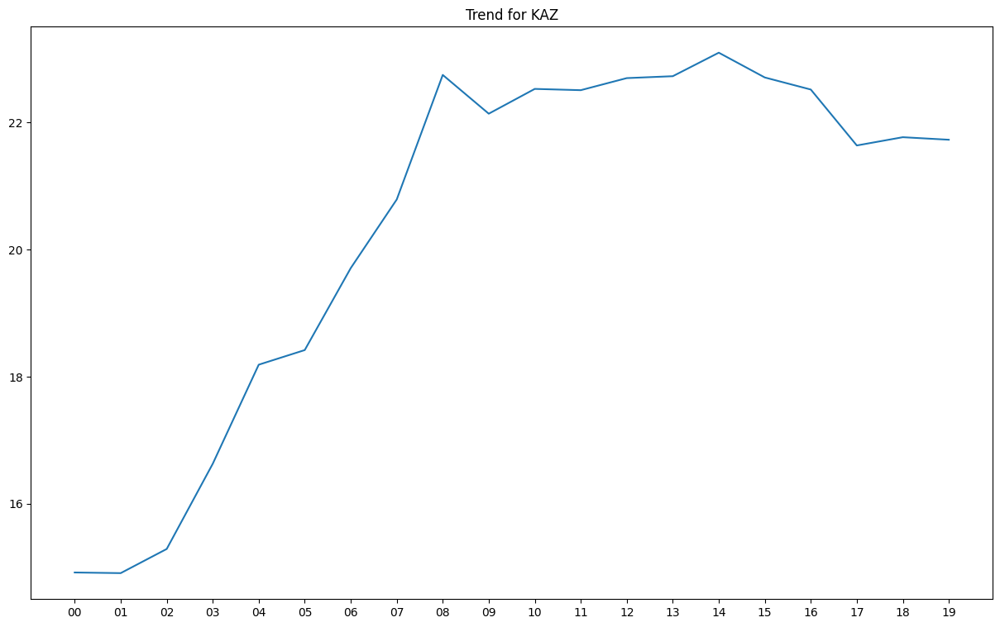

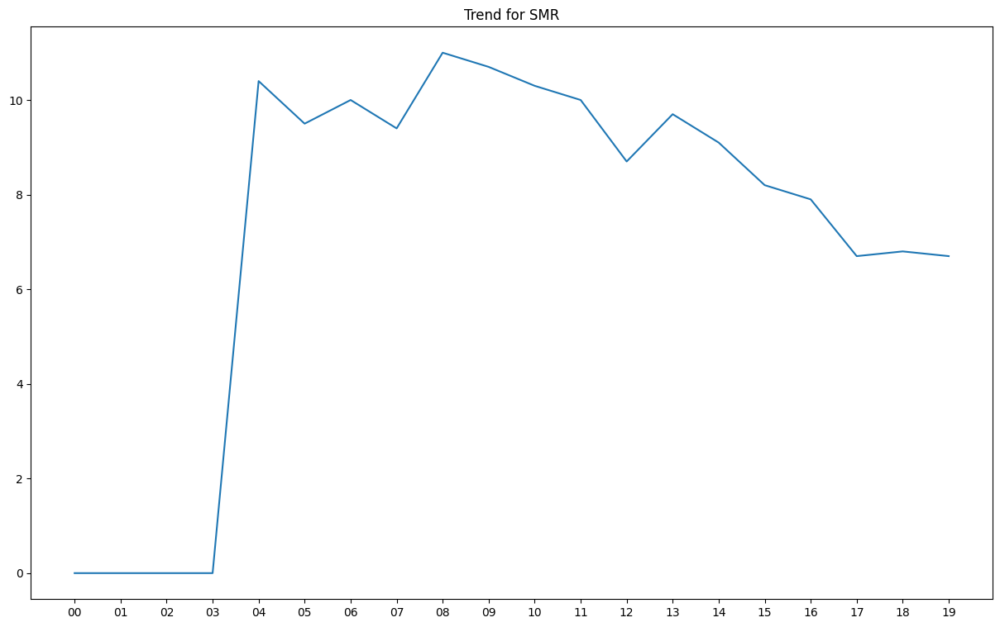

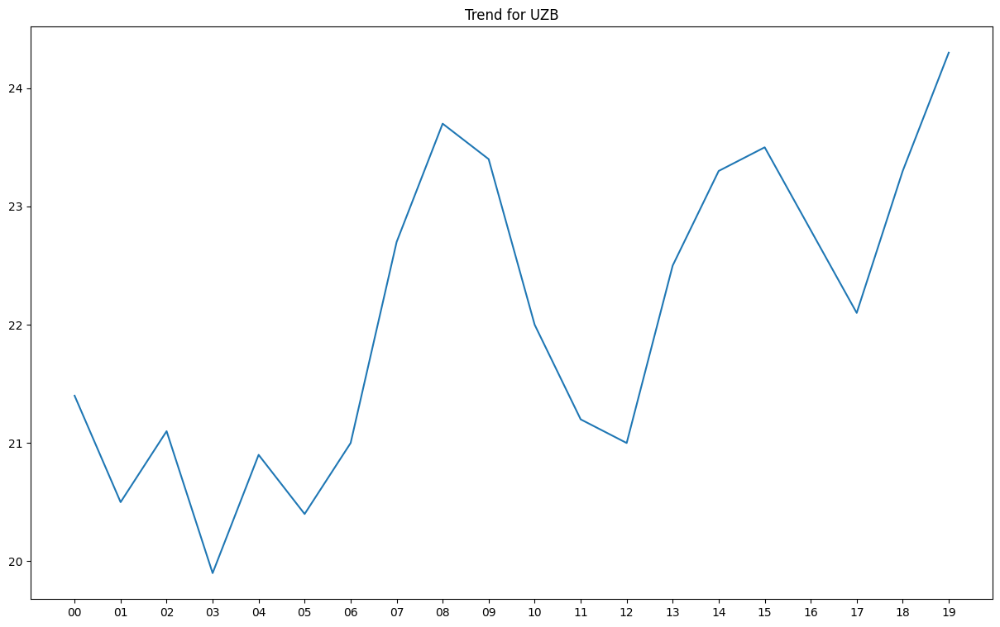

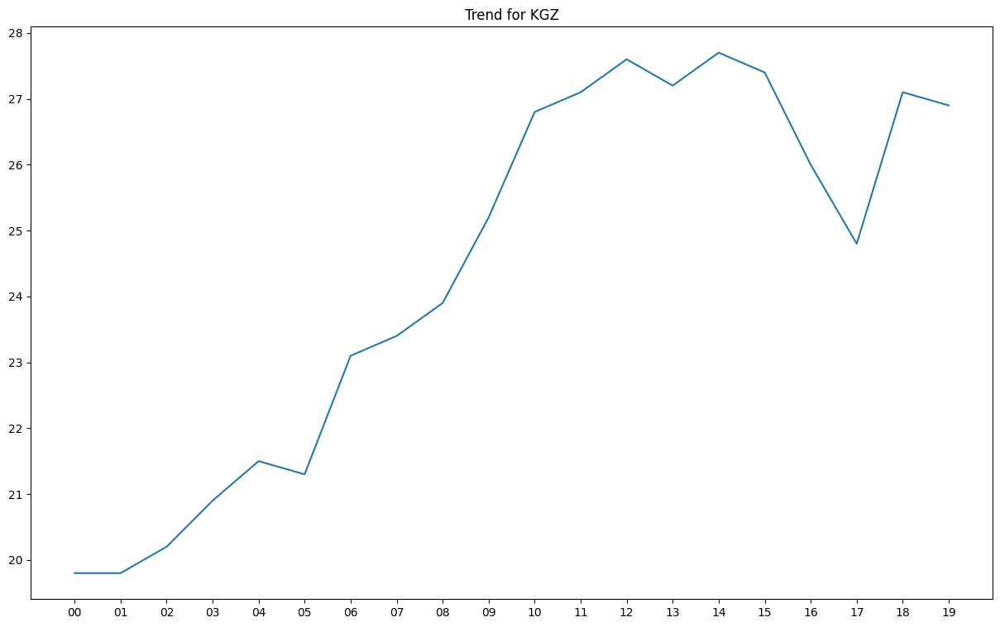

...

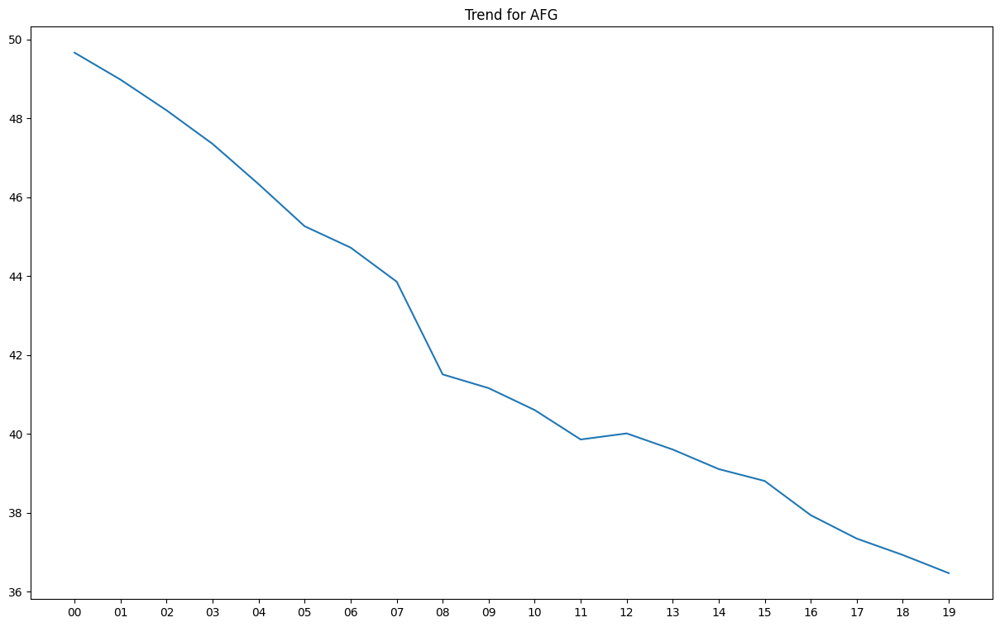

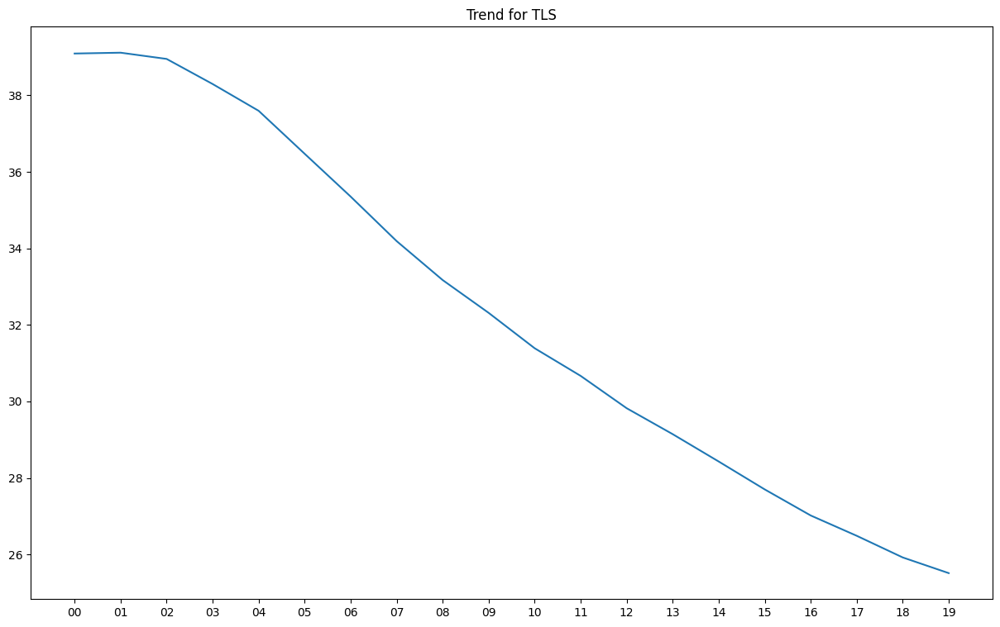

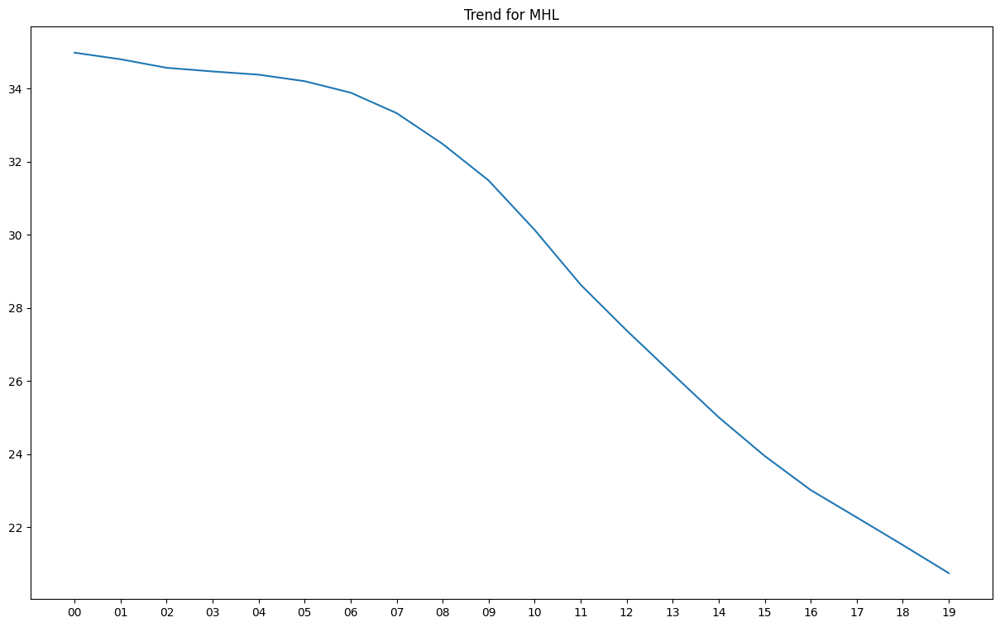

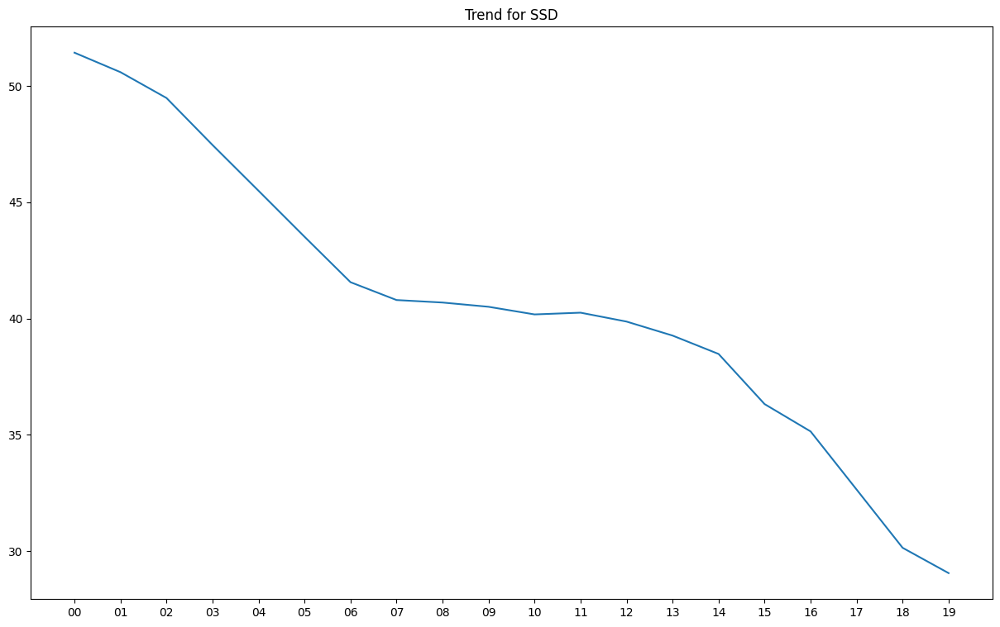

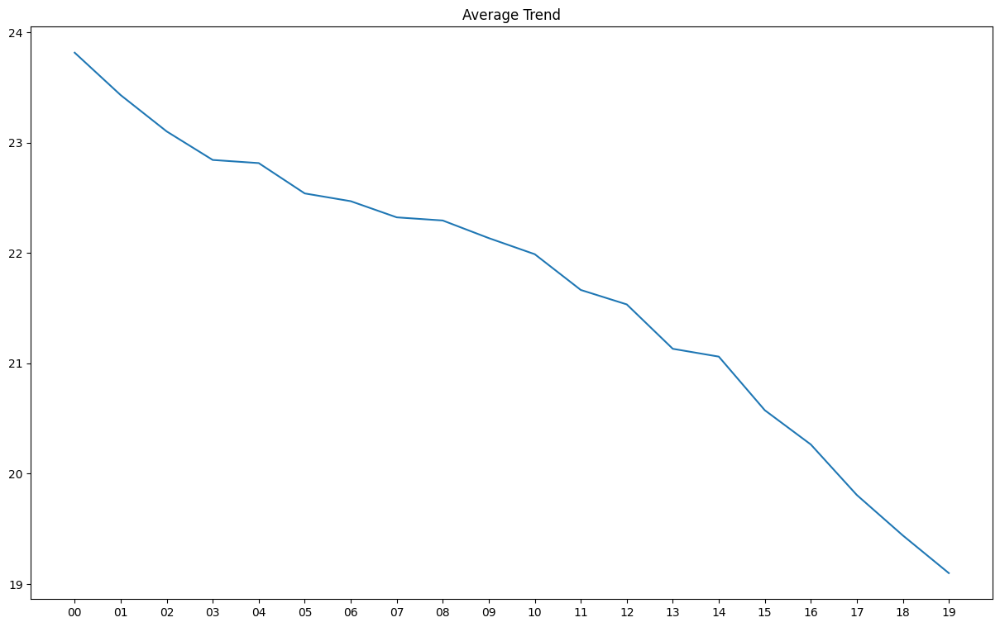

In [16]:
describe_dataset_by_country(datasets['total_birth_rate'])

/tmp/ipykernel_23130/2692578803.py:41: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


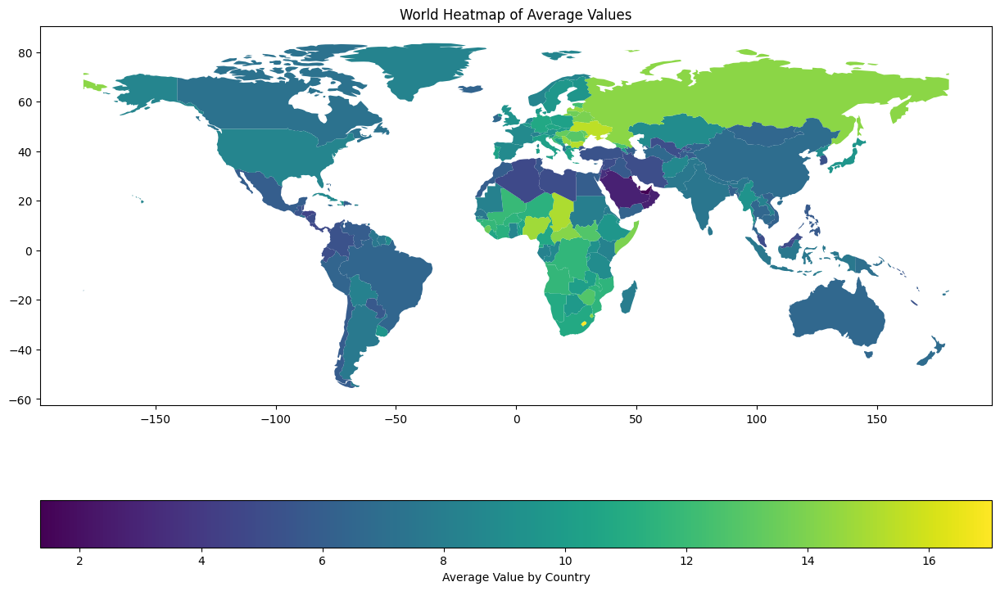

/tmp/ipykernel_23130/2692578803.py:62: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


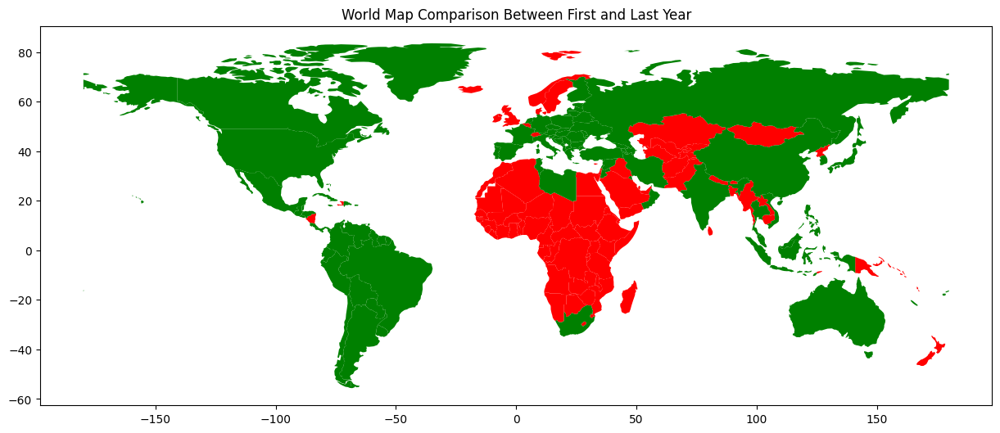

/home/dev/.local/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/tmp/ipykernel_23130/2692578803.py:96: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


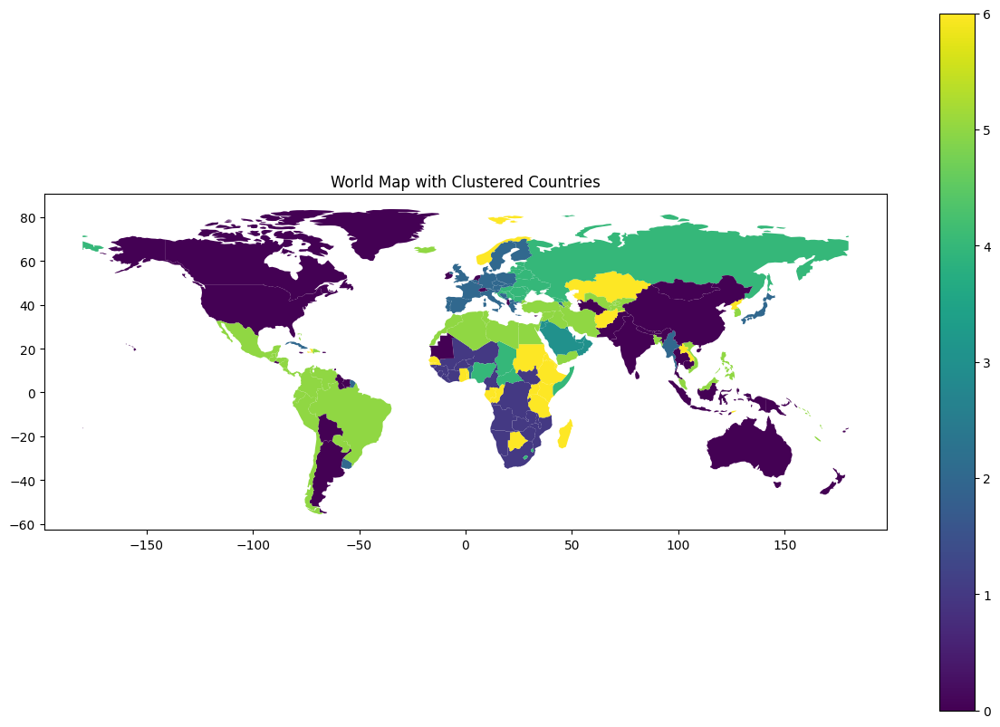

/tmp/ipykernel_23130/2692578803.py:11: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


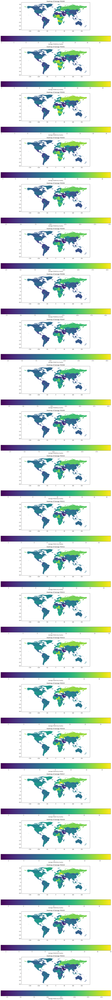

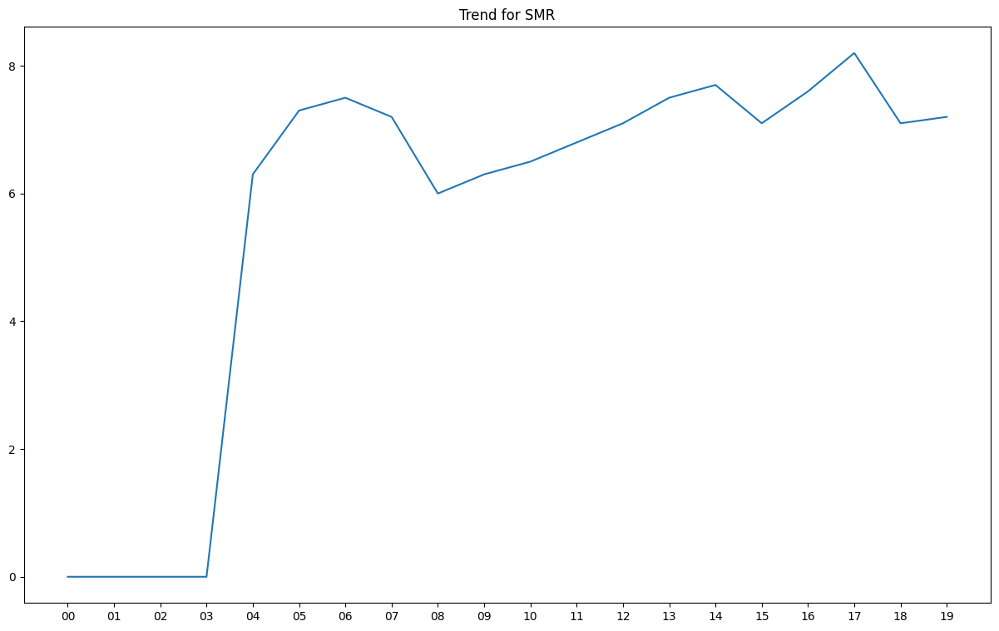

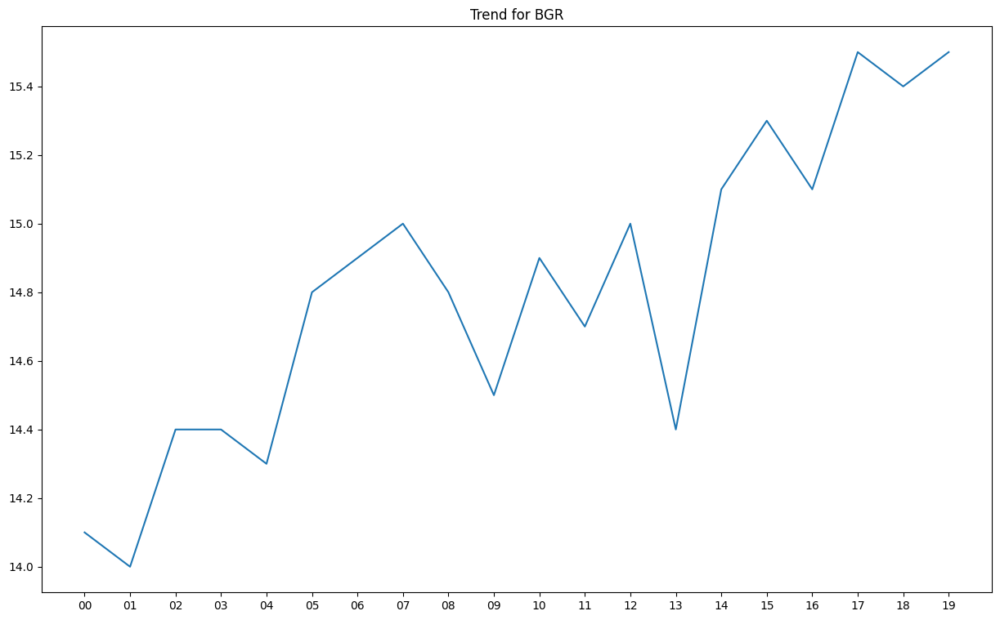

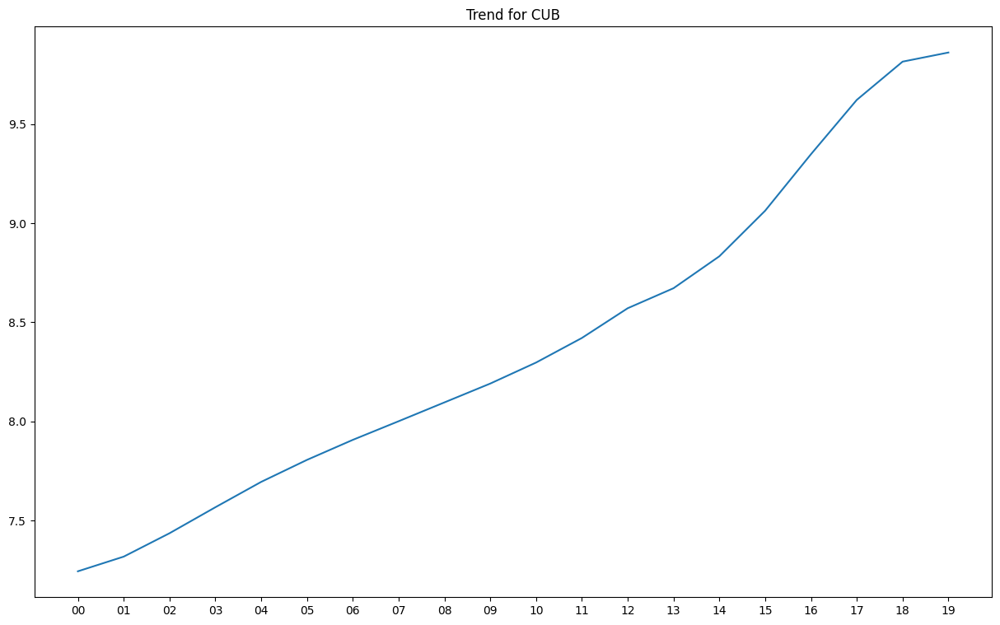

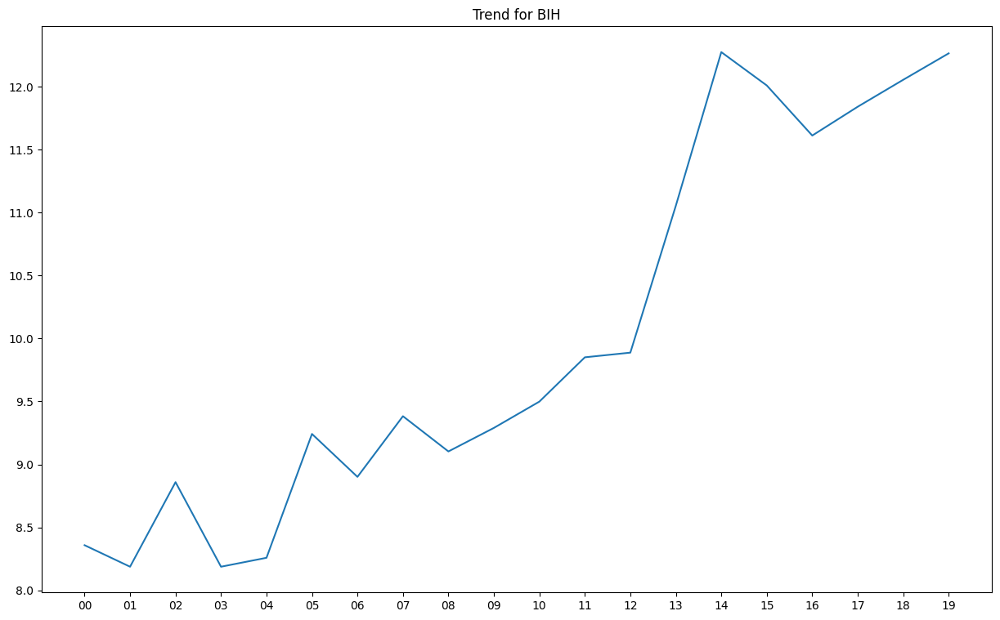

...

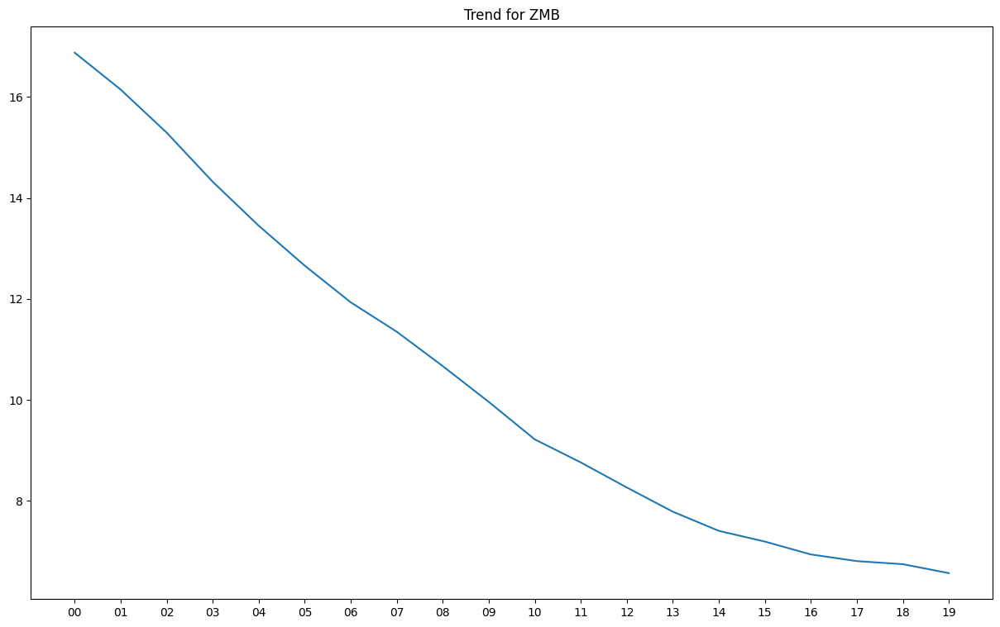

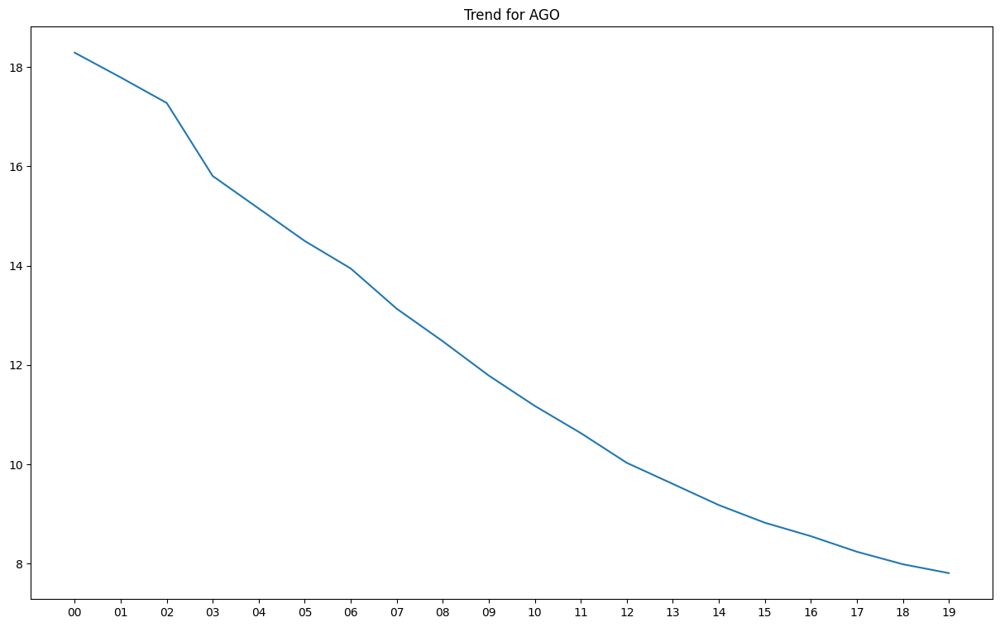

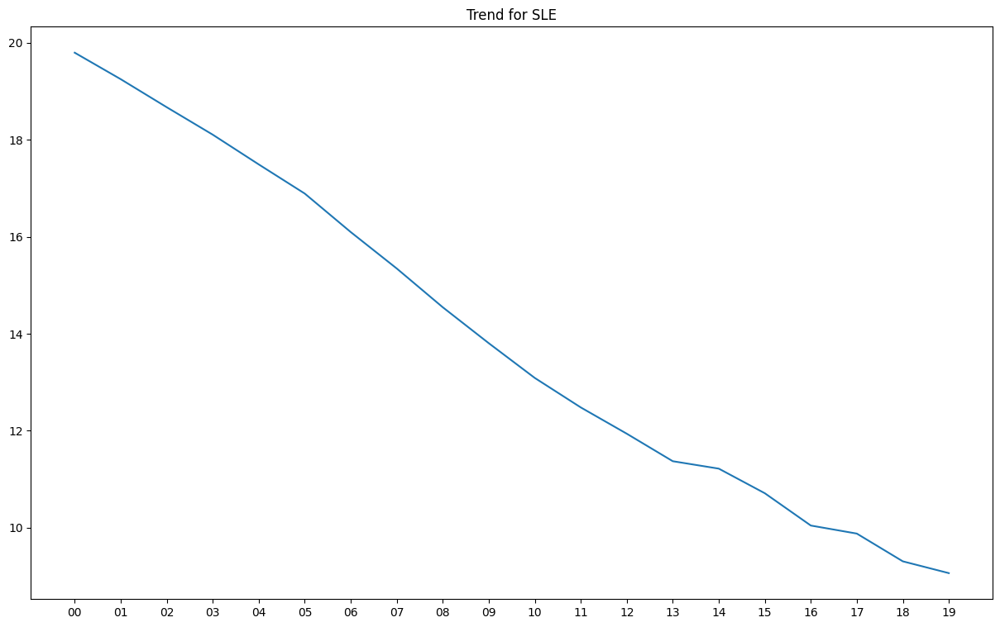

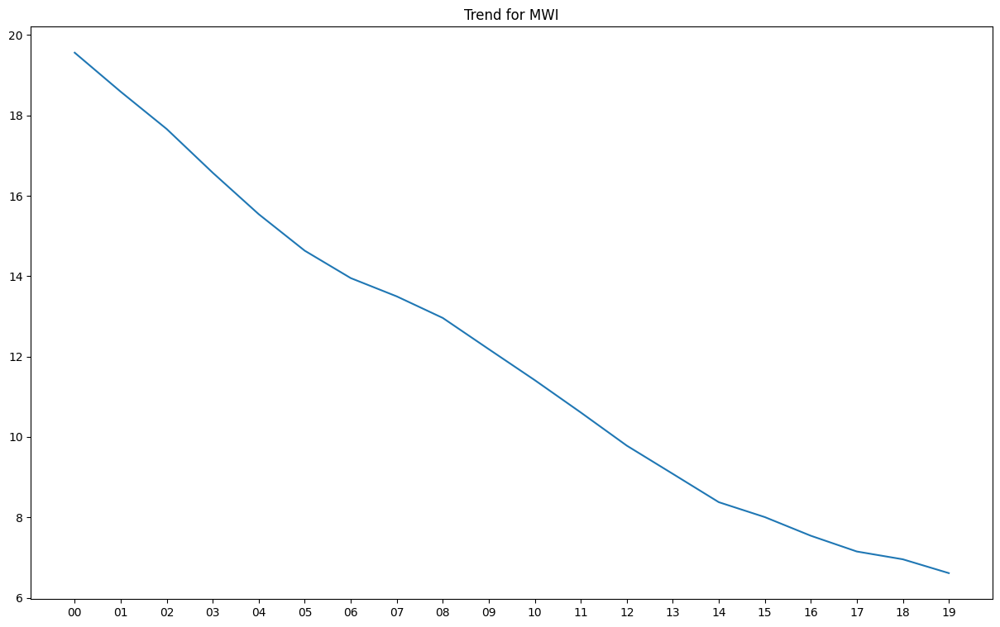

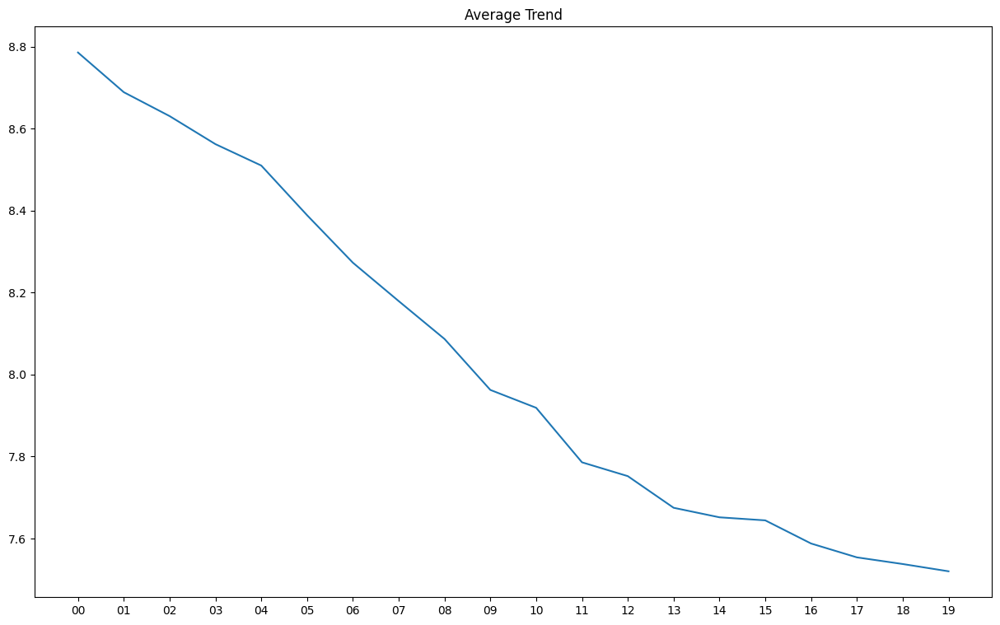

In [17]:
describe_dataset_by_country(datasets['total_death_rate'])

/tmp/ipykernel_23130/2692578803.py:41: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


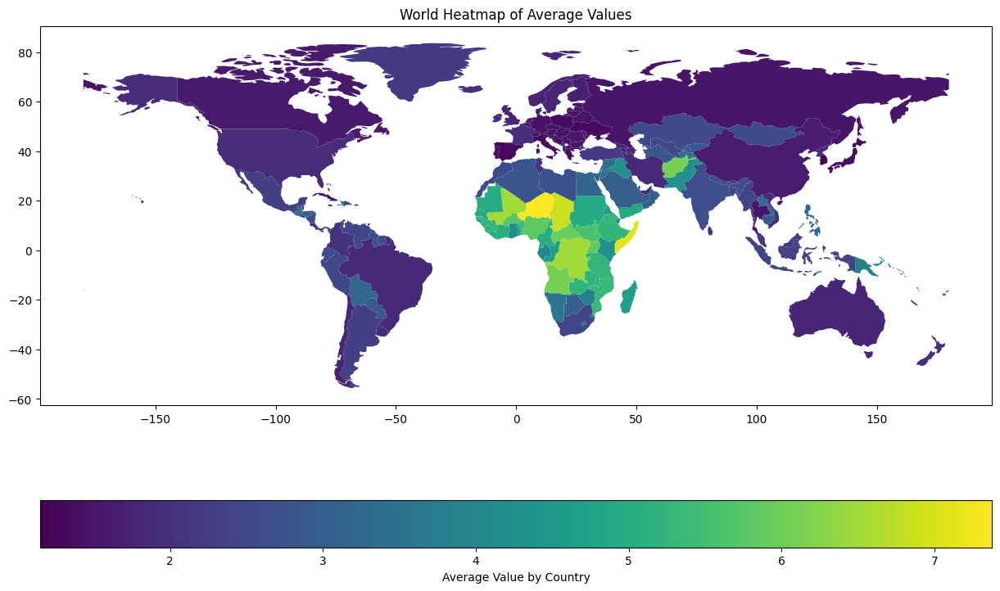

/tmp/ipykernel_23130/2692578803.py:62: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


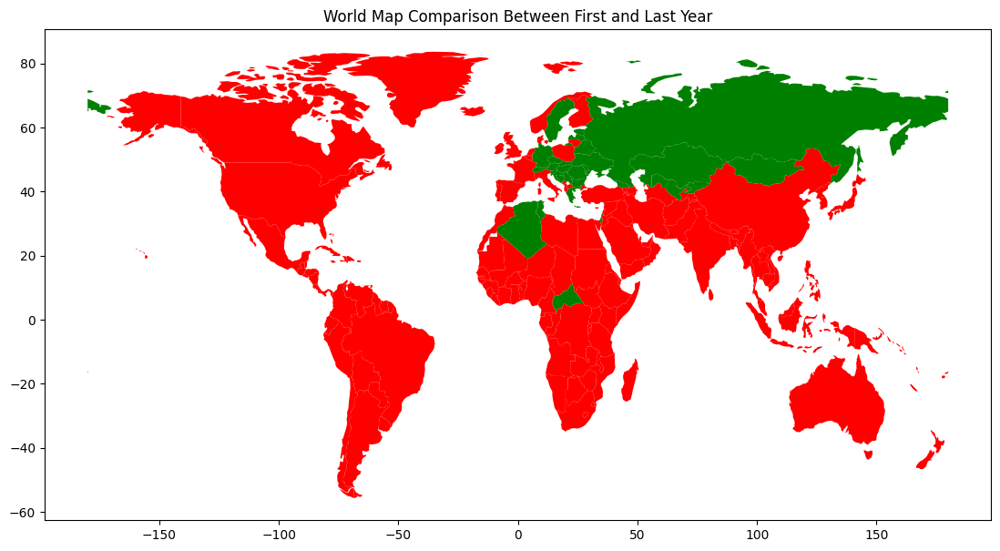

/home/dev/.local/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/tmp/ipykernel_23130/2692578803.py:96: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


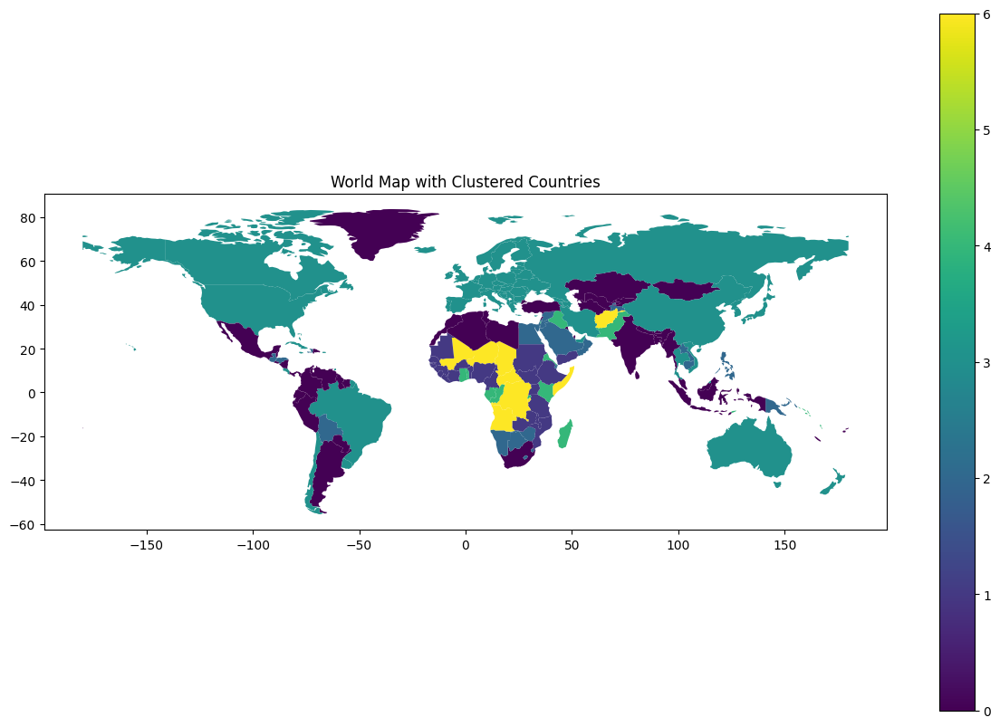

/tmp/ipykernel_23130/2692578803.py:11: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


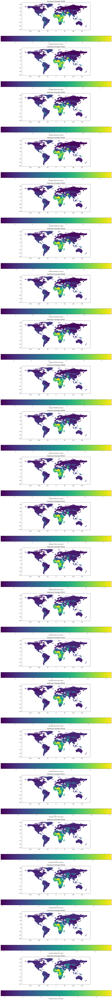

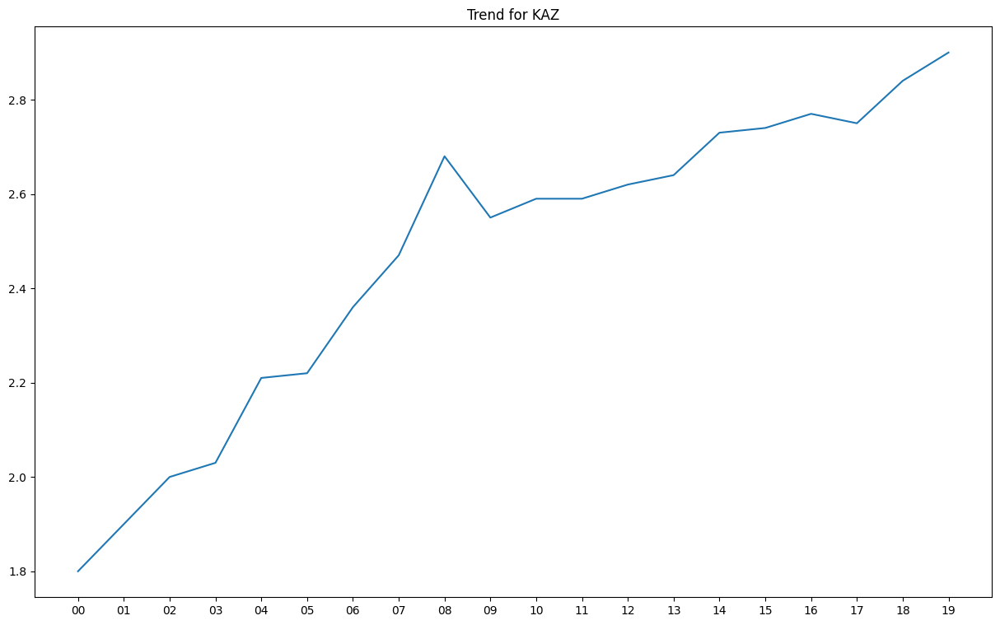

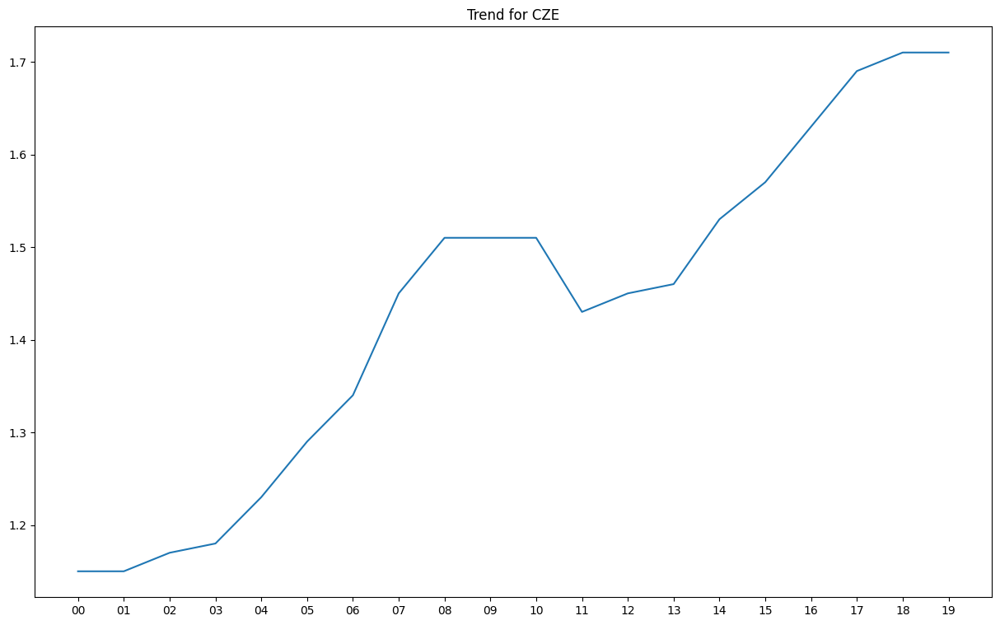

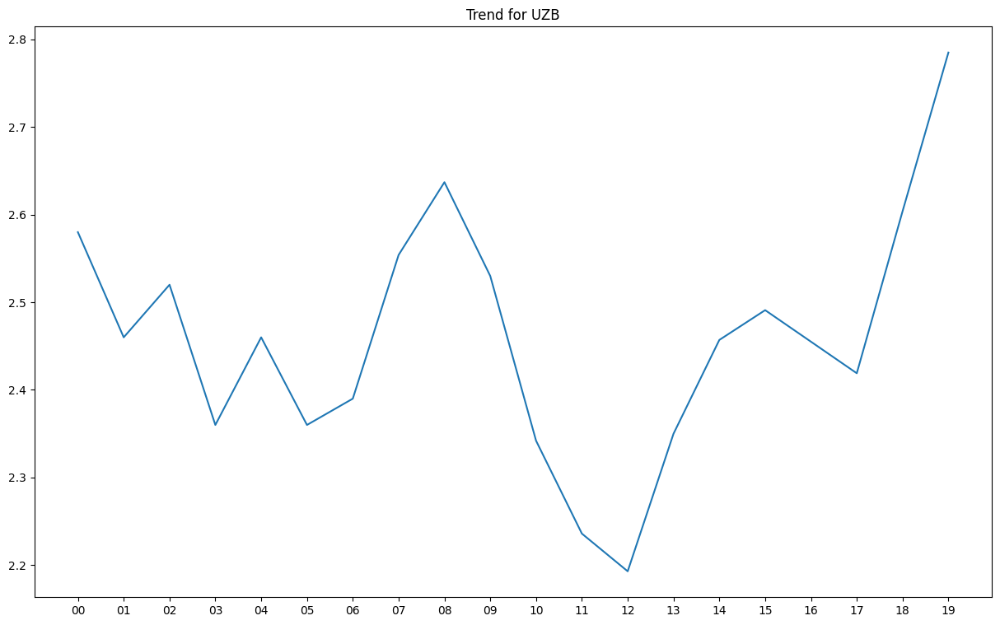

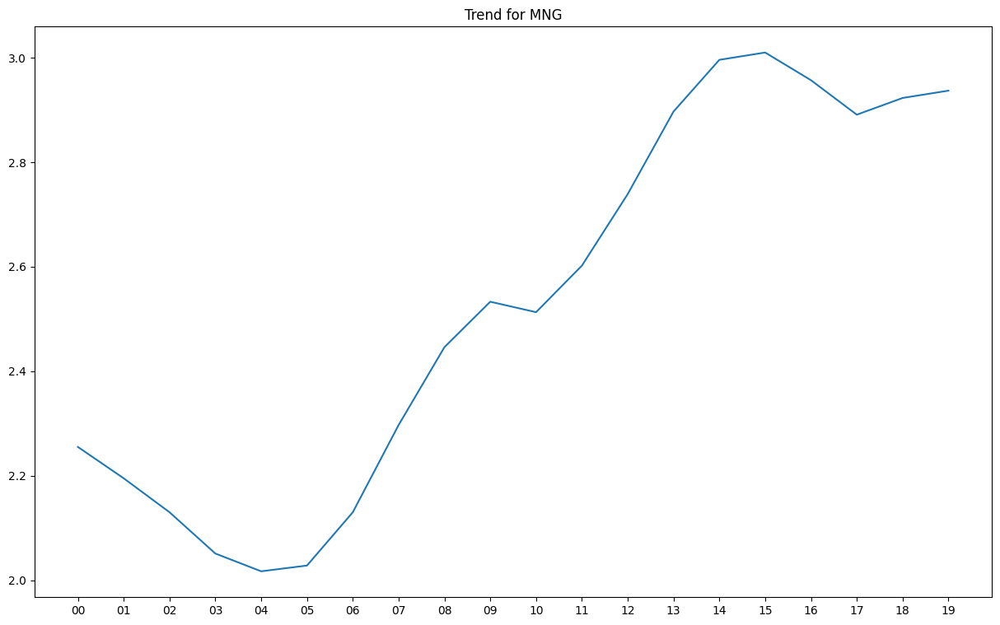

...

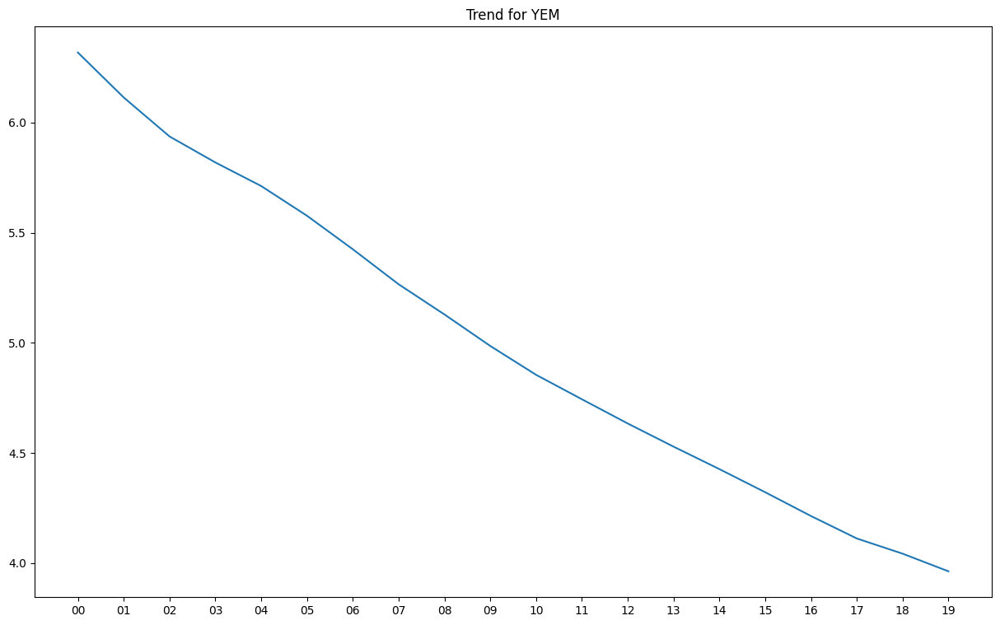

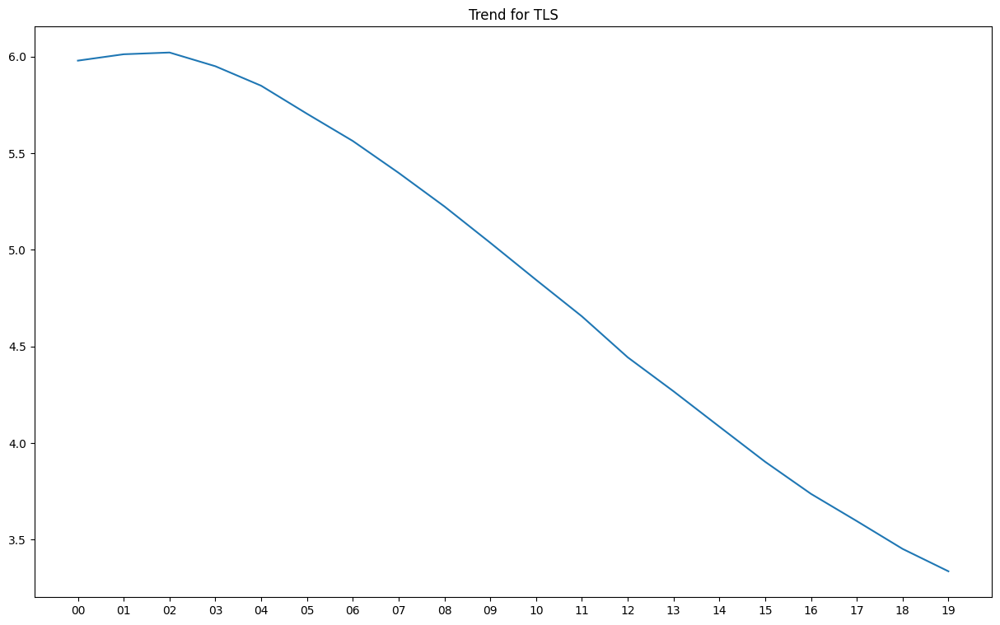

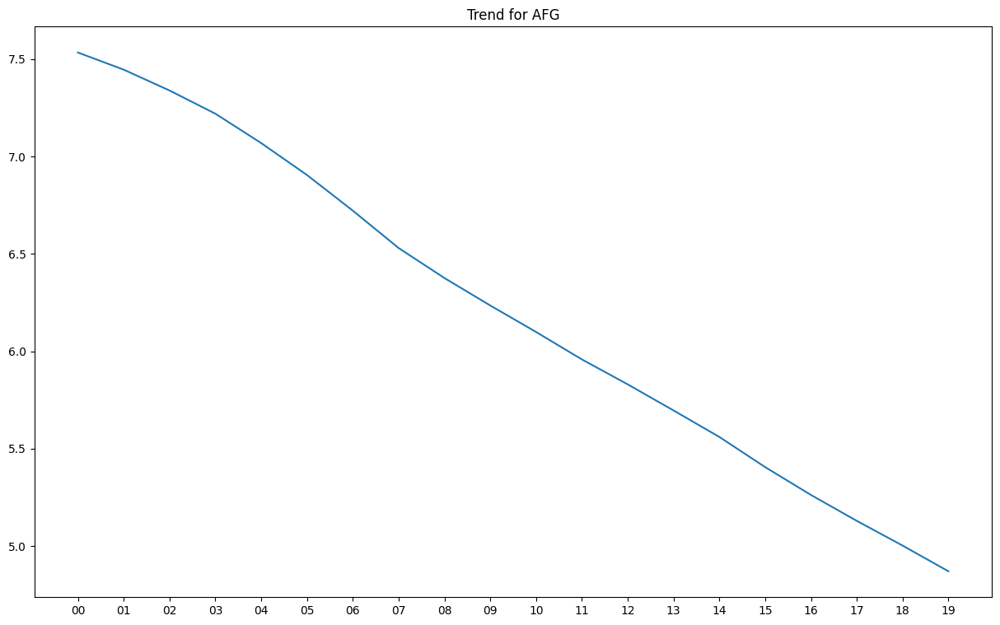

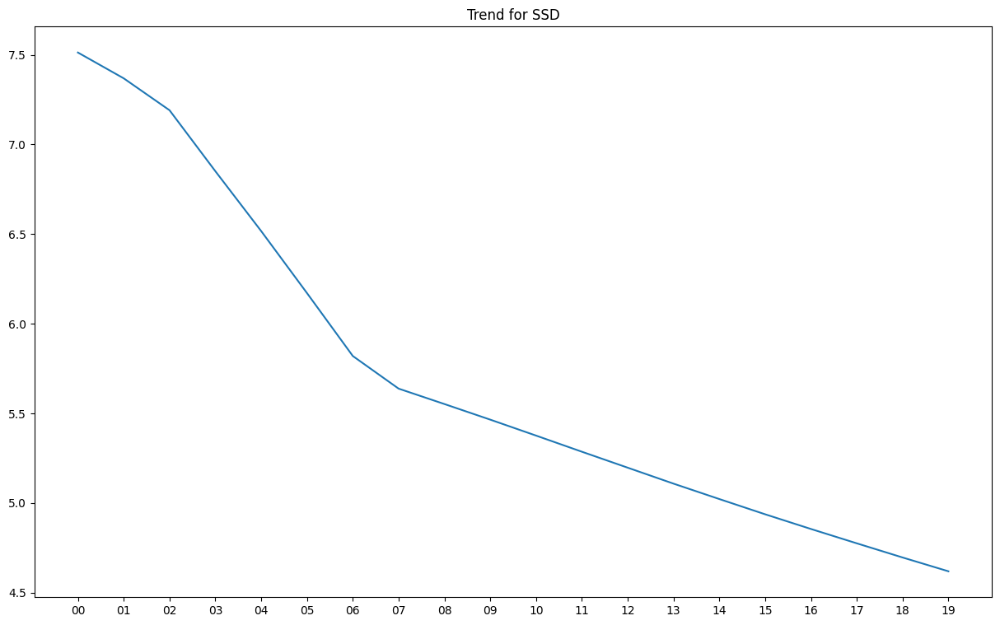

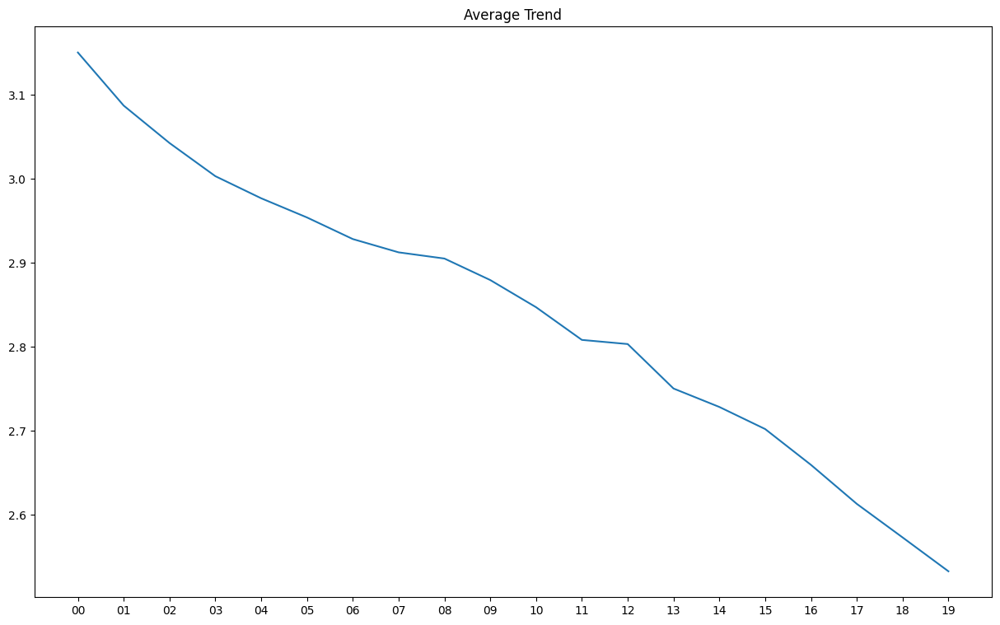

In [18]:
describe_dataset_by_country(datasets['total_fertility_rate'])

/tmp/ipykernel_23130/2692578803.py:41: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


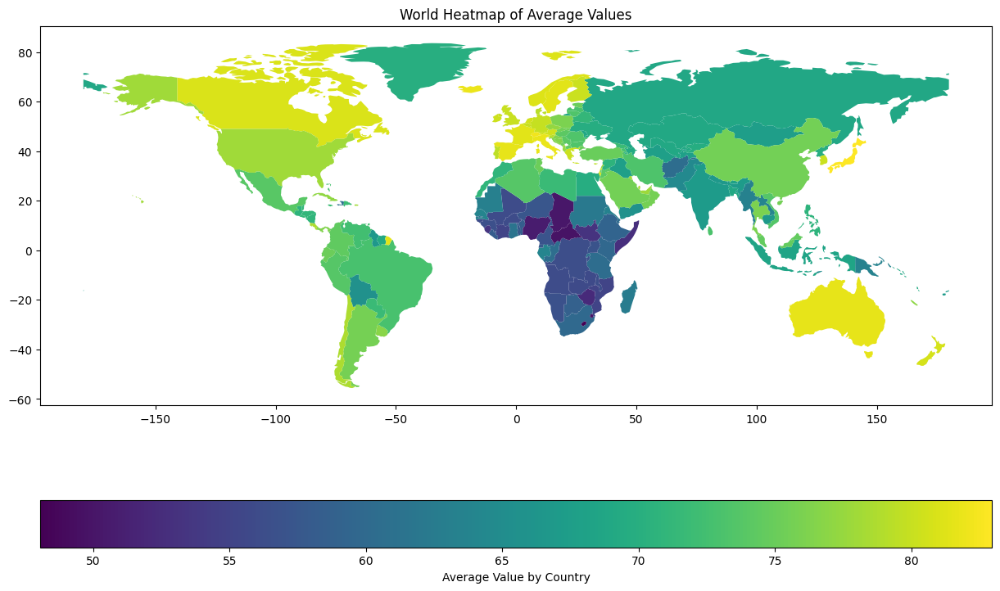

/tmp/ipykernel_23130/2692578803.py:62: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


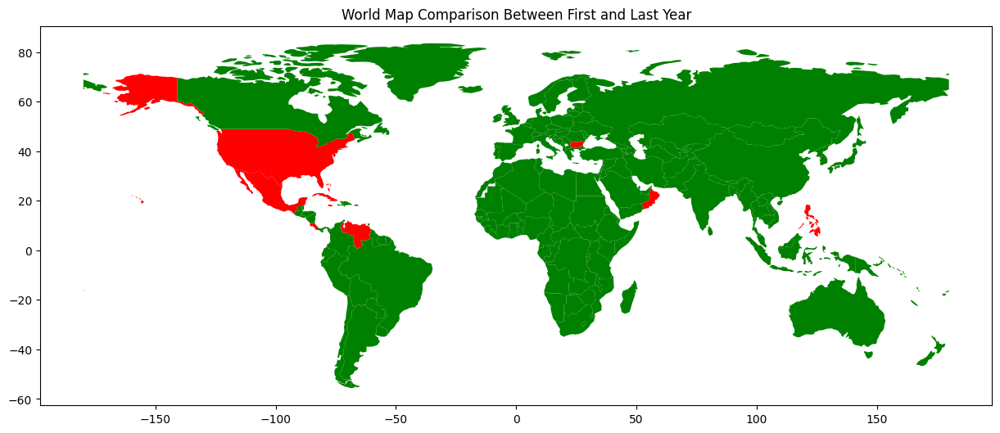

/home/dev/.local/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/tmp/ipykernel_23130/2692578803.py:96: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


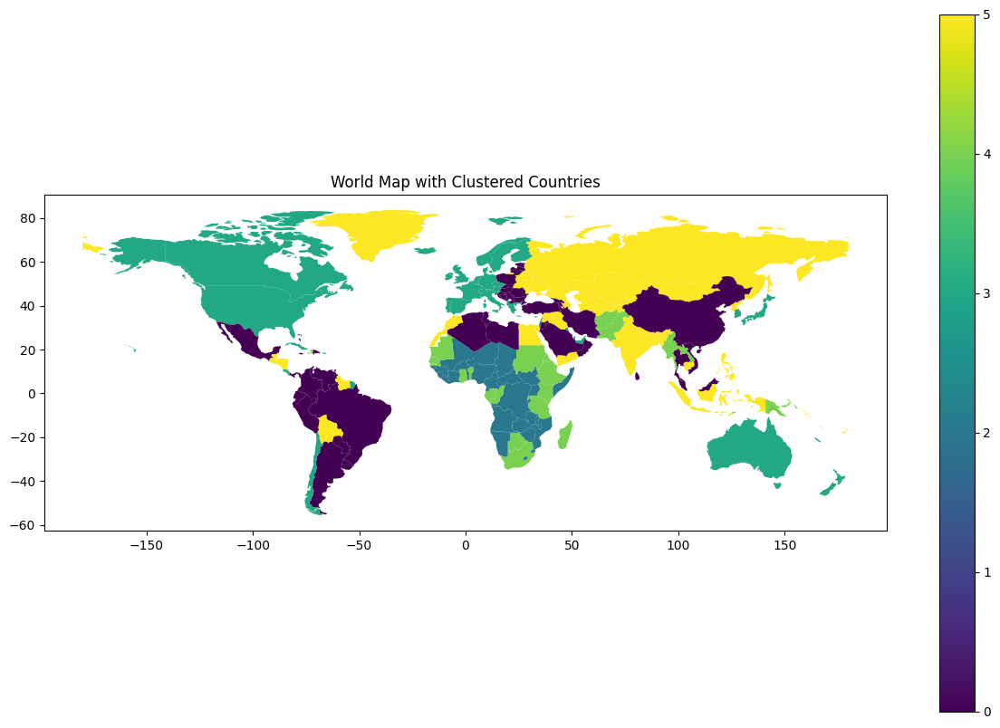

/tmp/ipykernel_23130/2692578803.py:11: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


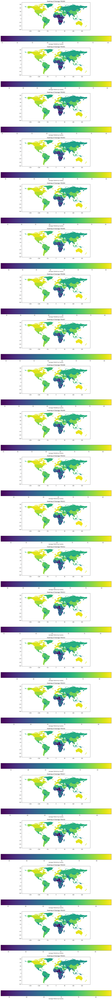

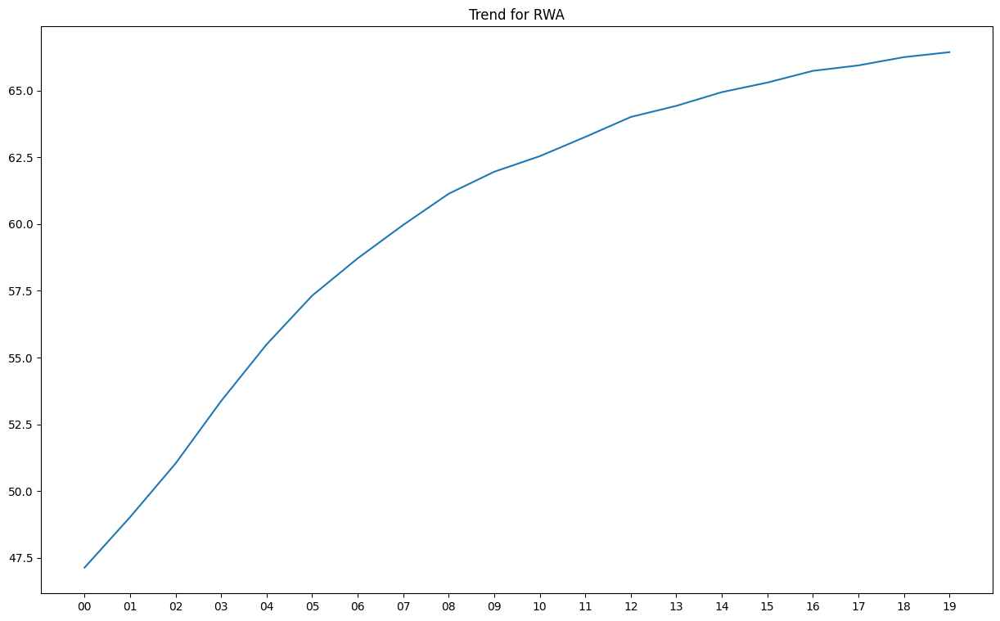

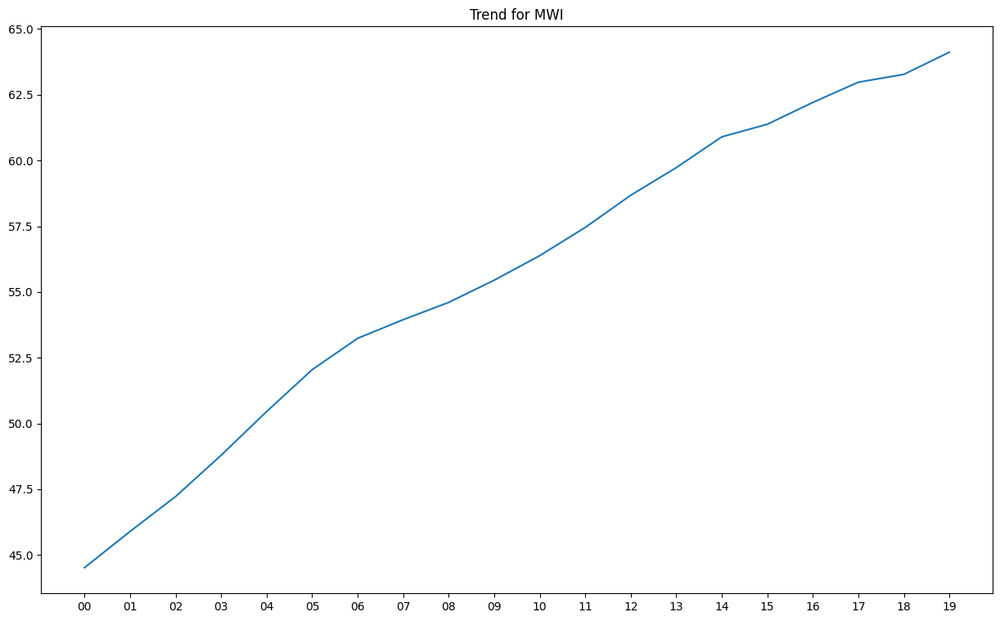

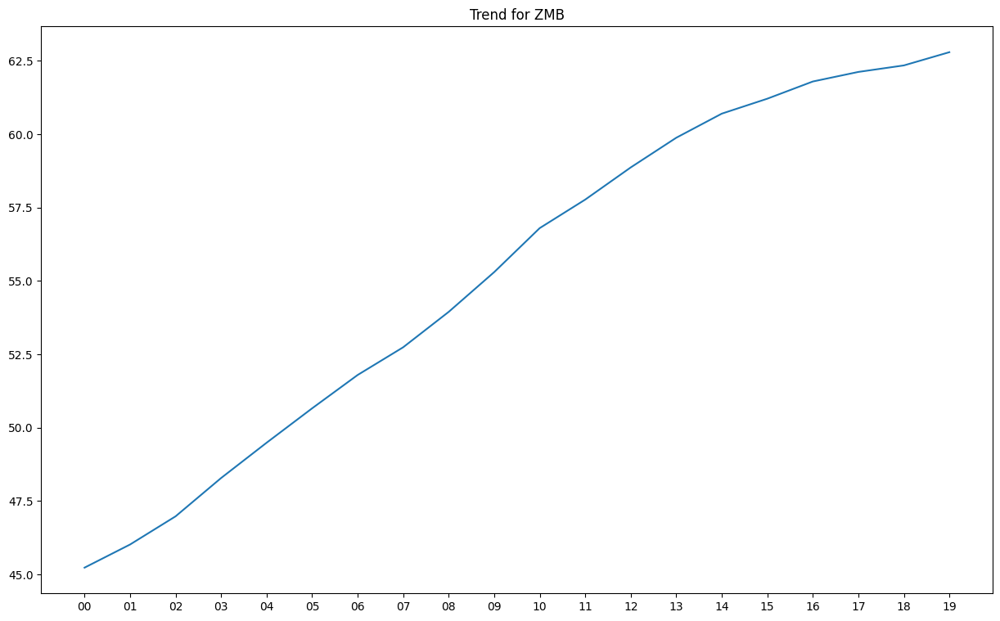

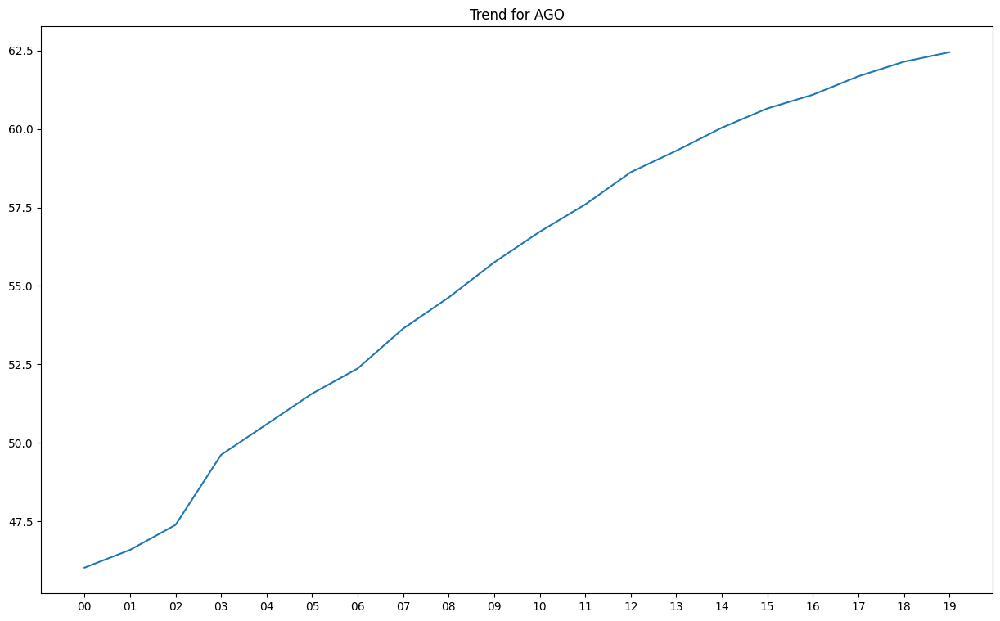

...

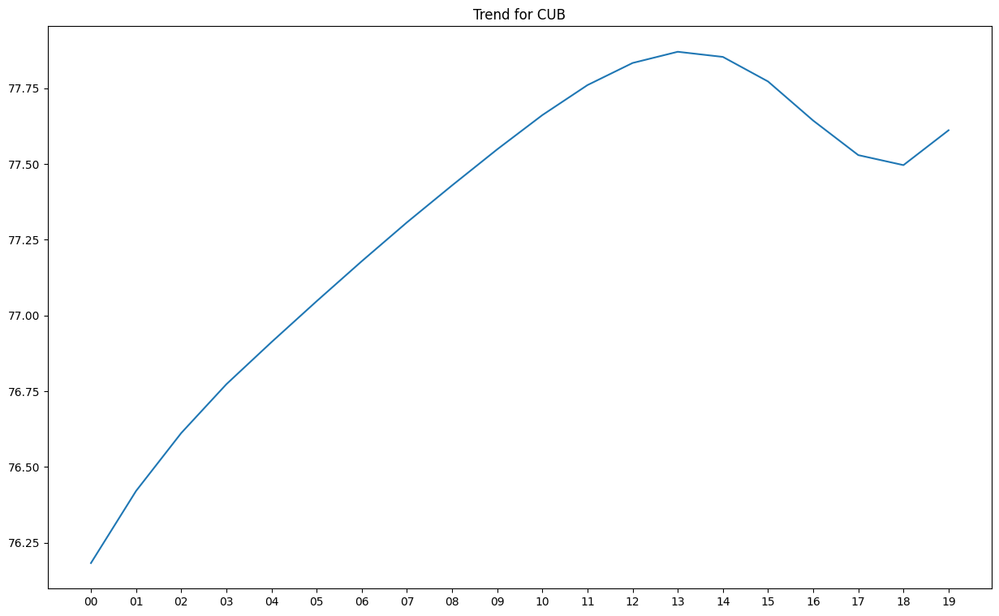

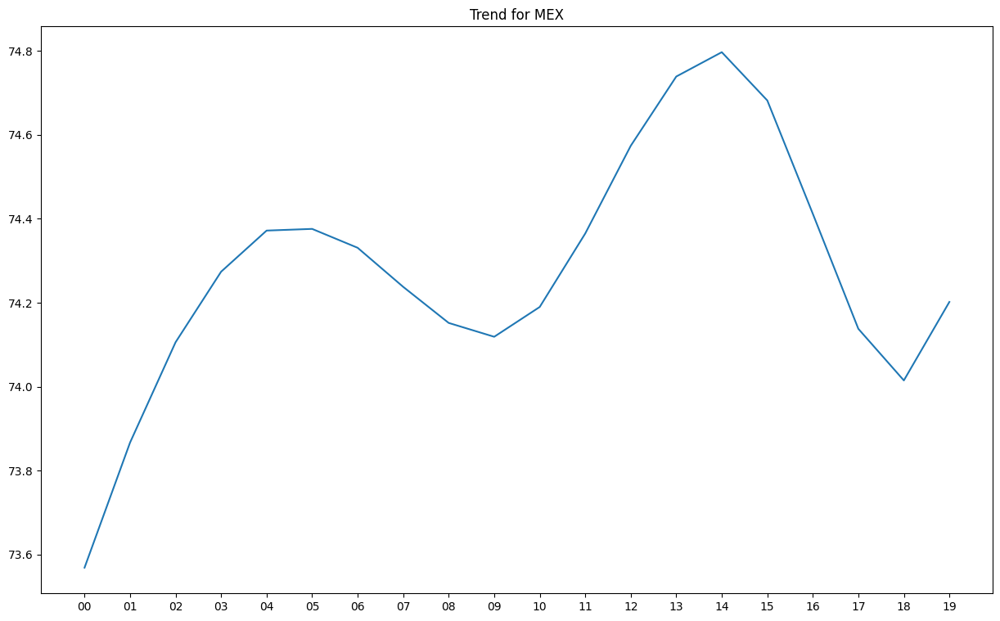

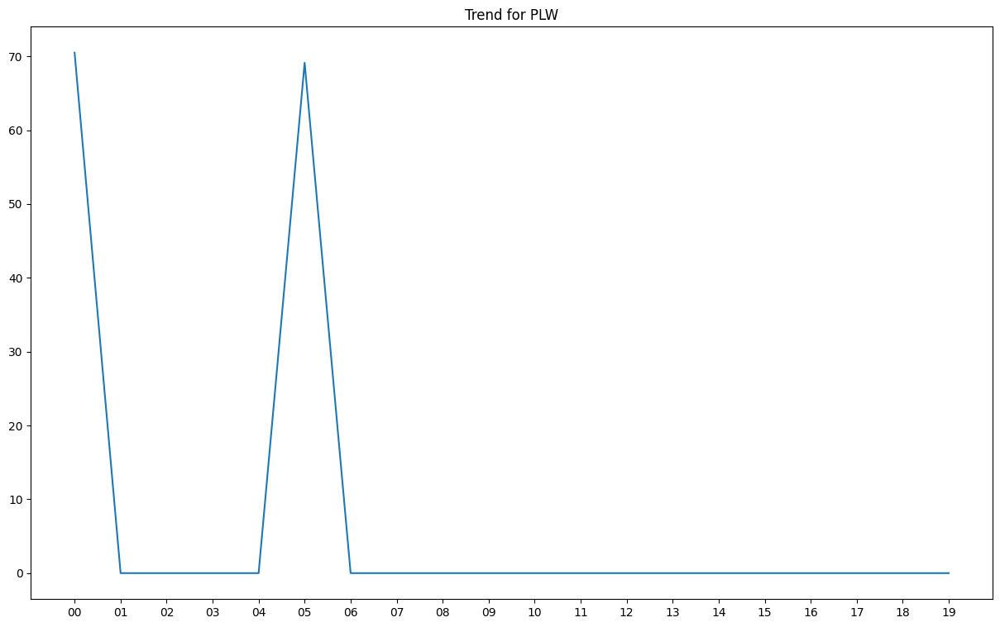

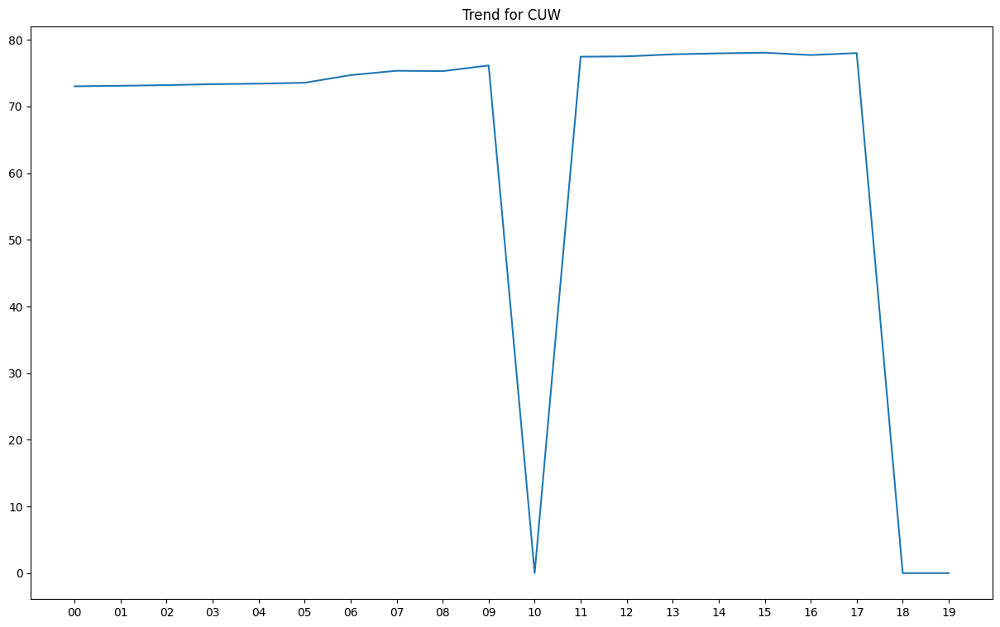

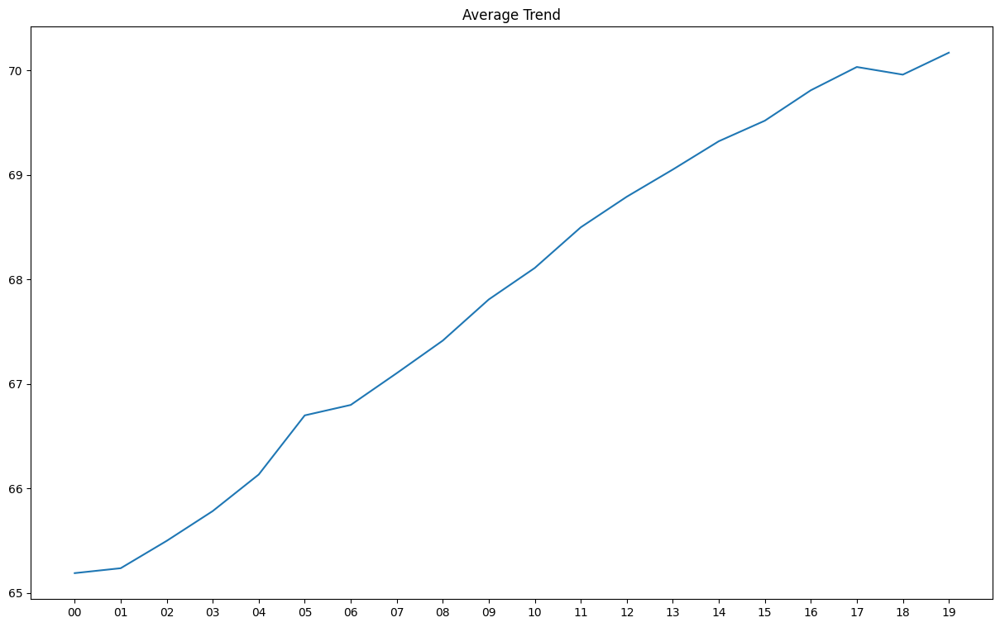

In [19]:
describe_dataset_by_country(datasets['total_life_expectancy_at_birth'])

In [20]:
df = datasets['total_median_age']
df[df.isna().any(axis=1)]

,economy,YR2000,YR2001,YR2002,YR2003,YR2004,YR2005,YR2006,YR2007,YR2008,YR2009,YR2010,YR2011,YR2012,YR2013,YR2014,YR2015,YR2016,YR2017,YR2018,YR2019,YR2020,YR2021
39,CHI,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN


In [21]:
datasets['total_median_age'] = datasets['total_median_age'].dropna().copy(deep=True)

/tmp/ipykernel_23130/2692578803.py:41: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


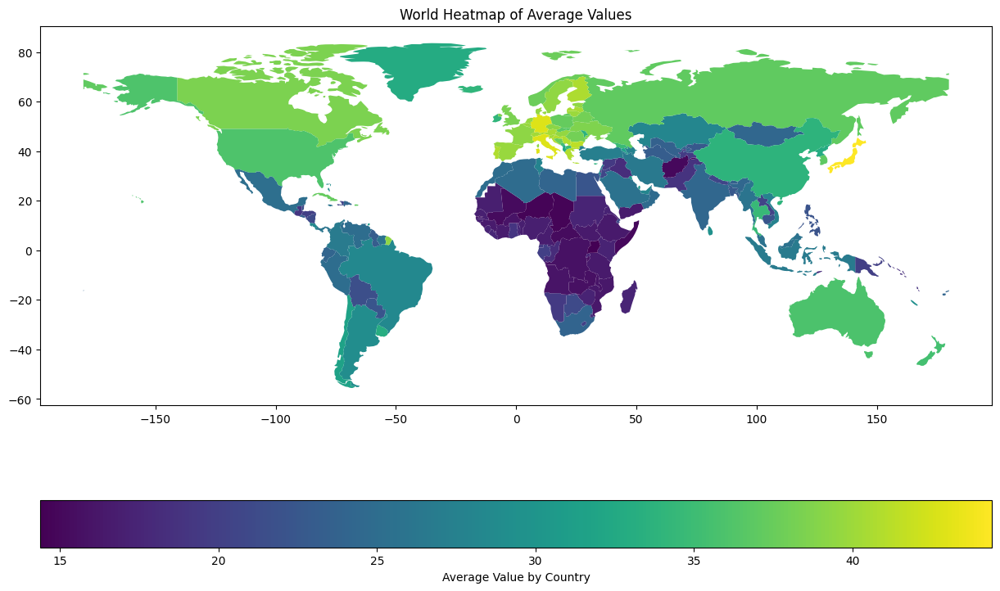

/tmp/ipykernel_23130/2692578803.py:62: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


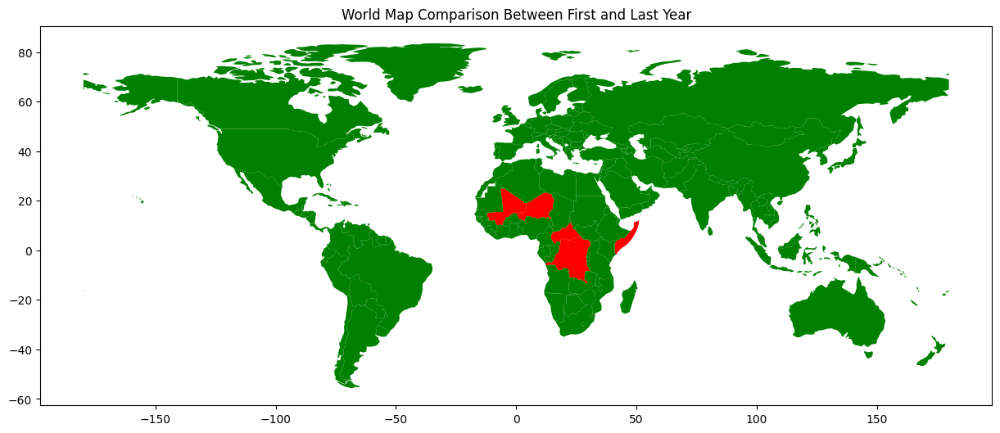

/home/dev/.local/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/tmp/ipykernel_23130/2692578803.py:96: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


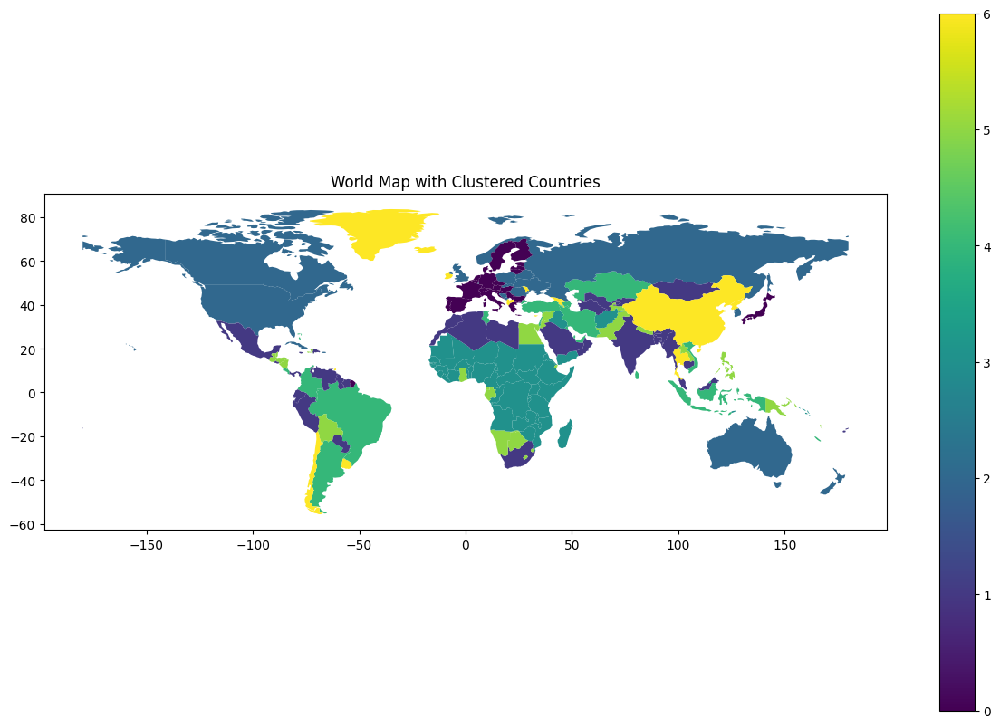

/tmp/ipykernel_23130/2692578803.py:11: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


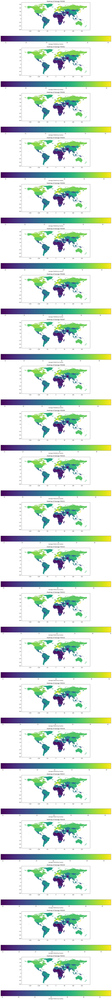

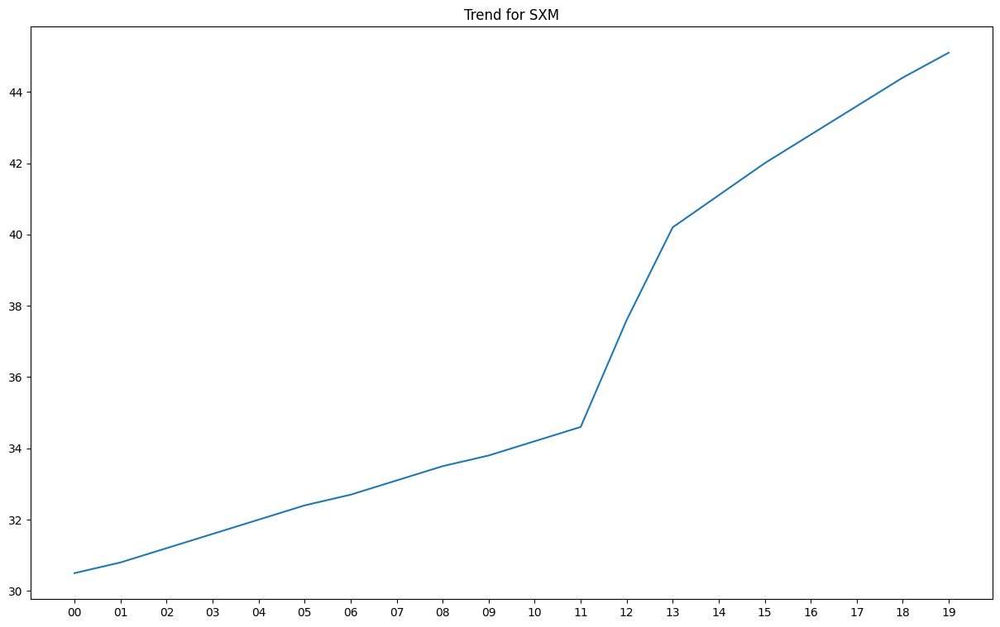

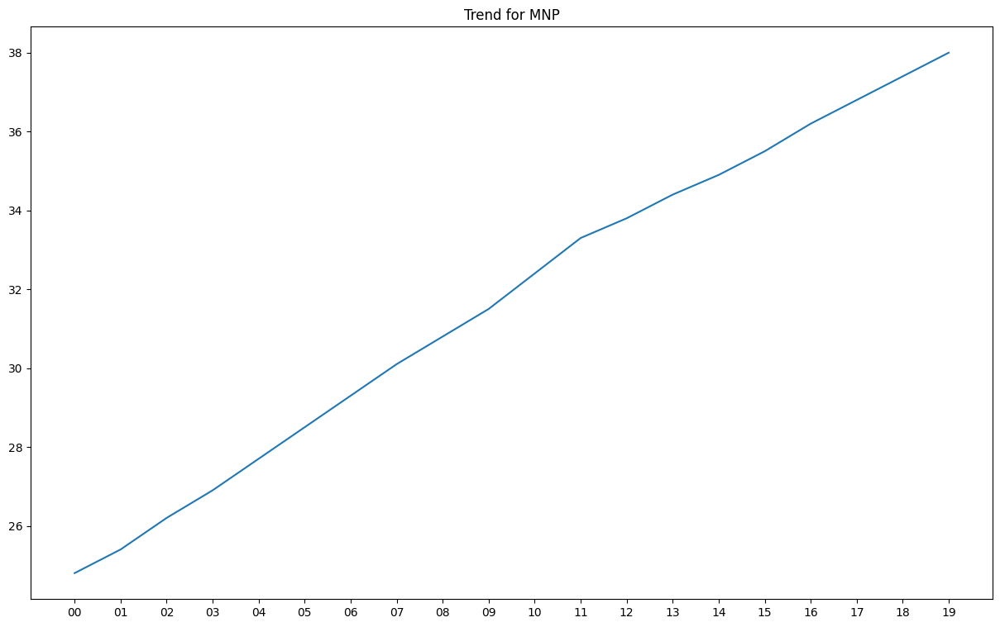

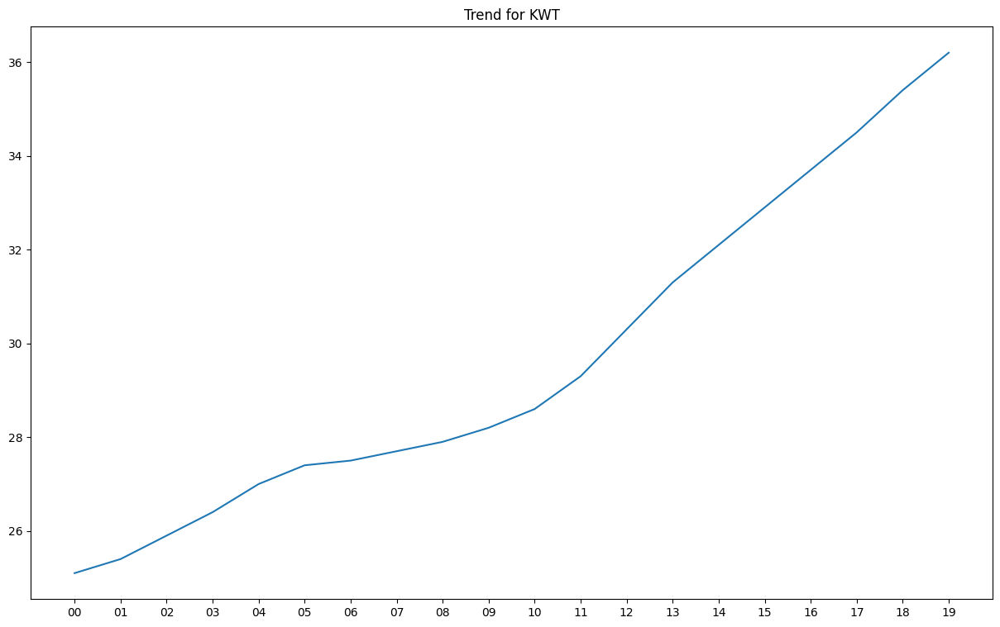

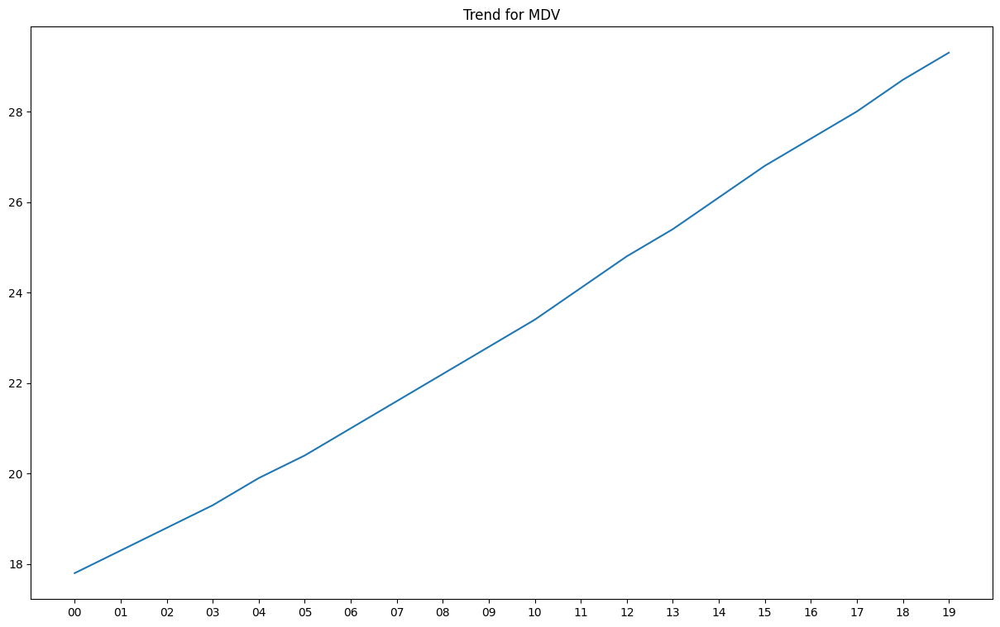

...

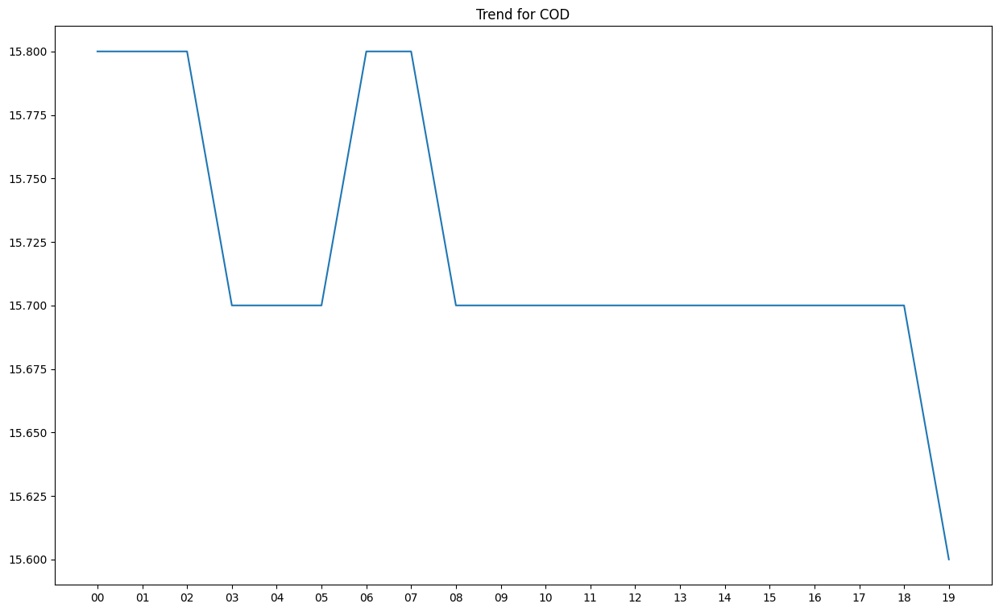

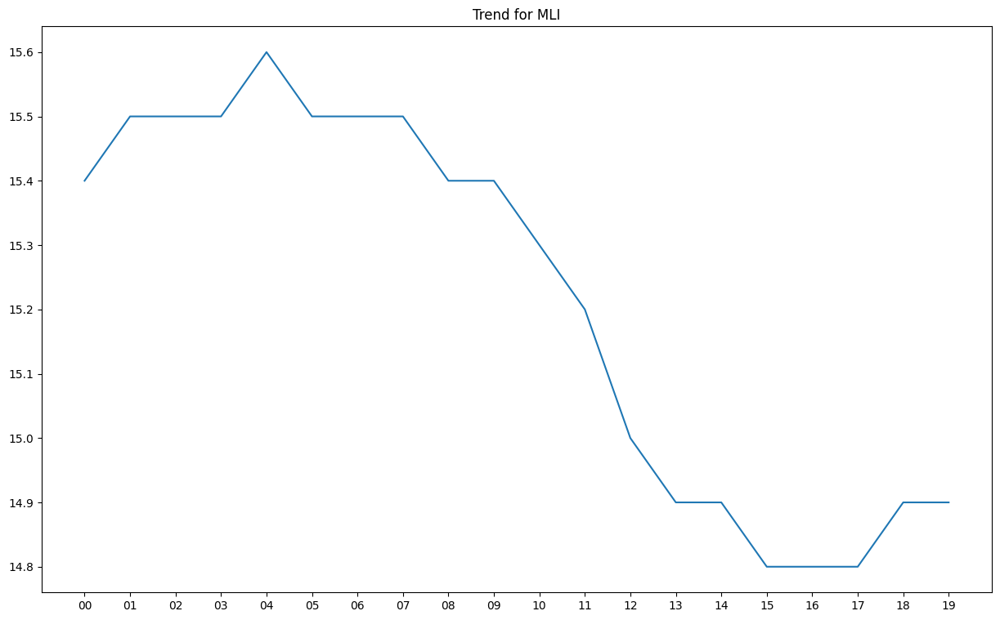

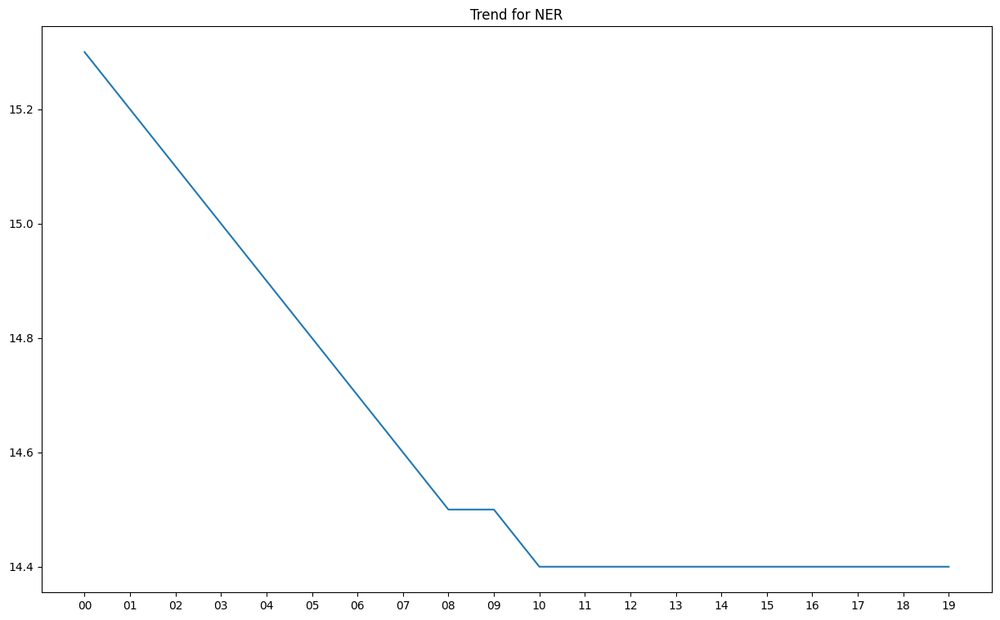

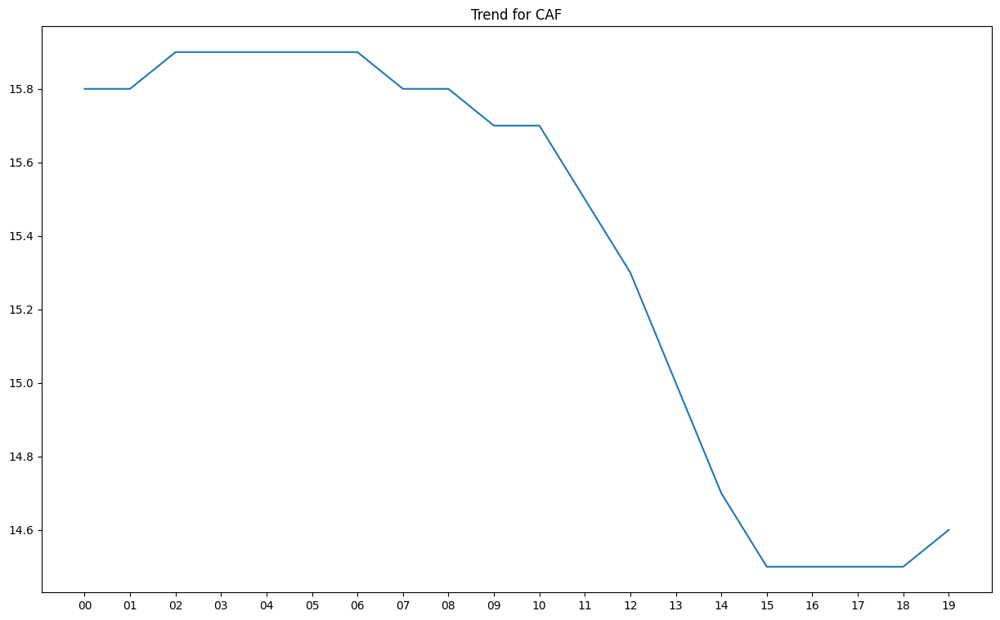

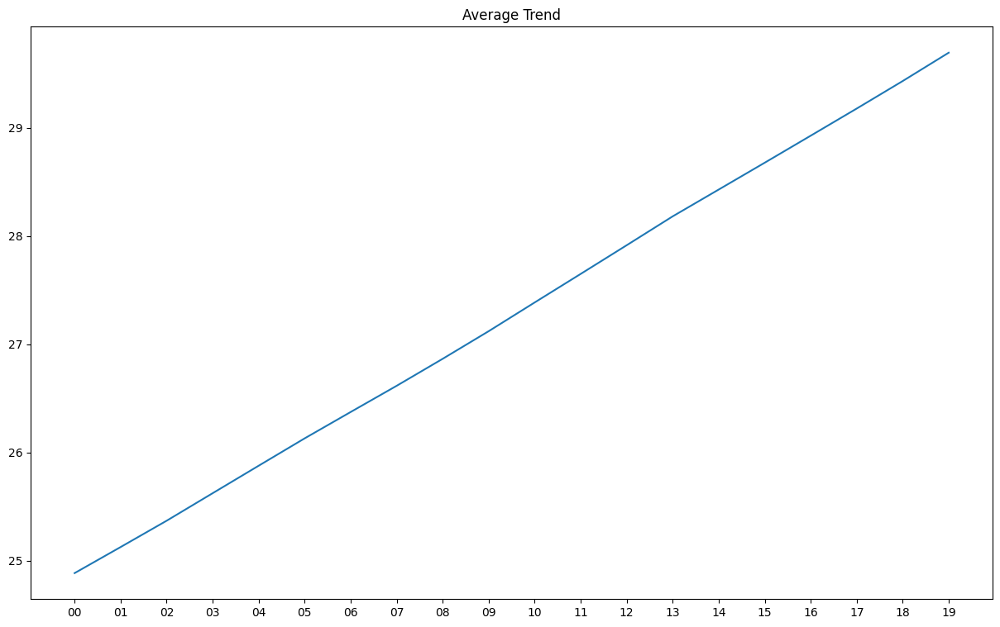

In [22]:
describe_dataset_by_country(datasets['total_median_age'])

/tmp/ipykernel_23130/2692578803.py:41: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


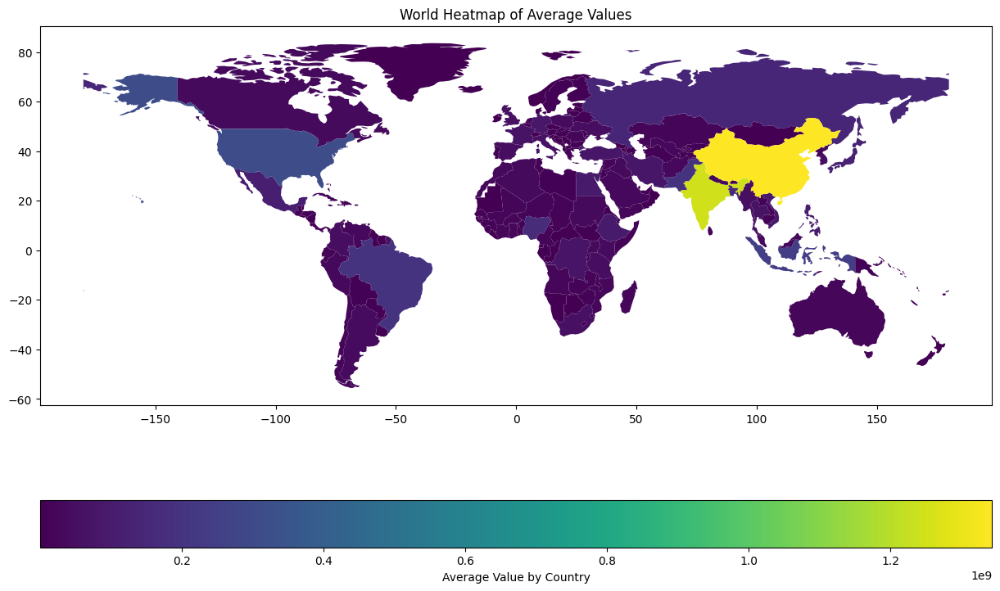

/tmp/ipykernel_23130/2692578803.py:62: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


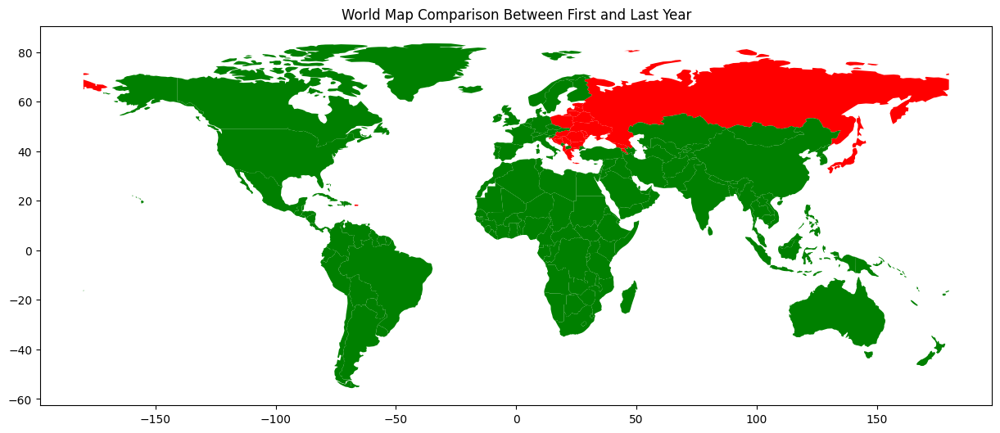

/home/dev/.local/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/tmp/ipykernel_23130/2692578803.py:96: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


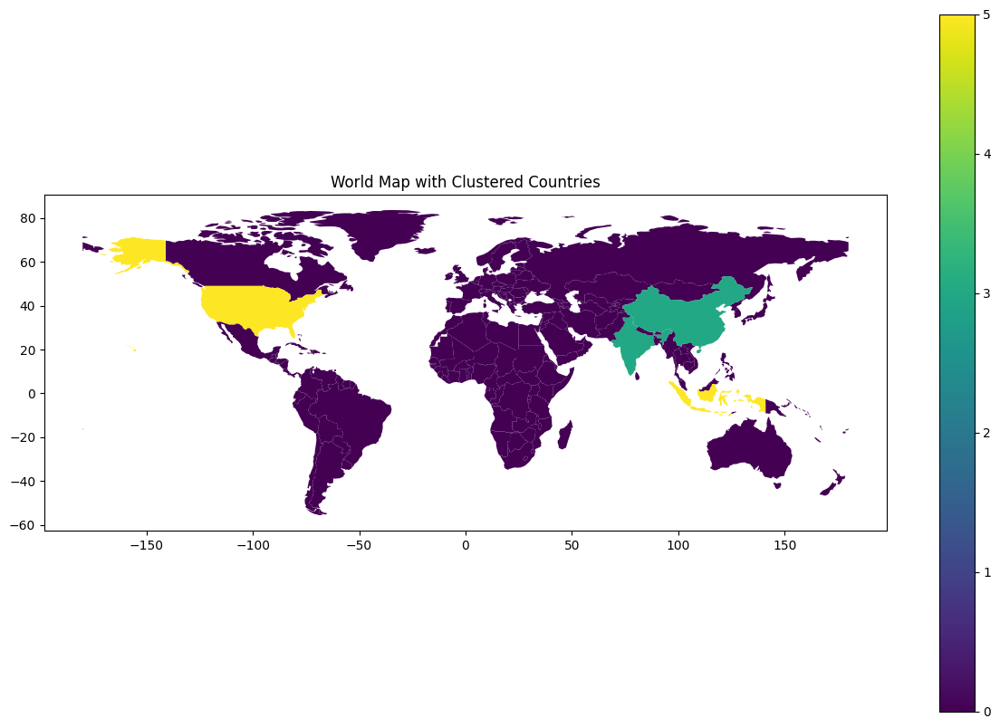

/tmp/ipykernel_23130/2692578803.py:11: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


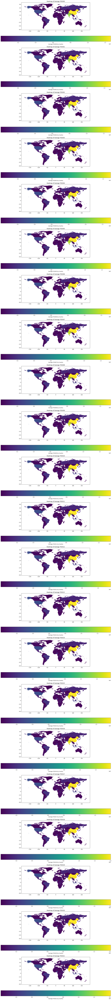

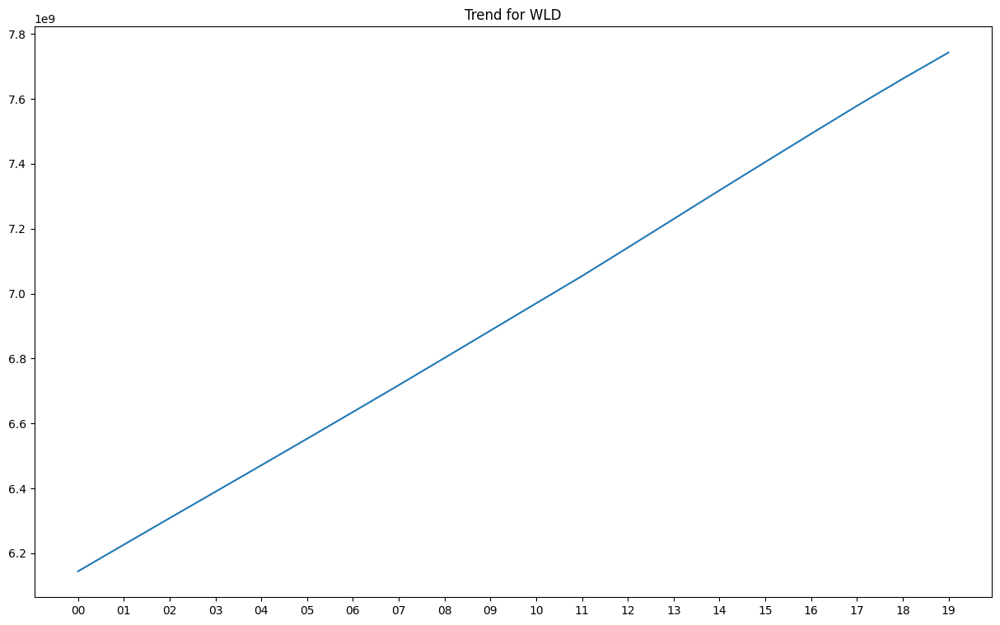

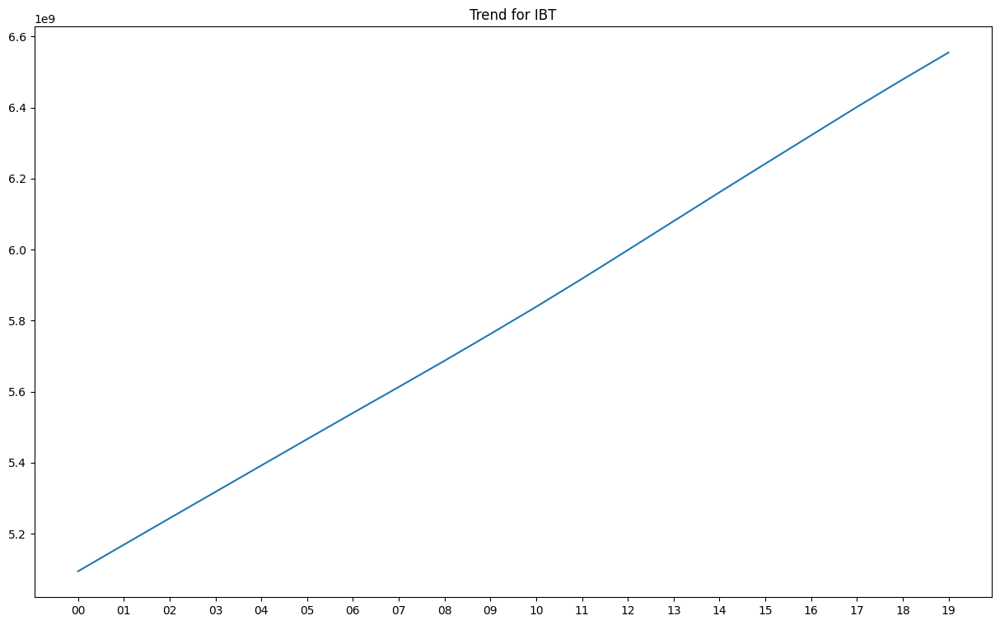

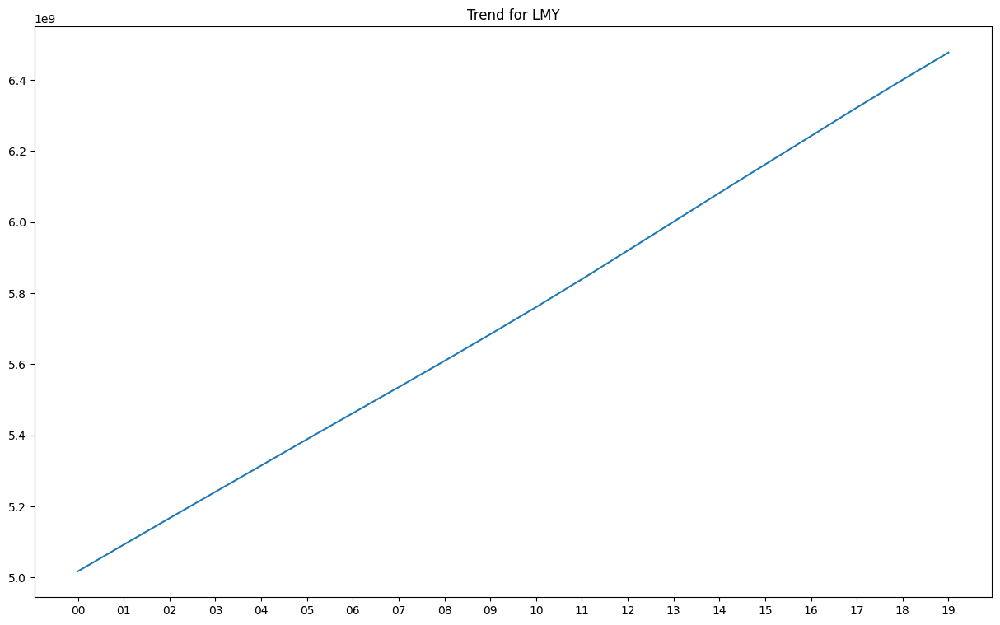

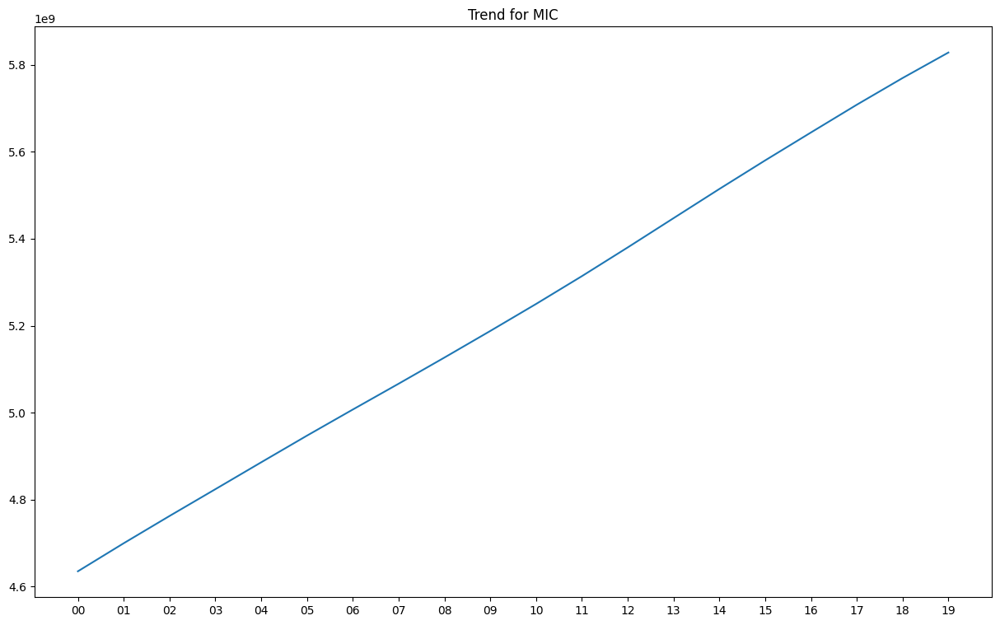

...

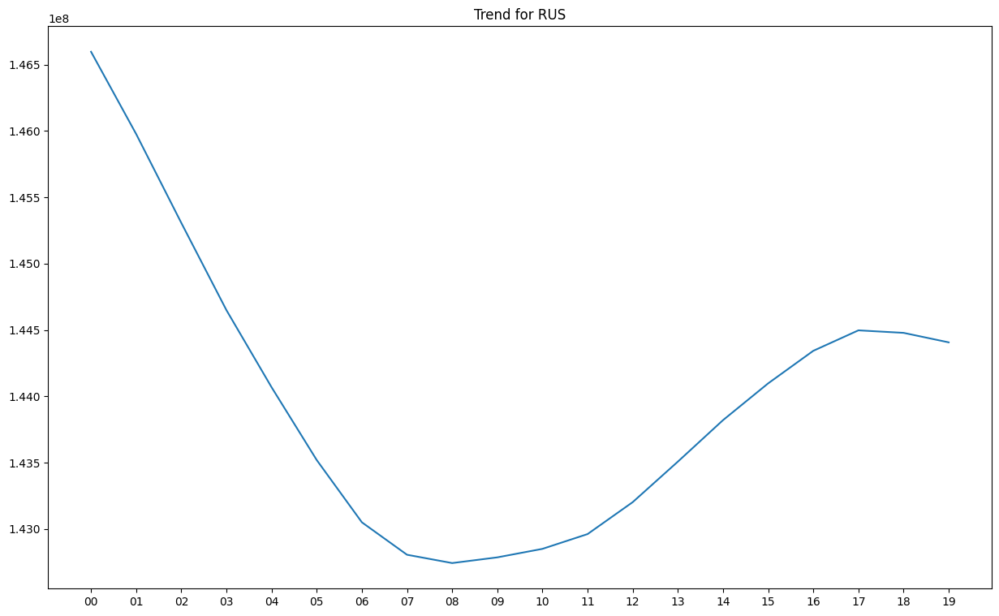

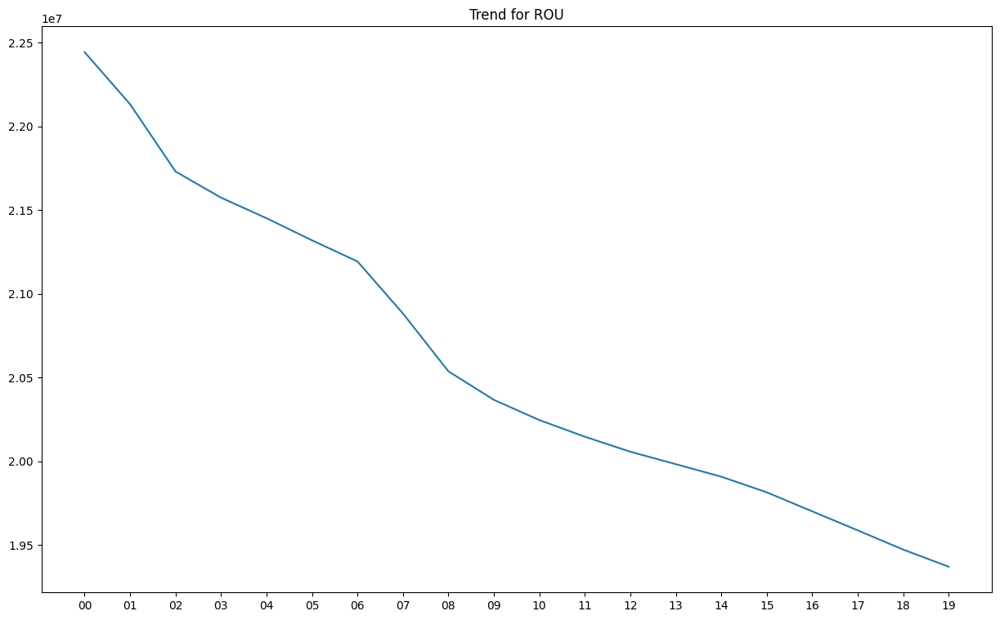

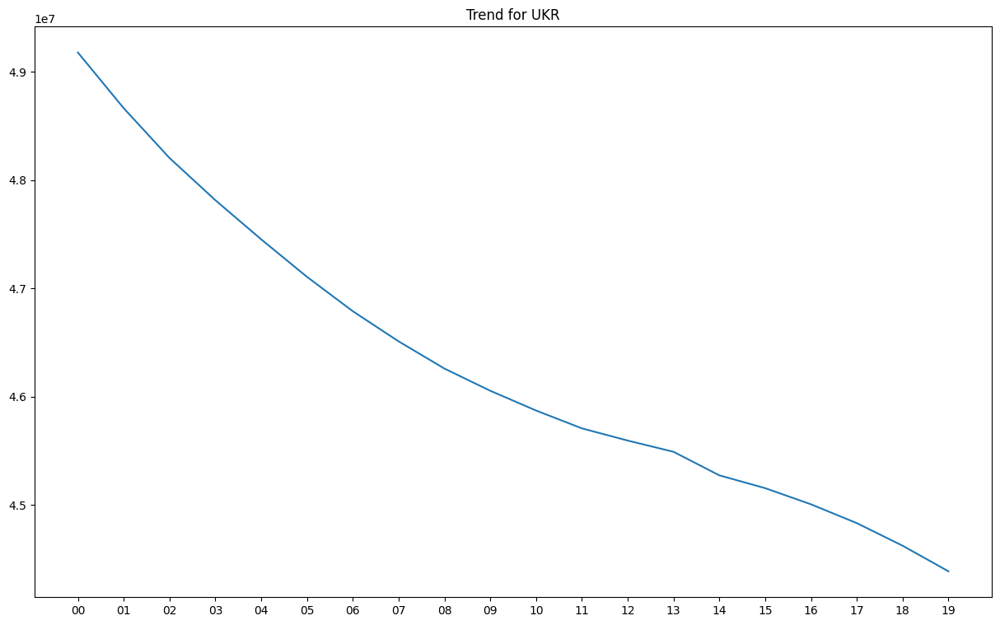

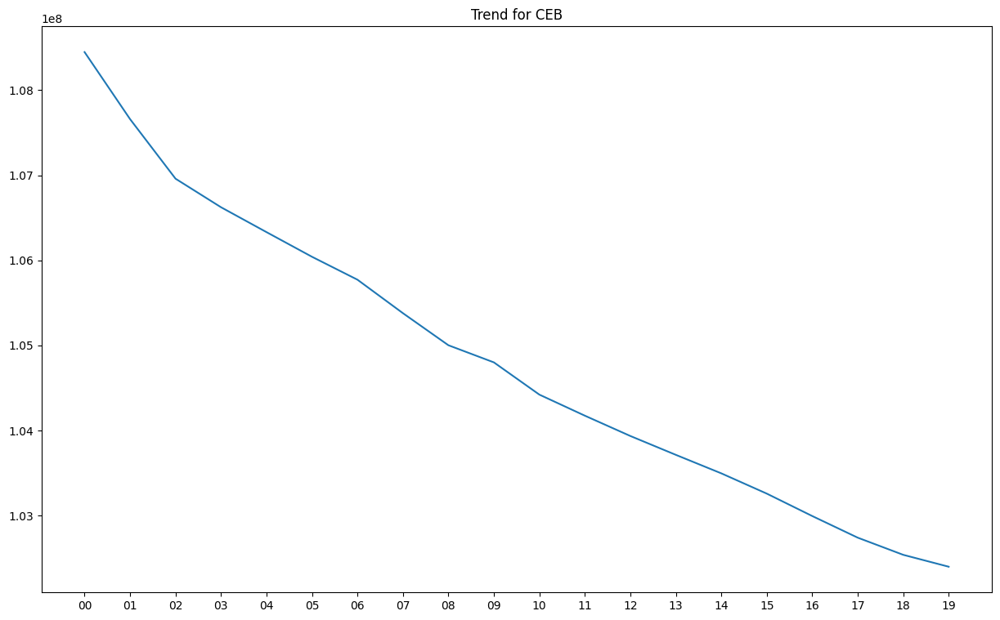

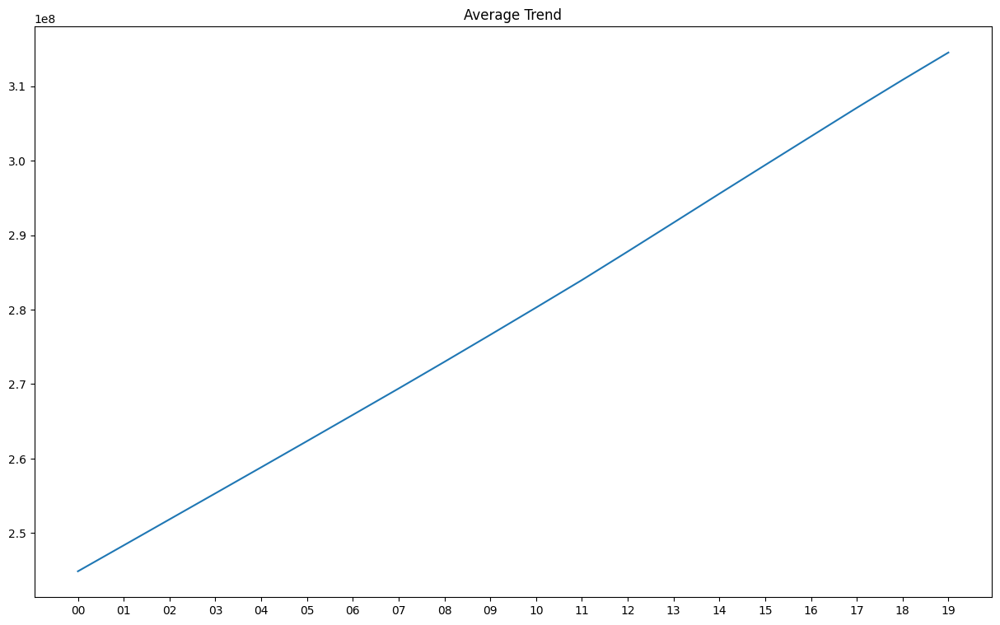

In [23]:
describe_dataset_by_country(datasets["total_population"])

/tmp/ipykernel_23130/2692578803.py:41: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


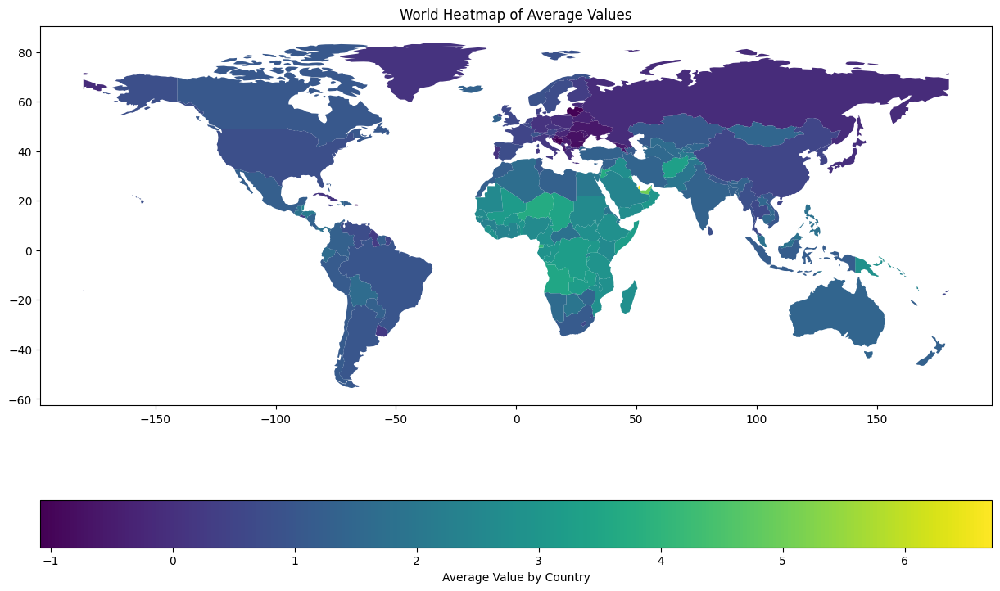

/tmp/ipykernel_23130/2692578803.py:62: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


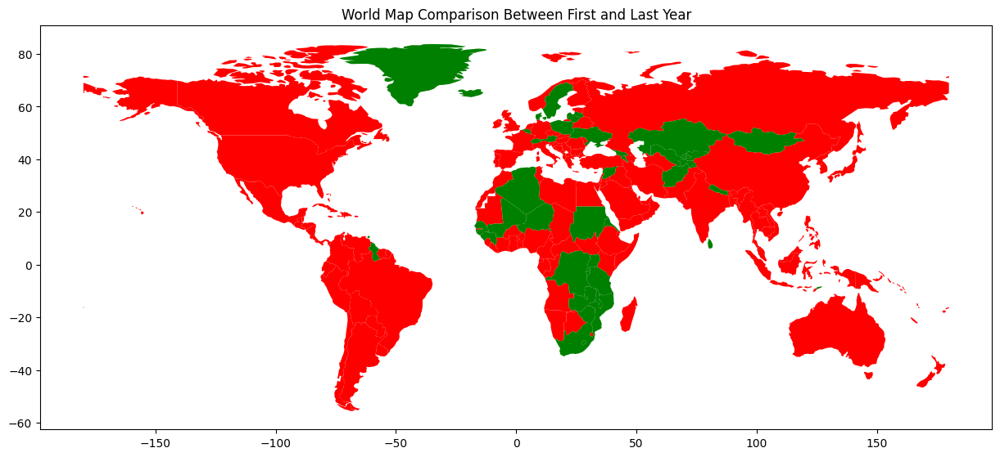

/home/dev/.local/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/tmp/ipykernel_23130/2692578803.py:96: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


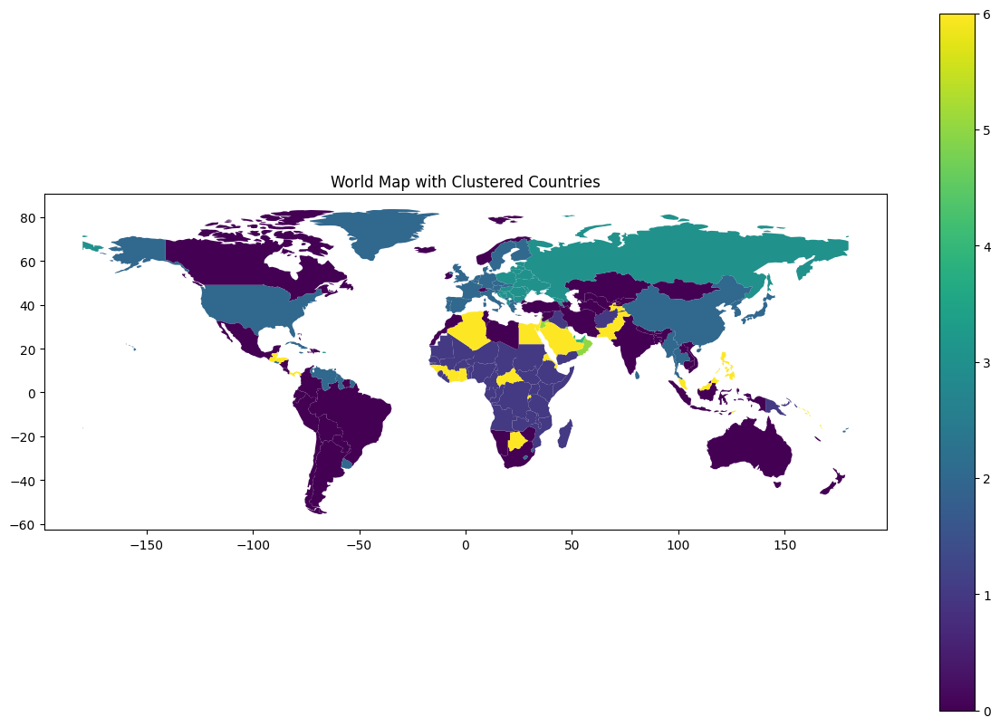

/tmp/ipykernel_23130/2692578803.py:11: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


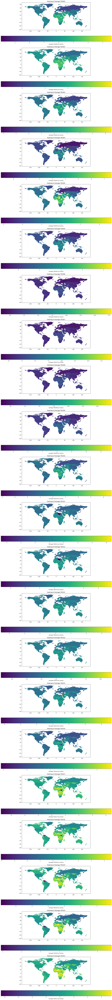

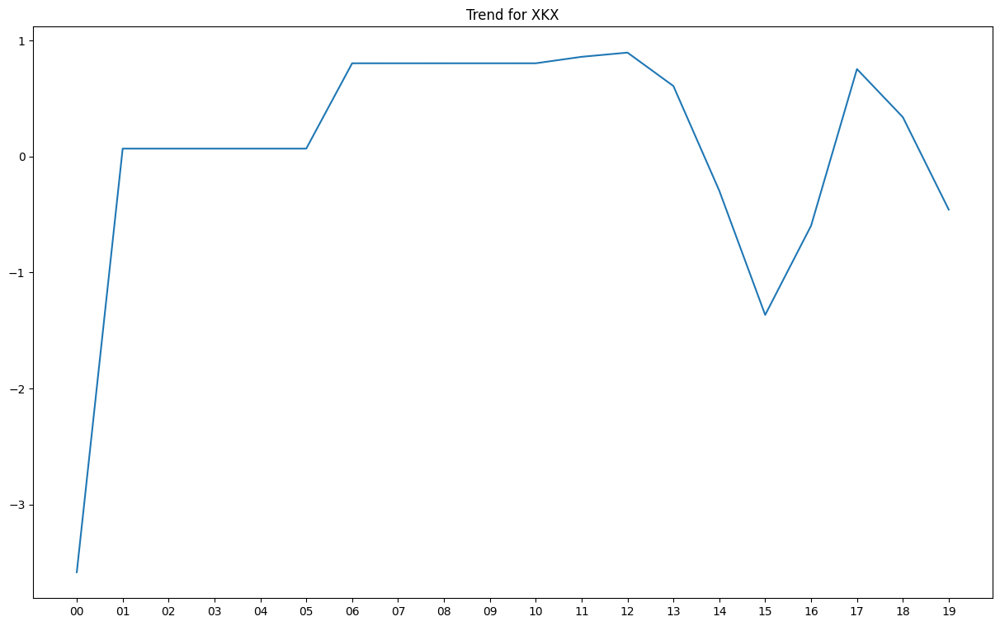

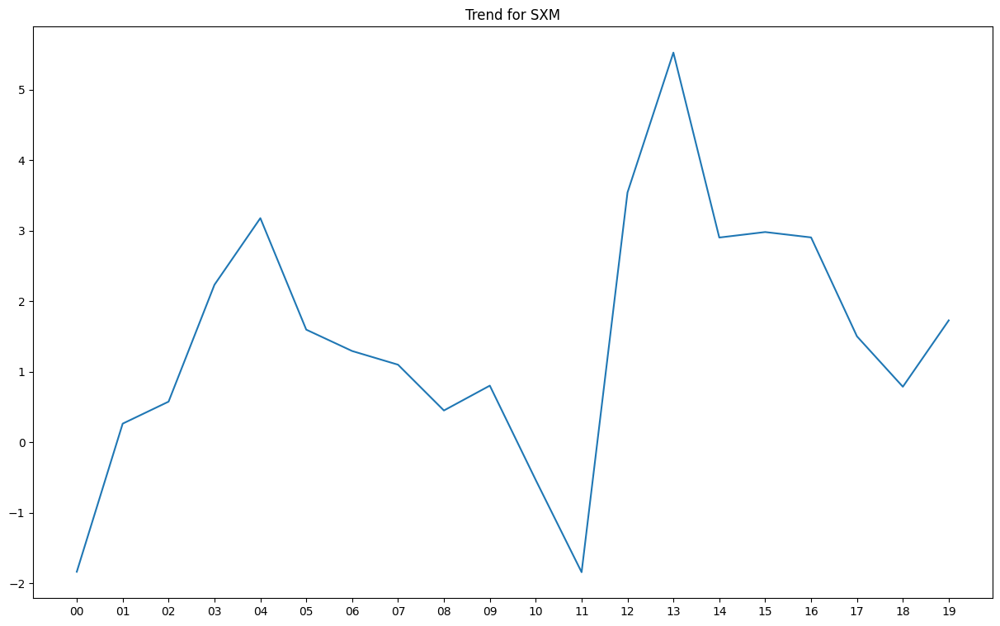

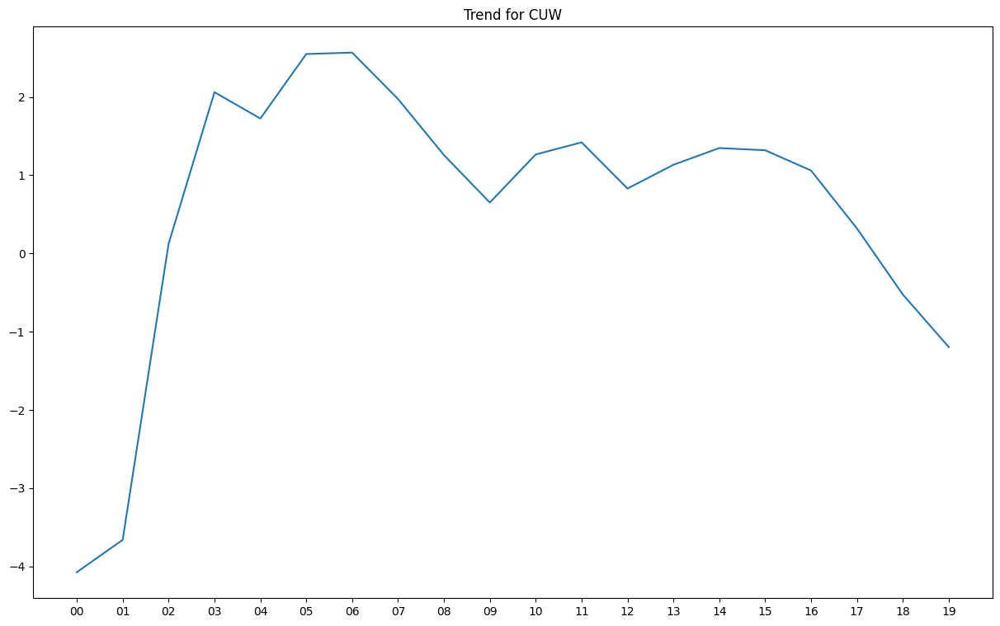

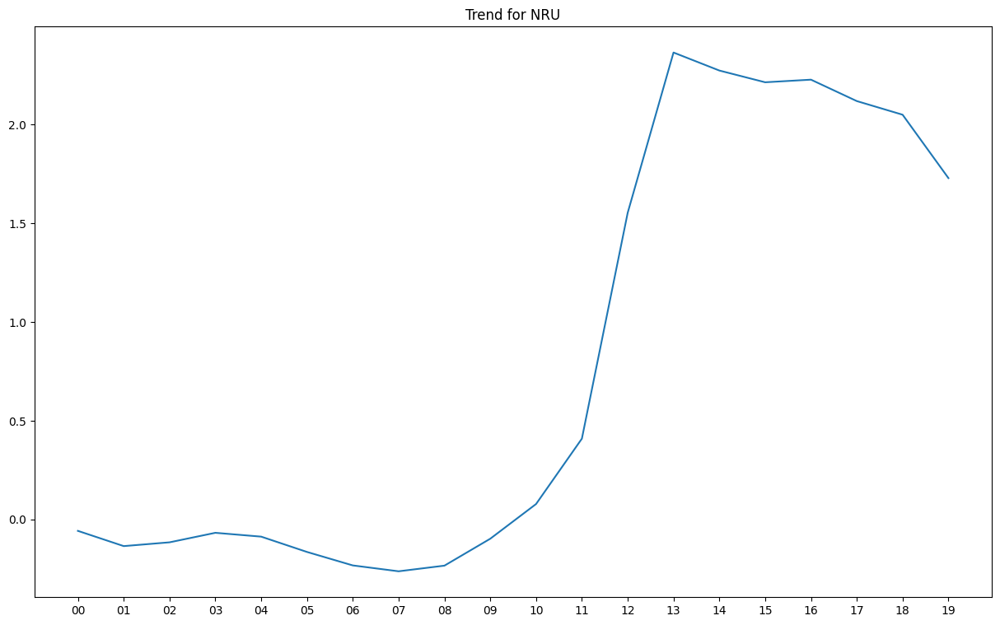

...

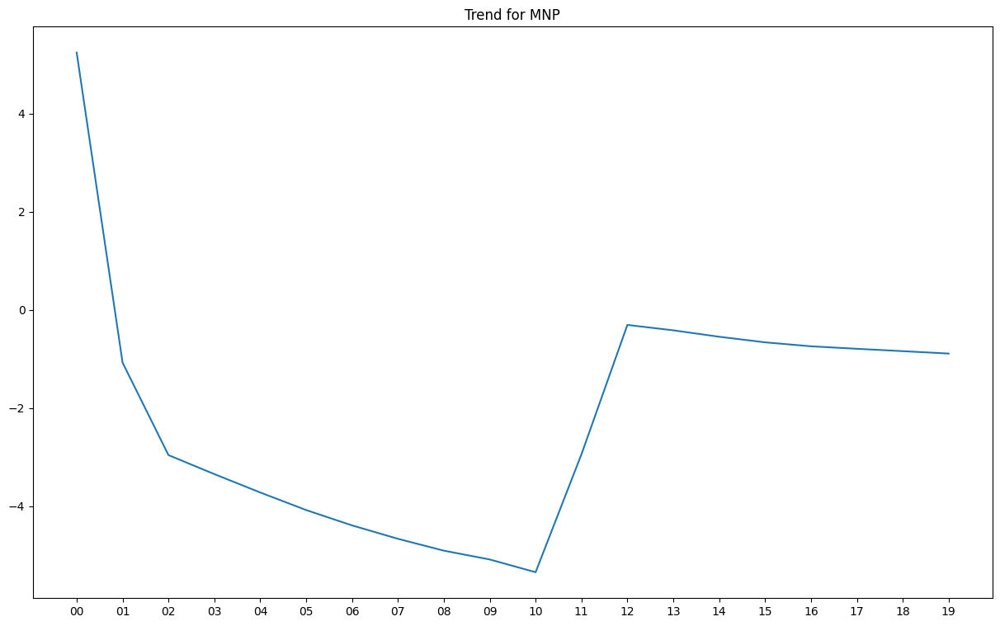

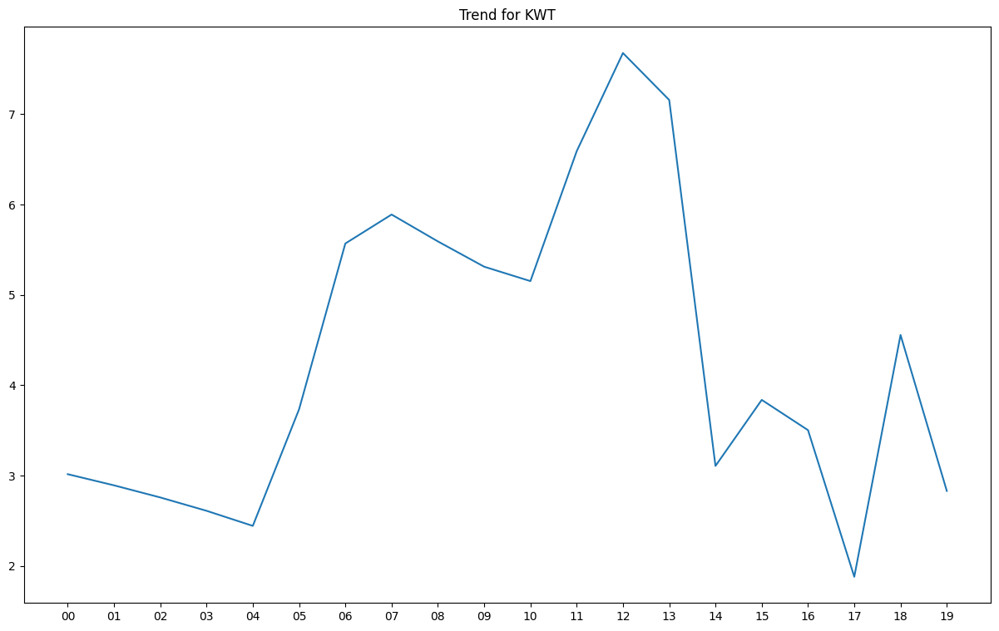

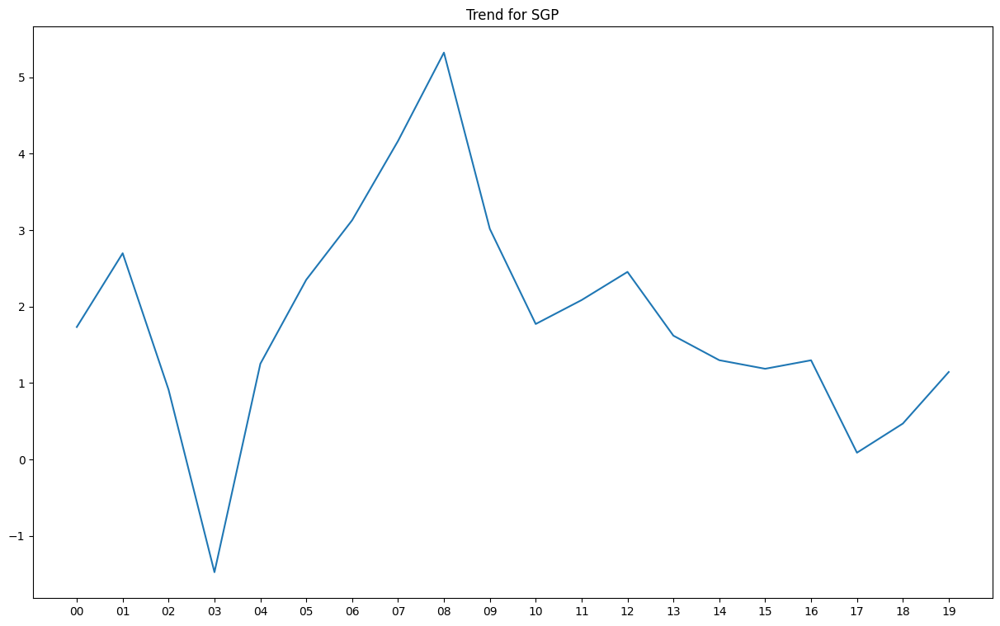

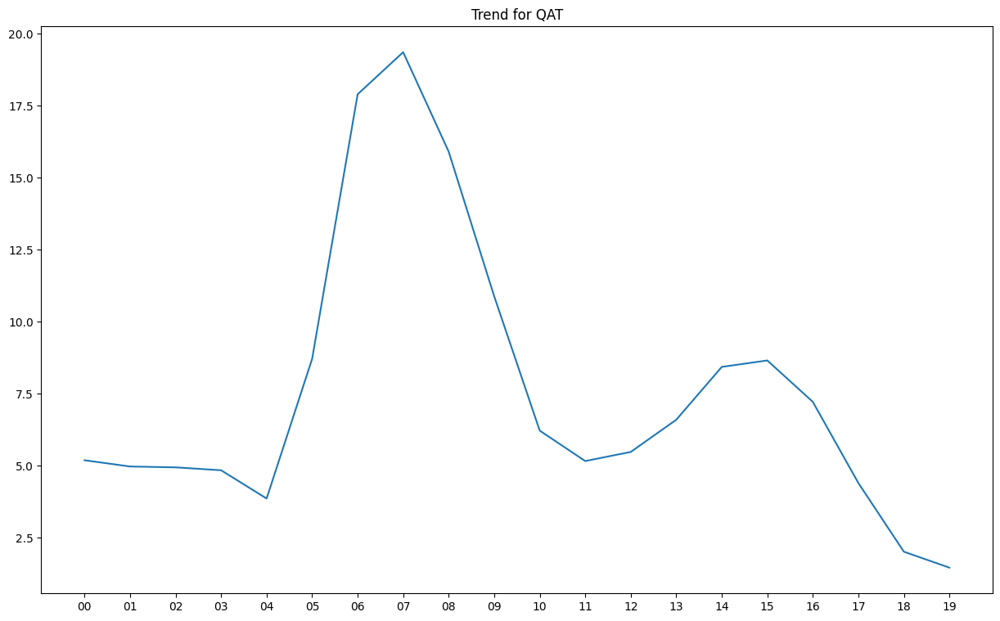

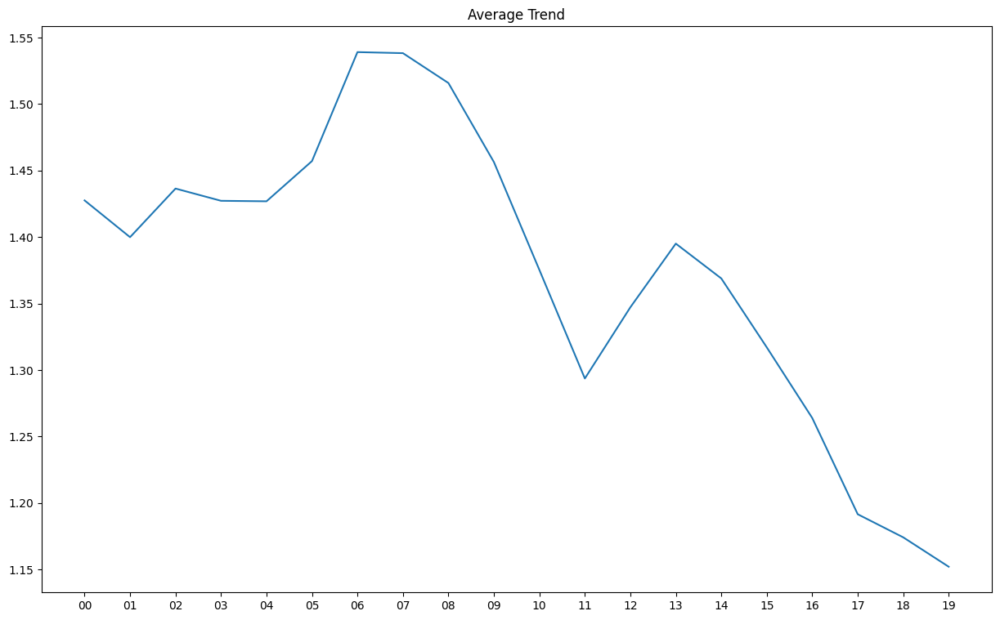

In [24]:
describe_dataset_by_country(datasets['total_population_growth'])